## BALL Composition Analysis

In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt

In [2]:
import sys
lab_path="/Users/andyzeng/Drive/Laptop/Dick_Lab/"
sys.path.append(lab_path+"AMLhierarchies/")
import Hierarchy_Tools as tk

In [3]:
sc.settings.verbosity = 1 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=150, fontsize=8, dpi_save=200, figsize=(6,4), format='png')
sc.settings.figdir = 'figures/'

In [4]:
%load_ext rpy2.ipython

## load composition data

In [5]:
dat = sc.read_csv('../BALL_89pt_Filtered_CompositionMatrix_mapQConly.csv').T
sc.pp.filter_genes(dat, min_counts=100)
dat

AnnData object with n_obs × n_vars = 89 × 55
    var: 'n_counts'

In [6]:
anno1 = pd.read_csv('../BALL_metadata_20230105.txt', delimiter='\t').set_index('TB')
dat.obs = dat.obs.join(anno1)
dat.obs

,Sample,ID,Directory,age,sex,diagnosis,subdiagnosis,location
TB-00-0805,SJHYPO146_D,SJHYPO146_D,SJHYPO146,5.42,Male,BALL,Near-haploid,Bone Marrow
TB-00-1178,SJPHALL004_D1,SJPHALL004_D,SJPHALL004_D1,15.00,Female,BALL,Ph,Bone Marrow
TB-01-0950,SJBALL006_D1,SJBALL006_D,SJBALL006_D1,10.00,Female,BALL,MEF2D,Bone Marrow
TB-03-0327,SJBALL182_D2,SJBALL182_R,SJBALL182_D2,14.30,Male,BALL,ZNF384,Bone Marrow
TB-03-1020,SJPHALL010_D1_r,SJPHALL010_D,SJPHALL010_D1,11.90,Female,BALL,Ph,Bone Marrow
...,...,...,...,...,...,...,...,...
TB-90-0922,SJHYPO117_D,SJHYPO117_D,SJHYPO117,8.93,Male,BALL,Near-haploid,Bone Marrow
TB-94-0662,SJPHALL020_D,SJPHALL020_D,SJPHALL020_D1,17.92,Male,BALL,Ph,Bone Marrow
TB-95-0372,SJPHALL020_R,SJPHALL020_R,SJPHALL020_R1,18.65,Male,BALL,Ph,Bone Marrow
TB-96-1010,SJHYPO120_D,SJHYPO120_D,SJHYPO120,10.21,Female,BALL,Low-hypodiploid,Bone Marrow


Keep Diagnosis and Subdiagnosis from Anno1 (one near-haploid converted to Ph-like)

Keep age and sex from anno2 (missing for some of anno1

In [ ]:
# anno2 = pd.read_csv('../../../../../BALLmap_deconvolution/scCohort_annotations.csv').set_index('TB-ID')
# dat.obs = dat.obs.drop(columns = {'age', 'sex'}).join(anno2.drop(columns = {'diagnosis', 'subdiagnosis'}))
# dat.obs

In [7]:
anno2 = pd.read_csv('scBALL_annotations.csv').set_index('TB-ID')
dat.obs = dat.obs.drop(columns = {'age', 'sex'}).join(anno2.drop(columns = {'diagnosis', 'subdiagnosis'}))
dat.obs

,Sample,ID,Directory,diagnosis,subdiagnosis,location,scpca_sample_id,scpca_project_id,submitter _Short,Sample ID,...,ostime (years),oscensor,Relapse,SJ_MRD_D46 (EOI),EOI MRD (pos/neg),WGS,WGS accession number,RNA,RNA-seq accession number,Unnamed: 33
TB-00-0805,SJHYPO146_D,SJHYPO146_D,SJHYPO146,BALL,Near-haploid,Bone Marrow,SCPCS000390,SCPCP000008,SJHYPO146,SJHYPO146_D,...,6.028871,1,Yes,"Positive, >0.01%",Positive >0.01%,YES,EGAS00001003975,YES,EGAS00001003266,> 0.7
TB-00-1178,SJPHALL004_D1,SJPHALL004_D,SJPHALL004_D1,BALL,Ph,Bone Marrow,SCPCS000327,SCPCP000008,SJPHALL004,SJPHALL004_D,...,18.669788,0,No,"Positive, >0.01%",Positive >0.01%,YES,EGAS00001005250,YES,EGAS00001003266,NaN
TB-01-0950,SJBALL006_D1,SJBALL006_D,SJBALL006_D1,BALL,MEF2D,Bone Marrow,SCPCS000303,SCPCP000008,SJBALL006,SJBALL006_D,...,17.363806,0,Yes,"Negative, <0.01%",Negative <0.01%,YES,.,YES,EGAS00001003266,NaN
TB-03-0327,SJBALL182_D2,SJBALL182_R,SJBALL182_D2,BALL,ZNF384,Bone Marrow,SCPCS000387,SCPCP000008,SJBALL182,SJBALL182_R,...,22.478217,0,Yes,"Negative, <0.01%","Negative, <0.01%",NO,NaN,YES,NaN,> 0.7
TB-03-1020,SJPHALL010_D1_r,SJPHALL010_D,SJPHALL010_D1,BALL,Ph,Bone Marrow,SCPCS000348,SCPCP000008,SJPHALL010,SJPHALL010_D,...,1.056832,1,Yes,"Positive, >0.01%",Positive >0.01%,YES,EGAS00001005250,YES,EGAS00001000447,> 0.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TB-90-0922,SJHYPO117_D,SJHYPO117_D,SJHYPO117,BALL,Near-haploid,Bone Marrow,SCPCS000388,SCPCP000008,SJHYPO117,SJHYPO117_D,...,1.807019,1,Yes,.,NaN,YES,EGAS00001003975,YES,EGAS00001003975,NaN
TB-94-0662,SJPHALL020_D,SJPHALL020_D,SJPHALL020_D1,BALL,Ph,Bone Marrow,SCPCS000374,SCPCP000008,SJPHALL020,SJPHALL020_D,...,1.284078,1,Yes,.,NaN,YES,EGAS00001003975,YES,EGAS00001000447,NaN
TB-95-0372,SJPHALL020_R,SJPHALL020_R,SJPHALL020_R1,BALL,Ph,Bone Marrow,SCPCS000392,SCPCP000008,SJPHALL020,SJPHALL020_R,...,1.286816,1,Yes,"Negative, <0.01%","Negative, <0.01%",YES,NaN,YES,NaN,NaN
TB-96-1010,SJHYPO120_D,SJHYPO120_D,SJHYPO120,BALL,Low-hypodiploid,Bone Marrow,SCPCS000389,SCPCP000008,SJHYPO120,SJHYPO120_D,...,23.819791,0,No,.,NaN,YES,EGAS00001005250,YES,EGAS00001004810,NaN


In [8]:
dat.obs['5yr_overall_survival'] = np.where(dat.obs['ostime (years)'] < 5, dat.obs['oscensor'], dat.obs['oscensor']*0)
dat.obs['5yr_eventfree_survival'] = np.where(dat.obs['efstime'] < 5*365.24, dat.obs['efscensor'], dat.obs['efscensor']*0)

dat.obs['AgeCategory'] = np.where(dat.obs['age'] < 1, '0 - 1 y.o.', 
                                       np.where(dat.obs['age'] < 10, '1 - 10 y.o.', 
                                                np.where(dat.obs['age'] < 15, '10 - 15 y.o.', 
                                                         np.where(dat.obs['age'] >= 15, '15 - 20 y.o.', 'NA'))))

dat.obs['MRD'] = np.where(dat.obs['SJ_MRD_D46 (EOI)'] == 'Negative, <0.01%', 'Negative', 
                              np.where(dat.obs['SJ_MRD_D46 (EOI)'] == 'Positive, >0.01%', 'Positive', 'NA'))

Annotations should all be there, and the following samples should be excluded (SJBALL021941_D1 and SJHYPO123_D)

In [ ]:
dat.obs.to_csv("scBALL_combined_annotations.csv",  index_label='Sample')

# Centered Log Ratio Normalization

In [9]:
from skbio.stats import composition

In [10]:
#dat.raw = dat
rawcounts = dat.to_df()

In [11]:
# sc.pp.normalize_per_cell(dat)

In [12]:
dat.X = composition.multiplicative_replacement(dat.X)
dat.X = composition.clr(dat.X)

In [13]:
normcounts = dat.to_df()

In [27]:
%%R -i rawcounts -i normcounts
library(tidyverse)

BALL_CellType_Abundances <- rawcounts %>% rownames_to_column('Sample') %>% pivot_longer(-Sample, names_to = 'CellType', values_to = 'count') %>% 
    group_by(Sample) %>% mutate(proportion = count / sum(count)) %>% 
    left_join(
        normcounts %>% rownames_to_column('Sample') %>% pivot_longer(-Sample, names_to = 'CellType', values_to = 'CLR_normalized')
    )
    
BALL_CellType_Abundances %>% write_csv("BALL_CellType_Composition_CountPropCLR.csv")

Joining, by = c("Sample", "CellType")


In [1261]:
dat.to_df().to_csv('BALL_CellType_Composition_CLR.csv', index_label='TB_ID')

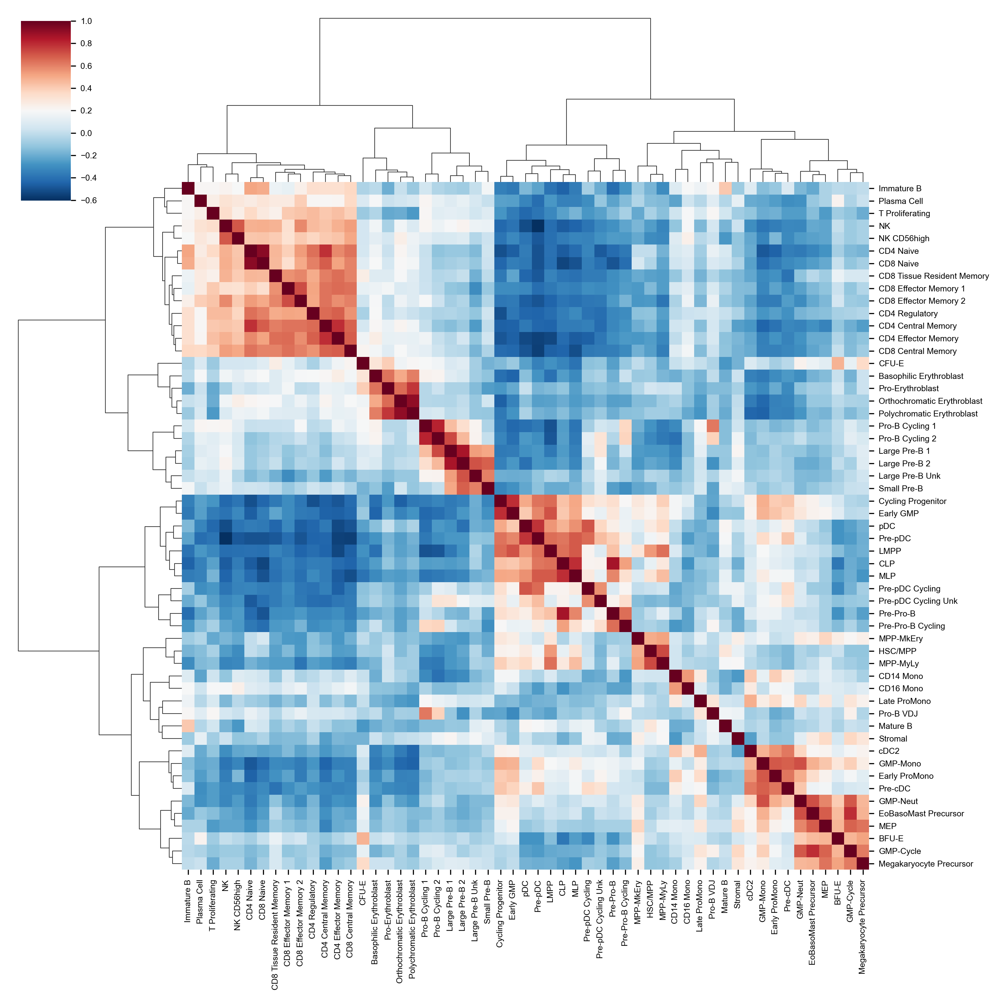

In [22]:
sc.settings.set_figure_params(dpi=150, fontsize=6, dpi_save=200, figsize=(6,4), format='png')
sns.clustermap(dat.to_df().corr(), cmap='RdBu_r', method='ward')

## Run NMF to consolidate cell types into Developmental States

In [15]:
from sklearn import metrics, decomposition

def ncomponents_NMF(adata):
    def get_score(model, data, scorer=metrics.explained_variance_score):
        prediction = model.inverse_transform(model.transform(data))
        return scorer(data, prediction)

    ks = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40]
    perform = []
    for k in ks:
        nmf = decomposition.NMF(n_components=k, max_iter=1000).fit(adata.X.T)  
        perform.append(1-get_score(nmf, adata.X.T))
    print(perform)

    plt.figure(figsize=[10, 6])
    sns.lineplot(x = ks, y = perform)
    plt.title("Unexplained Variance at K Factors (NMF)")
    plt.figure(figsize=[6, 4])


In [16]:
def do_NMF(dat, n_comp):
    adata = dat.copy()
    
    # Run NMF
    model = decomposition.NMF(n_components = n_comp, max_iter=5000)
    model.fit(adata.X.T)
    nmf_features = model.transform(adata.X.T)
    
    # Get column names
    columns=[]
    for i in range(1,n_comp+1):
        columns.append("NMF"+str(i))

    # Get NMF results
    NMF_var = pd.DataFrame(nmf_features, index=adata.var_names, columns=columns)
    NMF_obs = pd.DataFrame(np.dot(nmf_features.T, adata.X.T).T, index=adata.obs_names, columns=columns)
    # Add to object
    adata.var = adata.var.merge(NMF_var, how='left', left_index=True, right_index=True)
    adata.obs = adata.obs.merge(NMF_obs, how='left', left_index=True, right_index=True)
    
    return(adata)

/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,
/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_

[0.3526496712445838, 0.2604932203343664, 0.2192237113139025, 0.18370801618788613, 0.1577719343249825, 0.13201824001549356, 0.11604333920421661, 0.10165972855805383, 0.08913852389188248, 0.07778602402753321, 0.0707661569863628, 0.06454581133268178, 0.05916601040400438, 0.05455528813021904, 0.05025996642317687, 0.046358556947444174, 0.04299714218659256, 0.03996756198669027, 0.03678214466653362, 0.033654884229180615, 0.031253163844054965, 0.02910135729163943, 0.026236609537244826, 0.023880107478911894, 0.022281208887747095, 0.020160269418980636, 0.018681722726208716, 0.017205623768733358, 0.01572834255033151, 0.014189937076636738, 0.012869930779301764, 0.011761737425514784, 0.010819656140989009, 0.00982308117476649, 0.008675303158970249, 0.007780224571083294, 0.006857583936799028, 0.005930345677603643, 0.005164123170271706, 0.004578660320152195]


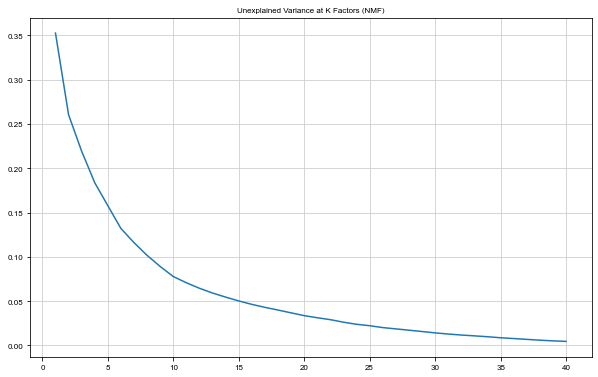

<Figure size 432x288 with 0 Axes>

In [17]:
dat_NMF = dat.copy()
dat_NMF.var = dat_NMF.var[[]]

# Shift values linearly up
dat_NMF.X = dat_NMF.X + np.abs(dat_NMF.X.min())

ncomponents_NMF(dat_NMF)

/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,


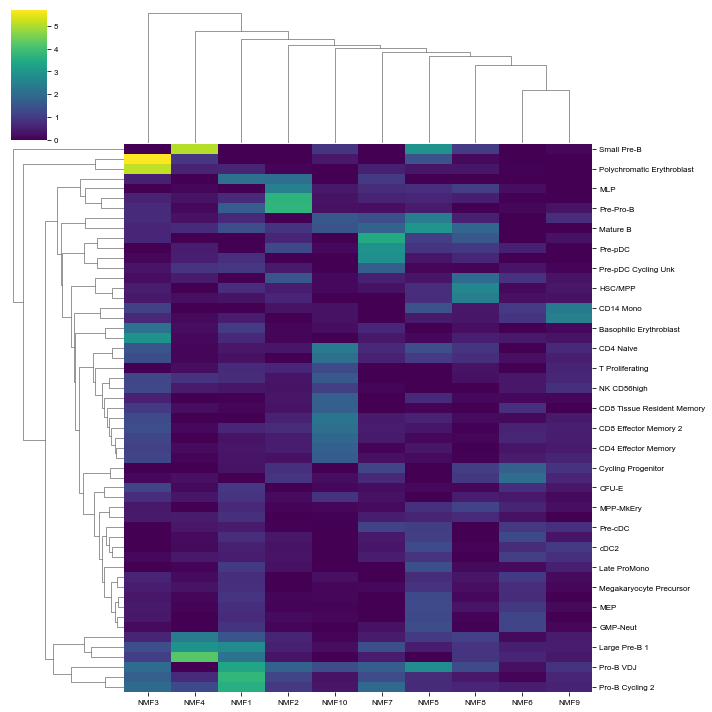

In [18]:
dat_NMF = dat.copy()
dat_NMF.var = dat_NMF.var[[]]

# Shift values linearly up
dat_NMF.X = dat_NMF.X + np.abs(dat_NMF.X.min())

# Run 
dat_NMF = do_NMF(dat_NMF, 10)
#dat.X = dat.X - 3.5
sns.clustermap(dat_NMF.var, cmap='viridis')

In [29]:
dat_NMF.var.loc[['HSC/MPP', 'MPP-MyLy', 'LMPP', 
                 'MLP', 'CLP', 'Pre-Pro-B', 
                 'Pre-pDC', 'pDC', 'Pre-pDC Cycling',
                 'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                 'Large Pre-B 1', 'Large Pre-B 2', 
                 'Small Pre-B', 'Immature B', 'Mature B', 
                 'Polychromatic Erythroblast', 'Orthochromatic Erythroblast',
                 'Cycling Progenitor', 'Early GMP', 'GMP-Mono', 'GMP-Neut', 'EoBasoMast Precursor',
                 'CD14 Mono', 'CD16 Mono',
                 'CD4 Naive', 'CD8 Naive', 'CD4 Central Memory', 'CD4 Effector Memory', 'CD4 Regulatory', 
                 'CD8 Central Memory', 'CD8 Tissue Resident Memory', 'CD8 Effector Memory 1', 'CD8 Effector Memory 2', 
                 'NK'],
                ['NMF8', 'NMF2', 'NMF7', 'NMF1', 'NMF4', 'NMF5', 'NMF3', 'NMF6', 'NMF9', 'NMF10']].style.background_gradient()

,NMF8,NMF2,NMF7,NMF1,NMF4,NMF5,NMF3,NMF6,NMF9,NMF10
HSC/MPP,2.610247,0.439839,0.255475,0.722738,0.007916,0.720635,0.439415,0.153285,0.337530,0.118458
MPP-MyLy,2.412630,0.596525,0.000000,0.268182,0.217040,0.717571,0.372041,0.224611,0.254670,0.000000
LMPP,1.965502,1.487726,0.511385,0.000000,0.411551,0.291674,0.188420,0.818356,0.276307,0.119746
MLP,1.046341,2.450544,0.711213,0.000000,0.098932,0.775728,0.000000,0.196172,0.000000,0.373858
CLP,0.488095,3.676001,0.552473,0.670047,0.271127,0.596359,0.539876,0.042593,0.000000,0.271451
Pre-Pro-B,0.022251,3.704483,0.204526,1.666242,0.133018,0.420902,0.674571,0.095509,0.283135,0.241478
Pre-pDC,0.930319,1.261928,2.874164,0.000000,0.442190,0.887224,0.000000,0.509919,0.000000,0.133011
pDC,1.545805,0.618221,3.458877,0.000000,0.000000,1.034488,0.612572,0.000000,0.245659,0.000000
Pre-pDC Cycling,0.609188,0.000000,2.823406,0.768299,0.469451,0.333002,0.091771,0.018873,0.010674,0.000000
Pro-B VDJ,1.268514,1.760699,1.682566,3.344618,0.000000,2.780544,1.959255,0.231533,0.821927,1.292241


In [32]:
mydict = {'NMF8': ['HSC/MPP', 'MPP-MyLy', 'LMPP'], 
          'NMF2': ['CLP', 'Pre-Pro-B', 'MLP'], 
          'NMF7': ['pDC', 'Pre-pDC', 'Pre-pDC Cycling'], 
          'NMF1': ['Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2'], 
          'NMF4': ['Small Pre-B', 'Large Pre-B 1', 'Large Pre-B 2'], 
          'NMF5': ['Immature B', 'Mature B'], 
          'NMF3': ['Orthochromatic Erythroblast', 'Polychromatic Erythroblast'], 
          'NMF6': ['Cycling Progenitor', 'Early GMP', 'EoBasoMast Precursor', 'GMP-Mono', 'GMP-Neut'], 
          'NMF9': ['CD14 Mono', 'CD16 Mono'], 
          'NMF10': ['CD4 Central Memory', 'CD4 Naive', 'CD8 Effector Memory 2', 'CD8 Naive', 
                    'CD8 Effector Memory 1', 'CD4 Effector Memory', 'CD4 Regulatory', 
                    'CD8 Central Memory', 'CD8 Tissue Resident Memory', 'NK']
         }

NMFvar = ['NMF8', 'NMF2', 'NMF7', 'NMF1', 'NMF4', 'NMF5', 'NMF3', 'NMF6', 'NMF9', 'NMF10']
for NMF in NMFvar:
    print(NMF)
    
    celltypes = mydict[NMF]
    print(celltypes)
    print(dat_NMF.to_df()[celltypes].sum(axis=1).corr(dat_NMF.obs[NMF]))

NMF8
['HSC/MPP', 'MPP-MyLy', 'LMPP']
0.8843105107299188
NMF2
['CLP', 'Pre-Pro-B', 'MLP']
0.9657653254819633
NMF7
['pDC', 'Pre-pDC', 'Pre-pDC Cycling']
0.9292129298248979
NMF1
['Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2']
0.8903884995300445
NMF4
['Small Pre-B', 'Large Pre-B 1', 'Large Pre-B 2']
0.9887757548223006
NMF5
['Immature B', 'Mature B']
0.6704208634106633
NMF3
['Orthochromatic Erythroblast', 'Polychromatic Erythroblast']
0.9106621419356811
NMF6
['Cycling Progenitor', 'Early GMP', 'EoBasoMast Precursor', 'GMP-Mono', 'GMP-Neut']
0.9222164838647906
NMF9
['CD14 Mono', 'CD16 Mono']
0.8942444388985478
NMF10
['CD4 Central Memory', 'CD4 Naive', 'CD8 Effector Memory 2', 'CD8 Naive', 'CD8 Effector Memory 1', 'CD4 Effector Memory', 'CD4 Regulatory', 'CD8 Central Memory', 'CD8 Tissue Resident Memory', 'NK']
0.9733520012908614


In [ ]:
%%R


NMFLineages <- data.frame('CellType' = c('HSC/MPP', 'MPP-MyLy', 'LMPP', 
                                         'CLP', 'Pre-Pro-B', 'MLP', 
                                         'pDC', 'Pre-pDC', 'Pre-pDC Cycling',
                                         'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                                         'Small Pre-B', 'Large Pre-B 1', 'Large Pre-B 2', 
                                         'Immature B', 'Mature B',
                                         'Orthochromatic Erythroblast', 'Polychromatic Erythroblast', 
                                         'Cycling Progenitor', 'Early GMP', 'EoBasoMast Precursor', 'GMP-Mono', 'GMP-Neut',
                                         'CD14 Mono', 'CD16 Mono', 
                                         'CD4 Central Memory', 'CD4 Naive', 'CD8 Effector Memory 2', 'CD8 Naive', 'CD8 Effector Memory 1', 
                                         'CD4 Effector Memory', 'CD4 Regulatory', 'CD8 Central Memory', 'CD8 Tissue Resident Memory', 'NK'), 
                          'NMF' = c('NMF8', 'NMF8', 'NMF8', 
                                    'NMF2', 'NMF2', 'NMF2', 
                                    'NMF7', 'NMF7', 'NMF7', 
                                    'NMF1', 'NMF1', 'NMF1', 
                                    'NMF4', 'NMF4', 'NMF4',
                                    'NMF5', 'NMF5',
                                    'NMF3', 'NMF3',
                                    'NMF6', 'NMF6', 'NMF6', 'NMF6', 'NMF6', 
                                    'NMF9', 'NMF9',
                                    'NMF10', 'NMF10', 'NMF10', 'NMF10', 'NMF10', 
                                    'NMF10', 'NMF10', 'NMF10', 'NMF10', 'NMF10'))

NMFLineages <- NMFLineages %>% 
    mutate(Lineage = ifelse(NMF == 'NMF8', 'HSC_MPP_LMPP',
                           ifelse(NMF == 'NMF2', 'MLP_CLP_PreProB',
                                 ifelse(NMF == 'NMF7', 'Pre_pDC',
                                       ifelse(NMF == 'NMF1', 'Pro_B',
                                             ifelse(NMF == 'NMF4', 'Pre_B',
                                                   ifelse(NMF == 'NMF5', 'Mature_B',
                                                         ifelse(NMF == 'NMF3', 'Erythroid',
                                                               ifelse(NMF == 'NMF6', 'Myeloid_Progenitor',
                                                                     ifelse(NMF == 'NMF9', 'Monocyte',
                                                                           ifelse(NMF == 'NMF10', 'T_NK', 'NA')))))))))))
    
NMFLineages %>% write_csv("NMF_CellType_Lineage_Assignments.csv")
NMFLineages

## Visualize weights

In [384]:
dat_NMF_var = dat_NMF.var

In [34]:
%%R

CellType_levels = c('HSC/MPP', 'MPP-MyLy', 'LMPP', 
                 'MLP', 'CLP', 'Pre-Pro-B', 
                 'Pre-pDC', 'pDC', 'Pre-pDC Cycling',
                 'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                 'Large Pre-B 1', 'Large Pre-B 2', 
                 'Small Pre-B', 'Immature B', 'Mature B', 
                 'Polychromatic Erythroblast', 'Orthochromatic Erythroblast',
                 'Cycling Progenitor', 'Early GMP', 'GMP-Mono', 'GMP-Neut', 'EoBasoMast Precursor',
                 'CD14 Mono', 'CD16 Mono',
                 'CD4 Naive', 'CD8 Naive', 'CD4 Central Memory', 'CD4 Effector Memory', 'CD4 Regulatory', 
                 'CD8 Central Memory', 'CD8 Tissue Resident Memory', 'CD8 Effector Memory 1', 'CD8 Effector Memory 2', 
                 'NK')
                    #'GMP-Cycle', 'BFU-E', 'CFU-E', 'Megakaryocyte Precursor', 'MPP-MEP', 'Stromal'

NMF_levels = c('NMF8', 'NMF2', 'NMF7', 'NMF1', 'NMF4', 'NMF5', 'NMF3', 'NMF6', 'NMF9', 'NMF10')

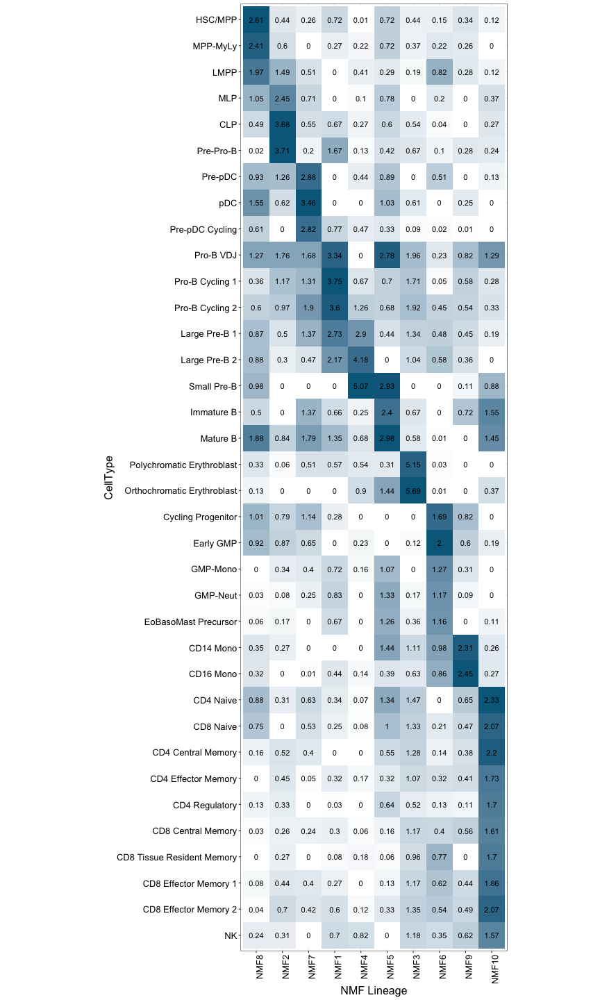

In [494]:
%%R -i dat_NMF_var --units in -h 20 -w 12

p <- dat_NMF_var %>% 
    rownames_to_column('CellType') %>% 
    pivot_longer(-CellType, names_to = 'Lineage', values_to = 'weight') %>%
    mutate(CellType = CellType %>% factor(levels = rev(CellType_levels)), 
          Lineage = Lineage %>% factor(levels = NMF_levels)) %>% 
    filter(CellType != 'NA') %>% 
    group_by(Lineage) %>%
    mutate(weight_norm = (weight - min(weight)) / (max(weight) - min(weight))) %>% 
    ungroup() %>% 
    ggplot(aes(x = Lineage, y = CellType, fill = weight_norm)) + 
    geom_tile() + theme_bw() + coord_equal() +
    scale_fill_gradient(low = 'white', high = 'deepskyblue4') +
    guides(fill=F) + # removing legend for `fill`
    geom_text(aes(label=round(weight,2)), color="black") +# printing values
    theme(axis.text.y = element_text(size = 13, color = 'black'),  axis.title = element_text(size = 16),
          axis.text.x = element_text(angle = 90, hjust = 1, size = 13, color = 'black')) + 
    xlab('NMF Lineage') + ylab('\nCellType')
    
ggsave("CompositionFigures/CompositionWeights_NMFLineage_KeyCelltypes.pdf", plot = p, device = 'pdf', height = 30, width = 13)
p 

In [412]:
%%R

CellType_levels = c('HSC/MPP', 'MPP-MyLy', 'LMPP', 
                    'Cycling Progenitor',  'Early GMP', 'GMP-Mono', 'GMP-Neut', 'EoBasoMast Precursor', 
                 'MLP', 'CLP', 'Pre-Pro-B', 
                 'Pre-pDC', 'pDC', 'Pre-pDC Cycling',
                 'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                 'Large Pre-B 1', 'Large Pre-B 2', 
                 'Small Pre-B', 'Immature B', 'Mature B'
)


NMF_levels = c('NMF8', 'NMF6', 'NMF2', 'NMF7', 'NMF1', 'NMF4')

NMF_levels_convert <- data.frame(NMF = c('NMF8', 'NMF6', 'NMF2', 'NMF7', 'NMF1', 'NMF4'), 
          Lineage = c('NMF8 - HSC/MPP/LMPP', 'NMF6 - Early Myeloid', 'NMF2 - Early Lymphoid', 'NMF7- Plasmacytoid DC', 'NMF1 - Pro-B', 'NMF4 - Pre-B'))
NMF_levels_convert

   NMF               Lineage
1 NMF8   NMF8 - HSC/MPP/LMPP
2 NMF6  NMF6 - Early Myeloid
3 NMF2 NMF2 - Early Lymphoid
4 NMF7 NMF7- Plasmacytoid DC
5 NMF1          NMF1 - Pro-B
6 NMF4          NMF4 - Pre-B


Joining, by = "NMF"


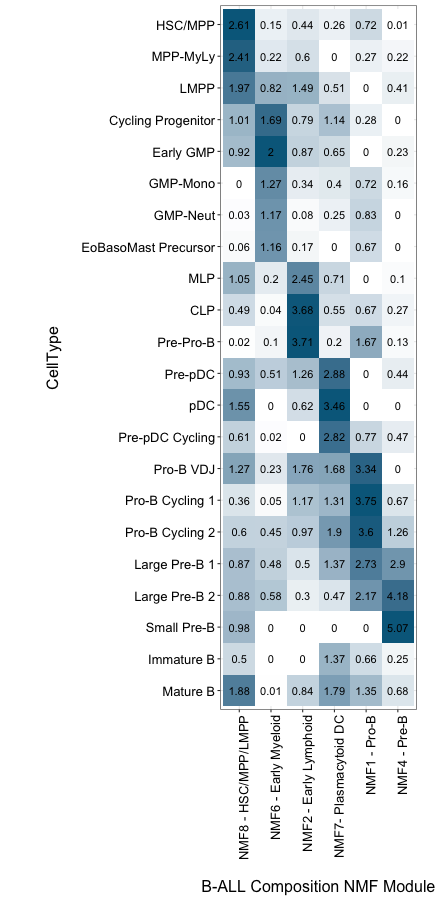

In [417]:
%%R -i dat_NMF_var --units in -h 12.5 -w 6.2

p <- dat_NMF_var %>% 
    rownames_to_column('CellType') %>% 
    pivot_longer(-CellType, names_to = 'NMF', values_to = 'weight') %>%
    left_join(NMF_levels_convert) %>% 
    mutate(CellType = CellType %>% factor(levels = rev(CellType_levels)), 
          Lineage = Lineage %>% factor(levels = NMF_levels_convert$Lineage)) %>% 
    filter(Lineage %in% NMF_levels_convert$Lineage) %>% 
    filter(CellType != 'NA') %>% 
    group_by(Lineage) %>%
    mutate(weight_norm = (weight - min(weight)) / (max(weight) - min(weight))) %>% 
    ungroup() %>% 
    ggplot(aes(x = Lineage, y = CellType, fill = weight_norm)) + 
    geom_tile() + theme_bw() + coord_equal() +
    scale_fill_gradient(low = 'white', high = 'deepskyblue4') +
    guides(fill=F) + # removing legend for `fill`
    geom_text(aes(label=round(weight,2)), color="black") +# printing values
    theme(axis.text.y = element_text(size = 13, color = 'black'),  axis.title = element_text(size = 16),
          axis.text.x = element_text(angle = 90, hjust = 1, size = 13, color = 'black')) + 
    xlab('\nB-ALL Composition NMF Module') + ylab('\nCellType\n')
    
ggsave("CompositionFigures/CompositionWeights_NMFLineage_KeyCelltypes.pdf", plot = p, device = 'pdf', height = 16, width = 8)
p 

# Composition-based Clustering

In [499]:
# dat_NMF.write_h5ad('BALL_Composition_NMF.h5ad')
# dat_NMF.obs.filter(regex='NMF').to_csv('BALL_Composition_NMFscores.csv', index_label = 'TB')

# Checkpoint

In [20]:
dat_NMF = sc.read_h5ad('BALL_Composition_NMF.h5ad')
dat_NMF

AnnData object with n_obs × n_vars = 89 × 55
    obs: 'Sample', 'ID', 'Directory', 'diagnosis', 'subdiagnosis', 'location', 'scpca_sample_id', 'scpca_project_id', 'submitter _Short', 'Sample ID', 'In BALL_sample_list', 'age', 'sex', 'tissue_location', 'disease_timing', 'white_blood_cell_count', 'blasts_percentage', 'risk_group', 'Karyotype', 'Fusion', 'In PanALL', 'Mutated genes', 'SV', 'Protocol', 'efstime', 'efscensor', 'ostime', 'ostime (years)', 'oscensor', 'Relapse', 'SJ_MRD_D46 (EOI)', 'EOI MRD (pos/neg)', 'WGS', 'WGS accession number', 'RNA', 'RNA-seq accession number', 'Unnamed: 33', '5yr_overall_survival', '5yr_eventfree_survival', 'AgeCategory', 'MRD', 'NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10'
    var: 'NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10'

In [21]:
### Excluding T/NK, Mono, and Erythroid components ('NMF10', 'NMF9', 'NMF3') 
dat_NMF_X = sc.AnnData(dat_NMF.obs[['NMF8', 'NMF2', 'NMF7', 'NMF1', 'NMF4', 'NMF5', 'NMF6']], obs=dat.obs) #'NMF6']
#sc.pp.scale(dat_NMF_X)
dat_NMF_X

/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  


AnnData object with n_obs × n_vars = 89 × 7
    obs: 'Sample', 'ID', 'Directory', 'diagnosis', 'subdiagnosis', 'location', 'scpca_sample_id', 'scpca_project_id', 'submitter _Short', 'Sample ID', 'In BALL_sample_list', 'age', 'sex', 'tissue_location', 'disease_timing', 'white_blood_cell_count', 'blasts_percentage', 'risk_group', 'Karyotype', 'Fusion', 'In PanALL', 'Mutated genes', 'SV', 'Protocol', 'efstime', 'efscensor', 'ostime', 'ostime (years)', 'oscensor', 'Relapse', 'SJ_MRD_D46 (EOI)', 'EOI MRD (pos/neg)', 'WGS', 'WGS accession number', 'RNA', 'RNA-seq accession number', 'Unnamed: 33', '5yr_overall_survival', '5yr_eventfree_survival', 'AgeCategory', 'MRD'

## BDev Clustering

In [22]:
dat = sc.read_csv('../BALL_89pt_Filtered_CompositionMatrix_mapQConly.csv').T
sc.pp.filter_genes(dat, min_counts=100)
dat

AnnData object with n_obs × n_vars = 89 × 55
    var: 'n_counts'

In [23]:
anno1 = pd.read_csv('../BALL_metadata_20230105.txt', delimiter='\t').set_index('TB')
dat.obs = dat.obs.join(anno1)
dat.obs

,Sample,ID,Directory,age,sex,diagnosis,subdiagnosis,location
TB-00-0805,SJHYPO146_D,SJHYPO146_D,SJHYPO146,5.42,Male,BALL,Near-haploid,Bone Marrow
TB-00-1178,SJPHALL004_D1,SJPHALL004_D,SJPHALL004_D1,15.00,Female,BALL,Ph,Bone Marrow
TB-01-0950,SJBALL006_D1,SJBALL006_D,SJBALL006_D1,10.00,Female,BALL,MEF2D,Bone Marrow
TB-03-0327,SJBALL182_D2,SJBALL182_R,SJBALL182_D2,14.30,Male,BALL,ZNF384,Bone Marrow
TB-03-1020,SJPHALL010_D1_r,SJPHALL010_D,SJPHALL010_D1,11.90,Female,BALL,Ph,Bone Marrow
...,...,...,...,...,...,...,...,...
TB-90-0922,SJHYPO117_D,SJHYPO117_D,SJHYPO117,8.93,Male,BALL,Near-haploid,Bone Marrow
TB-94-0662,SJPHALL020_D,SJPHALL020_D,SJPHALL020_D1,17.92,Male,BALL,Ph,Bone Marrow
TB-95-0372,SJPHALL020_R,SJPHALL020_R,SJPHALL020_R1,18.65,Male,BALL,Ph,Bone Marrow
TB-96-1010,SJHYPO120_D,SJHYPO120_D,SJHYPO120,10.21,Female,BALL,Low-hypodiploid,Bone Marrow


Keep Diagnosis and Subdiagnosis from Anno1 (one near-haploid converted to Ph-like)

Keep age and sex from anno2 (missing for some of anno1

In [24]:
# anno2 = pd.read_csv('../../../../../BALLmap_deconvolution/scCohort_annotations.csv').set_index('TB-ID')
# dat.obs = dat.obs.drop(columns = {'age', 'sex'}).join(anno2.drop(columns = {'diagnosis', 'subdiagnosis'}))
# dat.obs

In [25]:
anno2 = pd.read_csv('scBALL_annotations.csv').set_index('TB-ID')
dat.obs = dat.obs.drop(columns = {'age', 'sex'}).join(anno2.drop(columns = {'diagnosis', 'subdiagnosis'}))
dat.obs

,Sample,ID,Directory,diagnosis,subdiagnosis,location,scpca_sample_id,scpca_project_id,submitter _Short,Sample ID,...,ostime (years),oscensor,Relapse,SJ_MRD_D46 (EOI),EOI MRD (pos/neg),WGS,WGS accession number,RNA,RNA-seq accession number,Unnamed: 33
TB-00-0805,SJHYPO146_D,SJHYPO146_D,SJHYPO146,BALL,Near-haploid,Bone Marrow,SCPCS000390,SCPCP000008,SJHYPO146,SJHYPO146_D,...,6.028871,1,Yes,"Positive, >0.01%",Positive >0.01%,YES,EGAS00001003975,YES,EGAS00001003266,> 0.7
TB-00-1178,SJPHALL004_D1,SJPHALL004_D,SJPHALL004_D1,BALL,Ph,Bone Marrow,SCPCS000327,SCPCP000008,SJPHALL004,SJPHALL004_D,...,18.669788,0,No,"Positive, >0.01%",Positive >0.01%,YES,EGAS00001005250,YES,EGAS00001003266,NaN
TB-01-0950,SJBALL006_D1,SJBALL006_D,SJBALL006_D1,BALL,MEF2D,Bone Marrow,SCPCS000303,SCPCP000008,SJBALL006,SJBALL006_D,...,17.363806,0,Yes,"Negative, <0.01%",Negative <0.01%,YES,.,YES,EGAS00001003266,NaN
TB-03-0327,SJBALL182_D2,SJBALL182_R,SJBALL182_D2,BALL,ZNF384,Bone Marrow,SCPCS000387,SCPCP000008,SJBALL182,SJBALL182_R,...,22.478217,0,Yes,"Negative, <0.01%","Negative, <0.01%",NO,NaN,YES,NaN,> 0.7
TB-03-1020,SJPHALL010_D1_r,SJPHALL010_D,SJPHALL010_D1,BALL,Ph,Bone Marrow,SCPCS000348,SCPCP000008,SJPHALL010,SJPHALL010_D,...,1.056832,1,Yes,"Positive, >0.01%",Positive >0.01%,YES,EGAS00001005250,YES,EGAS00001000447,> 0.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TB-90-0922,SJHYPO117_D,SJHYPO117_D,SJHYPO117,BALL,Near-haploid,Bone Marrow,SCPCS000388,SCPCP000008,SJHYPO117,SJHYPO117_D,...,1.807019,1,Yes,.,NaN,YES,EGAS00001003975,YES,EGAS00001003975,NaN
TB-94-0662,SJPHALL020_D,SJPHALL020_D,SJPHALL020_D1,BALL,Ph,Bone Marrow,SCPCS000374,SCPCP000008,SJPHALL020,SJPHALL020_D,...,1.284078,1,Yes,.,NaN,YES,EGAS00001003975,YES,EGAS00001000447,NaN
TB-95-0372,SJPHALL020_R,SJPHALL020_R,SJPHALL020_R1,BALL,Ph,Bone Marrow,SCPCS000392,SCPCP000008,SJPHALL020,SJPHALL020_R,...,1.286816,1,Yes,"Negative, <0.01%","Negative, <0.01%",YES,NaN,YES,NaN,NaN
TB-96-1010,SJHYPO120_D,SJHYPO120_D,SJHYPO120,BALL,Low-hypodiploid,Bone Marrow,SCPCS000389,SCPCP000008,SJHYPO120,SJHYPO120_D,...,23.819791,0,No,.,NaN,YES,EGAS00001005250,YES,EGAS00001004810,NaN


In [26]:
dat.obs['5yr_overall_survival'] = np.where(dat.obs['ostime (years)'] < 5, dat.obs['oscensor'], dat.obs['oscensor']*0)
dat.obs['5yr_eventfree_survival'] = np.where(dat.obs['efstime'] < 5*365.24, dat.obs['efscensor'], dat.obs['efscensor']*0)

dat.obs['AgeCategory'] = np.where(dat.obs['age'] < 1, '0 - 1 y.o.', 
                                       np.where(dat.obs['age'] < 10, '1 - 10 y.o.', 
                                                np.where(dat.obs['age'] < 15, '10 - 15 y.o.', 
                                                         np.where(dat.obs['age'] >= 15, '15 - 20 y.o.', 'NA'))))

dat.obs['MRD'] = np.where(dat.obs['SJ_MRD_D46 (EOI)'] == 'Negative, <0.01%', 'Negative', 
                              np.where(dat.obs['SJ_MRD_D46 (EOI)'] == 'Positive, >0.01%', 'Positive', 'NA'))

### Subset BDev Populations

In [27]:
BDev_populations = ['HSC/MPP', 'MPP-MyLy', 'LMPP', 'Pre-pDC', 'pDC', 'Pre-pDC Cycling', 'Pre-pDC Cycling Unk',
                    'MLP', 'CLP', 'Pre-Pro-B', 'Pre-Pro-B Cycling', 'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                    'Large Pre-B 1', 'Large Pre-B 2', 'Large Pre-B Unk', 'Small Pre-B', 'Immature B', 'Mature B', 
                    'Early GMP']

In [28]:
dat = dat[:,BDev_populations]
dat

View of AnnData object with n_obs × n_vars = 89 × 21
    obs: 'Sample', 'ID', 'Directory', 'diagnosis', 'subdiagnosis', 'location', 'scpca_sample_id', 'scpca_project_id', 'submitter _Short', 'Sample ID', 'In BALL_sample_list', 'age', 'sex', 'tissue_location', 'disease_timing', 'white_blood_cell_count', 'blasts_percentage', 'risk_group', 'Karyotype', 'Fusion', 'In PanALL', 'Mutated genes', 'SV', 'Protocol', 'efstime', 'efscensor', 'ostime', 'ostime (years)', 'oscensor', 'Relapse', 'SJ_MRD_D46 (EOI)', 'EOI MRD (pos/neg)', 'WGS', 'WGS accession number', 'RNA', 'RNA-seq accession number', 'Unnamed: 33', '5yr_overall_survival', '5yr_eventfree_survival', 'AgeCategory', 'MRD'
    var: 'n_counts'

# Centered Log Ratio Normalization

In [29]:
from skbio.stats import composition

In [30]:
#dat.raw = dat
rawcounts = dat.to_df()

In [31]:
# sc.pp.normalize_per_cell(dat)

In [32]:
dat.X = composition.multiplicative_replacement(dat.X)
dat.X = composition.clr(dat.X)

In [33]:
sc.settings.set_figure_params(dpi=150, fontsize=6, dpi_save=200, figsize=(6,4), format='png')


In [34]:
from scipy.cluster.hierarchy import dendrogram, linkage

/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/ipykernel_launcher.py:3: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  This is separate from the ipykernel package so we can avoid doing imports until


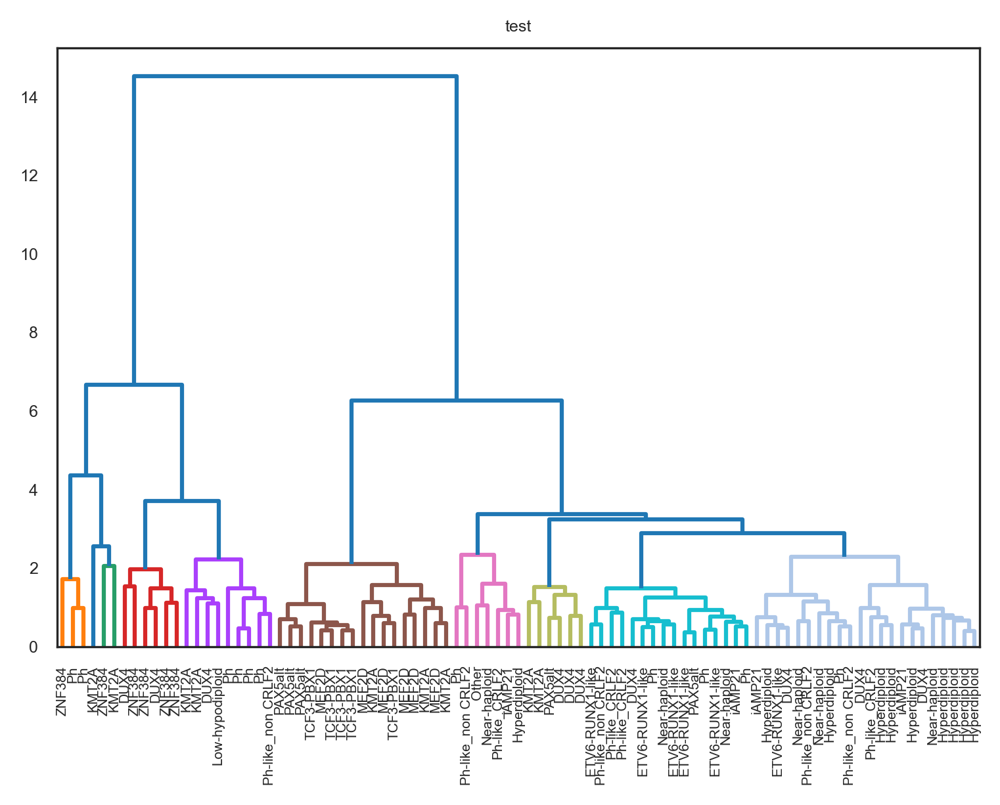

In [35]:
dists = 1 - abs(dat.to_df().T.corr())
sns.set_style('white')
linkage_matrix = linkage(dists, "ward")
dend = dendrogram(linkage_matrix, labels=dat.obs['subdiagnosis'], color_threshold = 2.5, count_sort='ascending')
plt.title("test")
plt.show()

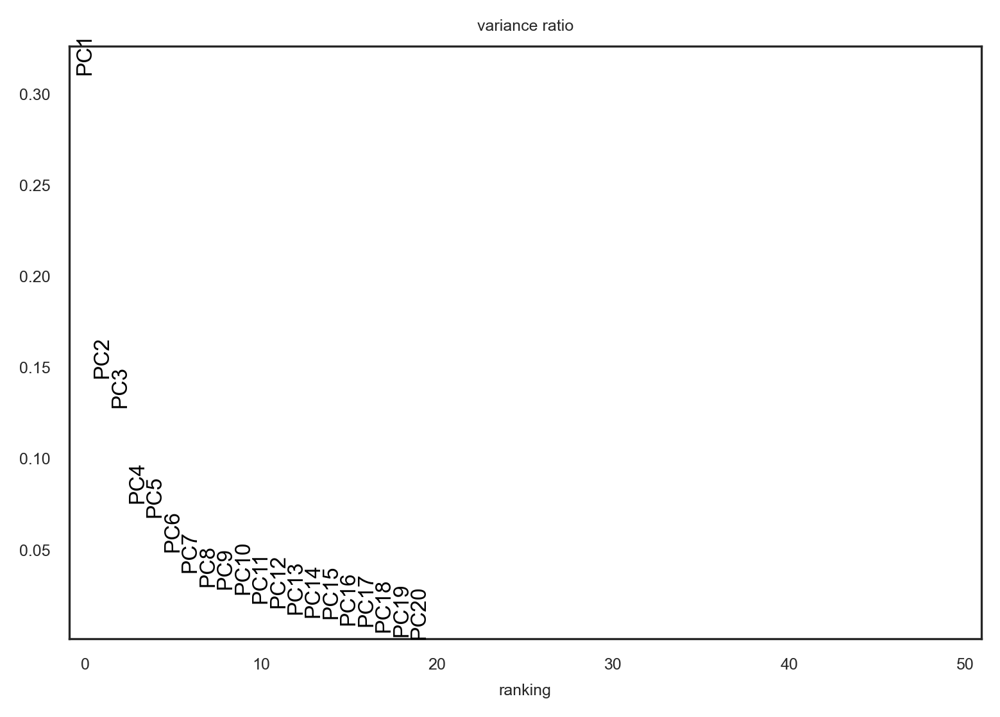

In [36]:
sc.pp.pca(dat)
sc.pl.pca_variance_ratio(dat, n_pcs=50) #n_pcs=10, 


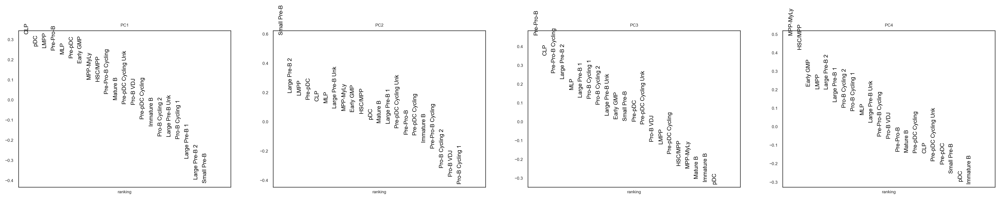

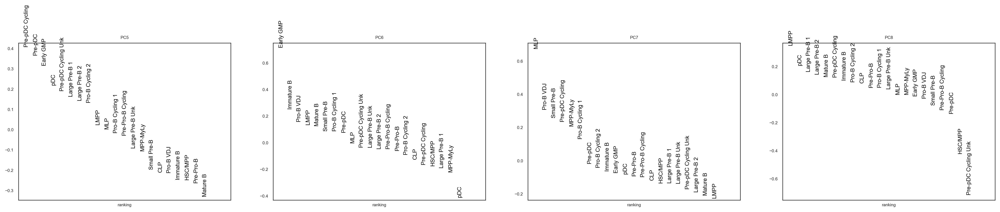

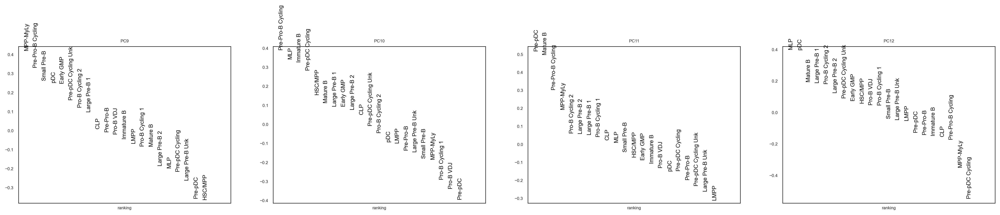

In [37]:
sc.pl.pca_loadings(dat, components=[1,2,3,4]) 
sc.pl.pca_loadings(dat, components=[5,6,7,8]) 
sc.pl.pca_loadings(dat, components=[9,10,11,12]) 



In [38]:
sc.pp.neighbors(dat, n_neighbors=10, n_pcs=6, use_rep = 'X_pca', metric = 'cosine') #n_pcs=10, 
sc.tl.umap(dat, min_dist=0.2)
sc.tl.leiden(dat, resolution=1.2)

In [39]:
dat.obsm['X_umap_custom'] = dat.obsm['X_umap'].copy()
# adjust custom umap coordinates
dat.obsm['X_umap_custom'][:,0] = dat.obsm['X_umap'][:,1]
dat.obsm['X_umap_custom'][:,1] = -dat.obsm['X_umap'][:,0]

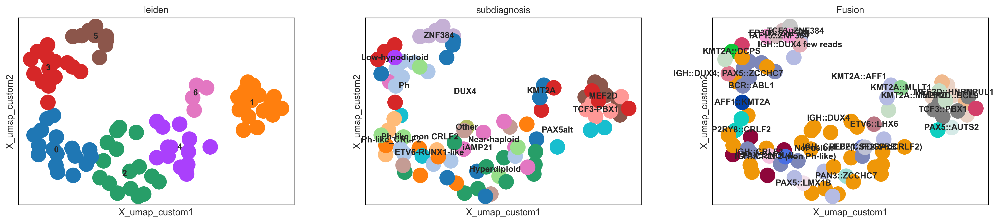

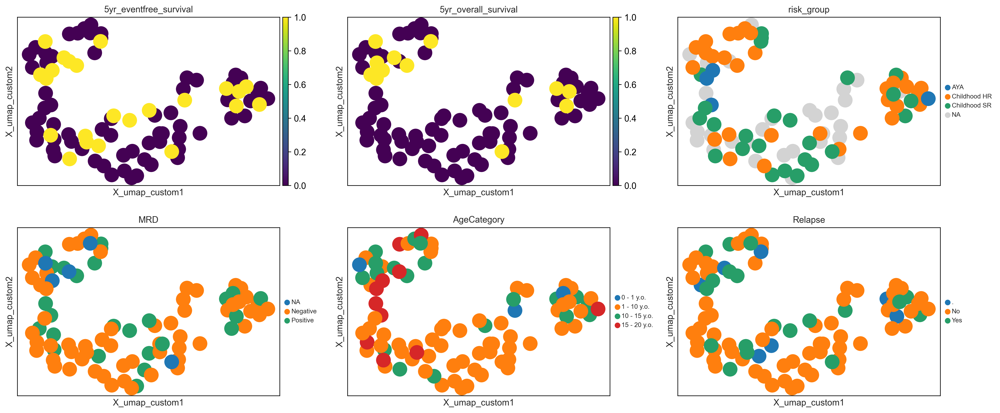

In [81]:
#sc.settings.set_figure_params(dpi=150, fontsize=8, dpi_save=200, figsize=(6,4), format='png')

sc.pl.embedding(dat, basis = 'X_umap_custom', color=['leiden', 'subdiagnosis', 'Fusion'], legend_loc = 'on data', legend_fontsize=10, ncols=3, cmap='viridis')
sc.pl.embedding(dat, basis = 'X_umap_custom', color=['5yr_eventfree_survival', '5yr_overall_survival', 'risk_group', 
                                                         'MRD', 'AgeCategory', 'Relapse'], legend_fontsize=8, ncols=3, cmap='viridis')

In [44]:
dat.uns['leiden_colors']

['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2']

In [45]:
dat.var_names[~dat.var_names.isin(['HSC/MPP', 'MPP-MyLy', 'LMPP',
                                                   'Early GMP', 'Pre-pDC', 'pDC',
                                                   'MLP', 'CLP', 'Pre-Pro-B', 
                                                   'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                                                   'Large Pre-B 1', 'Large Pre-B 2', 'Small Pre-B',
                                                   'Large Pre-B Unk', 'Immature B', 'Mature B'])]

Index(['Pre-pDC Cycling', 'Pre-pDC Cycling Unk', 'Pre-Pro-B Cycling'], dtype='object')

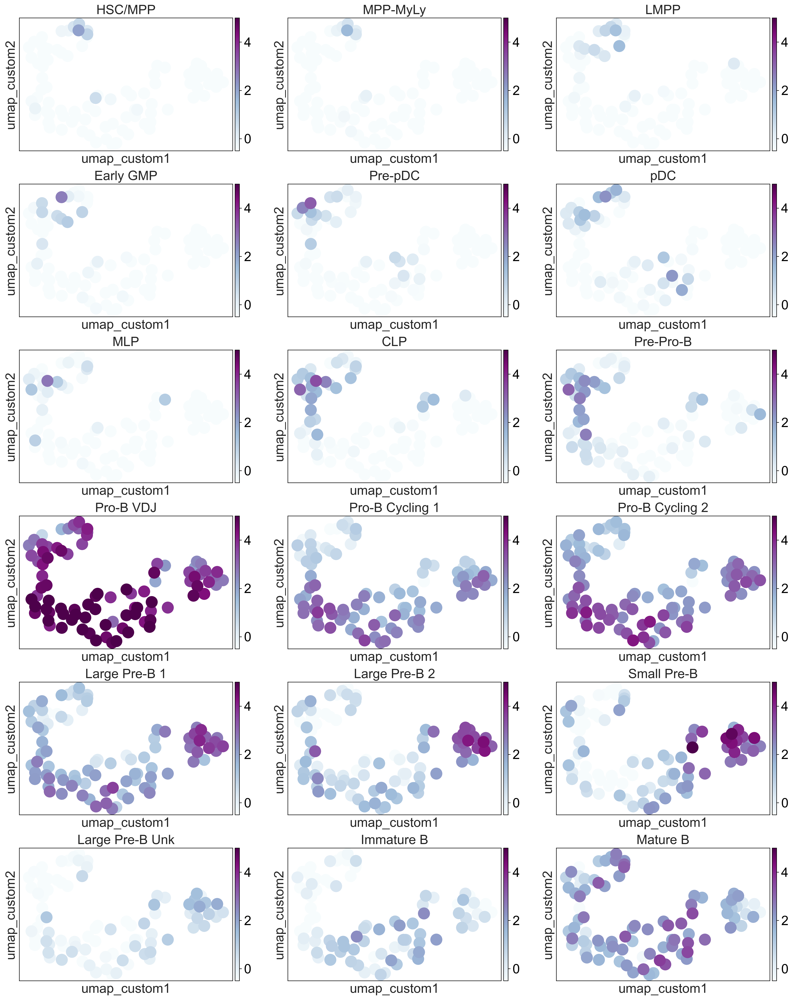

In [46]:
sc.settings.set_figure_params(dpi=150, fontsize=20, dpi_save=200, figsize=(6,4), format='png')
sc.pl.embedding(dat, basis = 'umap_custom', color=['HSC/MPP', 'MPP-MyLy', 'LMPP', 'Early GMP', 'Pre-pDC', 'pDC',
                                                   'MLP', 'CLP', 'Pre-Pro-B', 'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                                                   'Large Pre-B 1', 'Large Pre-B 2', 'Small Pre-B', 'Large Pre-B Unk', 'Immature B', 'Mature B'], 
                legend_fontsize=8, ncols=3, cmap='BuPu', vmin = -0.5, vmax = 5, show = None)#, save = 'CellStates_Composition_Clustering.pdf')
sc.settings.set_figure_params(dpi=150, fontsize=6, dpi_save=200, figsize=(6,4), format='png')


In [47]:
dat.obsm[' '] = dat.obsm['X_umap_custom']

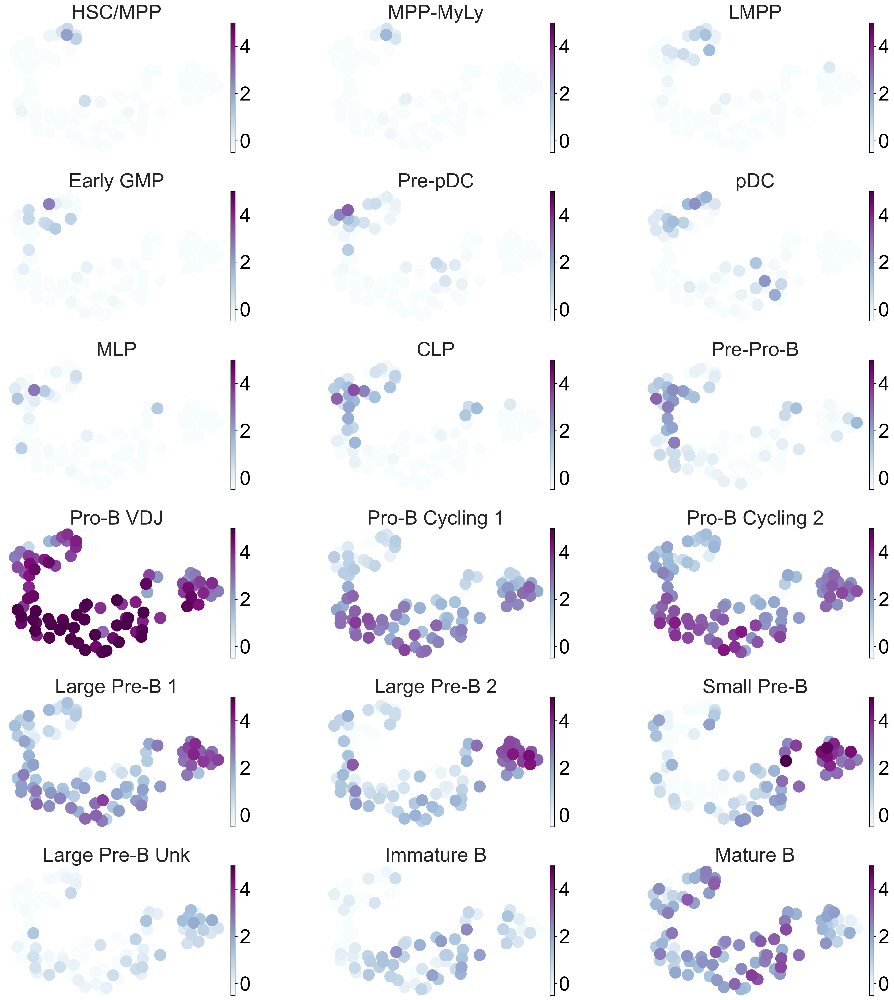

In [48]:
sc.settings.set_figure_params(dpi=150, fontsize=30, dpi_save=200, figsize=(6,4), format='png')

sc.pl.embedding(dat, basis = ' ', color=['HSC/MPP', 'MPP-MyLy', 'LMPP', 'Early GMP', 'Pre-pDC', 'pDC',
                                                   'MLP', 'CLP', 'Pre-Pro-B', 'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                                                   'Large Pre-B 1', 'Large Pre-B 2', 'Small Pre-B', 'Large Pre-B Unk', 'Immature B', 'Mature B'], 
                legend_fontsize=8, ncols=3, cmap='BuPu', vmin = -0.5, vmax = 5, wspace = 0.3, hspace = 0.3, frameon=False)#, save = 'CellStates_Composition_Clustering_noAxis.pdf')

sc.settings.set_figure_params(dpi=150, fontsize=6, dpi_save=200, figsize=(6,4), format='png')


In [49]:
dat.obs['AgeCat'] = np.where(dat.obs['age'] < 10, '< 10yo', '> 10yo')

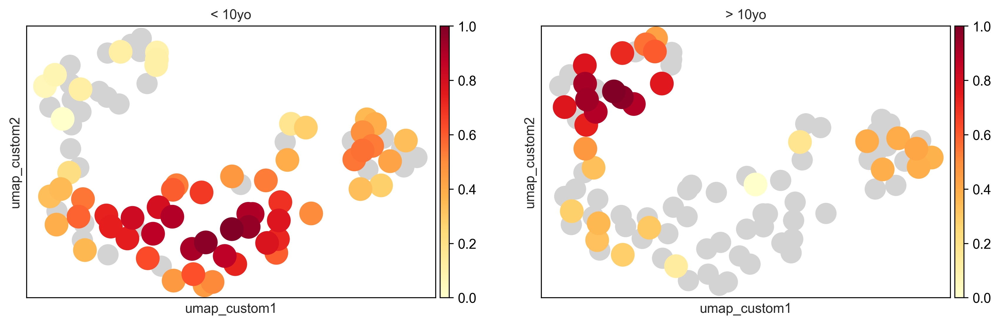

In [80]:
sc.tl.embedding_density(dat, basis = 'umap_custom', groupby='AgeCat')
sc.pl.embedding_density(dat, basis = 'umap_custom', key='umap_custom_density_AgeCat', bg_dotsize = 1200, fg_dotsize = 1500)

### Check out PCA results 

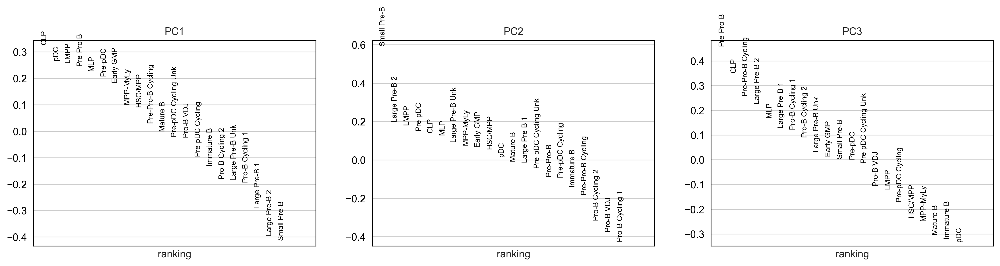

In [79]:
sc.pl.pca_loadings(dat)

In [51]:
dat.obs['PC1'] = dat.obsm['X_pca'][:,0]
dat.obs['PC2'] = dat.obsm['X_pca'][:,1]

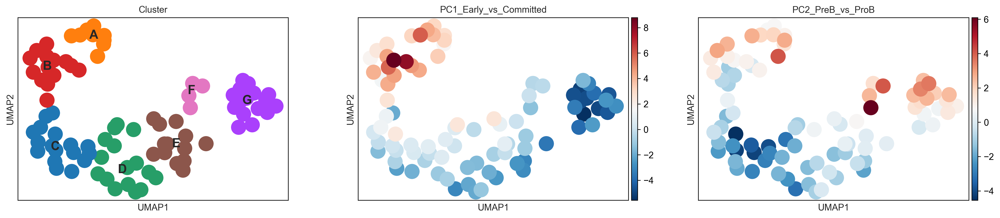

In [77]:
dat.obs['PC1_Early_vs_Committed'] = dat.obs['PC1']
dat.obs['PC2_PreB_vs_ProB'] = dat.obs['PC2']

sc.pl.umap(dat, color = ['Cluster', 'PC1_Early_vs_Committed', 'PC2_PreB_vs_ProB'], cmap='RdBu_r', legend_loc = 'on data', legend_fontsize=15)

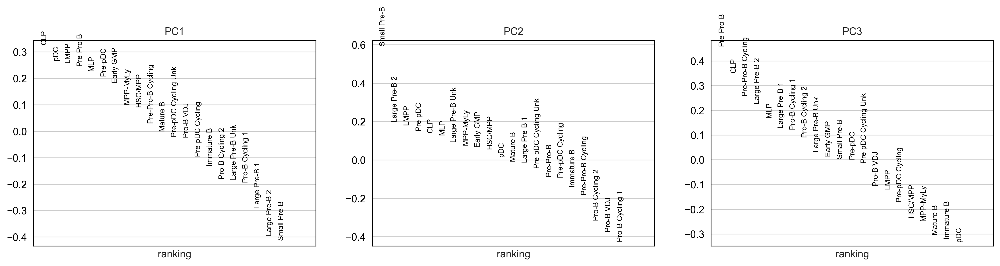

In [78]:
sc.pl.pca_loadings(dat)

### Add NMF and plot

In [83]:
dat.obs = dat.obs.join(dat_NMF.obs.filter(regex='NMF'))

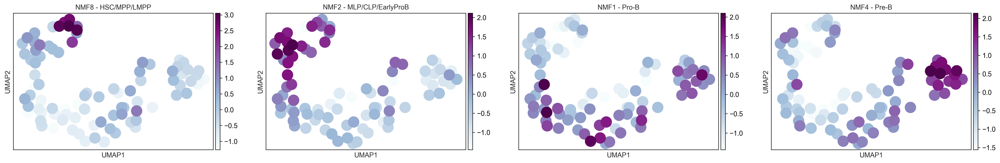

In [85]:
dat.obs['NMF8 - HSC/MPP/LMPP'] = (dat.obs['NMF8'] - np.mean(dat.obs['NMF8'])) / np.std(dat.obs['NMF8'])
dat.obs['NMF2 - Early Lymphoid'] = (dat.obs['NMF2'] - np.mean(dat.obs['NMF2'])) / np.std(dat.obs['NMF2'])
dat.obs['NMF1 - Pro-B'] = (dat.obs['NMF1'] - np.mean(dat.obs['NMF1'])) / np.std(dat.obs['NMF1'])
dat.obs['NMF4 - Pre-B'] = (dat.obs['NMF4'] - np.mean(dat.obs['NMF4'])) / np.std(dat.obs['NMF4'])

sc.pl.umap(dat, color=['NMF8 - HSC/MPP/LMPP', 'NMF2 - MLP/CLP/EarlyProB',
                       'NMF1 - Pro-B', 'NMF4 - Pre-B'], 
                ncols=4, cmap='BuPu', vmin = 'p5', vmax = 'p99', wspace=0.15)#, save = 'DevState_UMAP_Abundance.pdf')

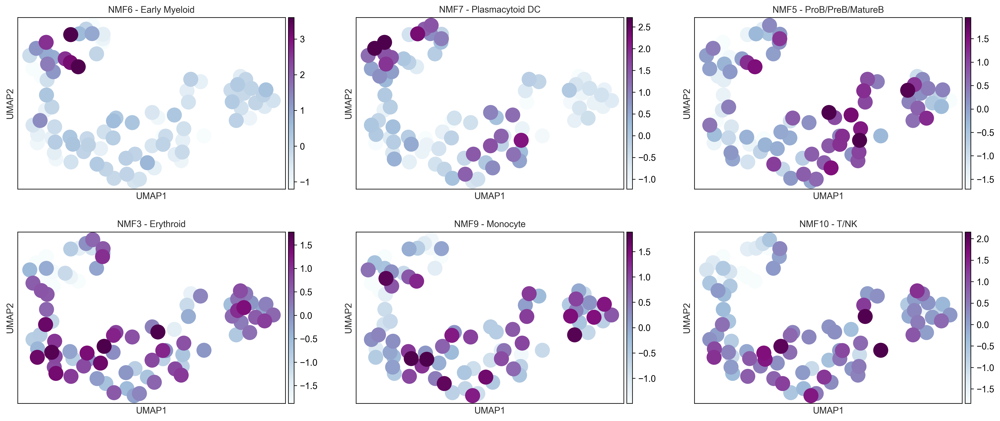

In [86]:
dat.obs['NMF6 - Early Myeloid'] = (dat.obs['NMF6'] - np.mean(dat.obs['NMF6'])) / np.std(dat.obs['NMF6'])
dat.obs['NMF7 - Plasmacytoid DC'] = (dat.obs['NMF7'] - np.mean(dat.obs['NMF7'])) / np.std(dat.obs['NMF7'])
dat.obs['NMF5 - ProB/PreB/MatureB'] = (dat.obs['NMF5'] - np.mean(dat.obs['NMF5'])) / np.std(dat.obs['NMF5'])

dat.obs['NMF3 - Erythroid'] = (dat.obs['NMF3'] - np.mean(dat.obs['NMF3'])) / np.std(dat.obs['NMF3'])
dat.obs['NMF9 - Monocyte'] = (dat.obs['NMF9'] - np.mean(dat.obs['NMF9'])) / np.std(dat.obs['NMF9'])
dat.obs['NMF10 - T/NK'] = (dat.obs['NMF10'] - np.mean(dat.obs['NMF10'])) / np.std(dat.obs['NMF10'])

sc.pl.umap(dat, color=['NMF6 - Early Myeloid', 'NMF7 - Plasmacytoid DC', 'NMF5 - ProB/PreB/MatureB',
                       'NMF3 - Erythroid', 'NMF9 - Monocyte', 'NMF10 - T/NK'], 
                ncols=3, cmap='BuPu', vmin = 'p5', vmax = 'p99', wspace=0.15)#, save = 'DevState_OtherLineages_UMAP_Abundance.pdf')

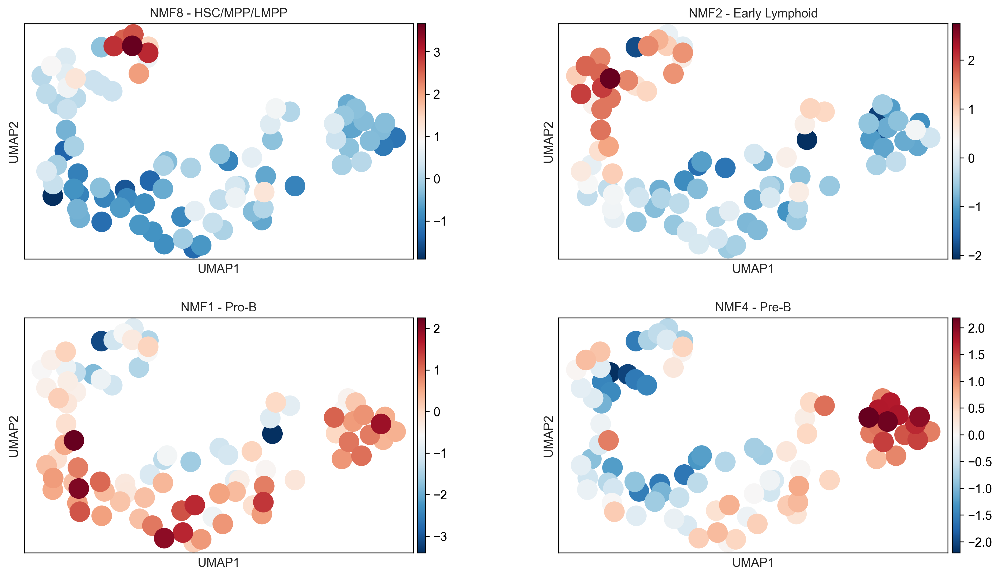

In [88]:
sc.pl.umap(dat, color=['NMF8 - HSC/MPP/LMPP', 'NMF2 - Early Lymphoid',
                       'NMF1 - Pro-B', 'NMF4 - Pre-B'], 
                ncols=2, cmap='RdBu_r', vmin = 'p0', vmax = 'p100', wspace=0.25)

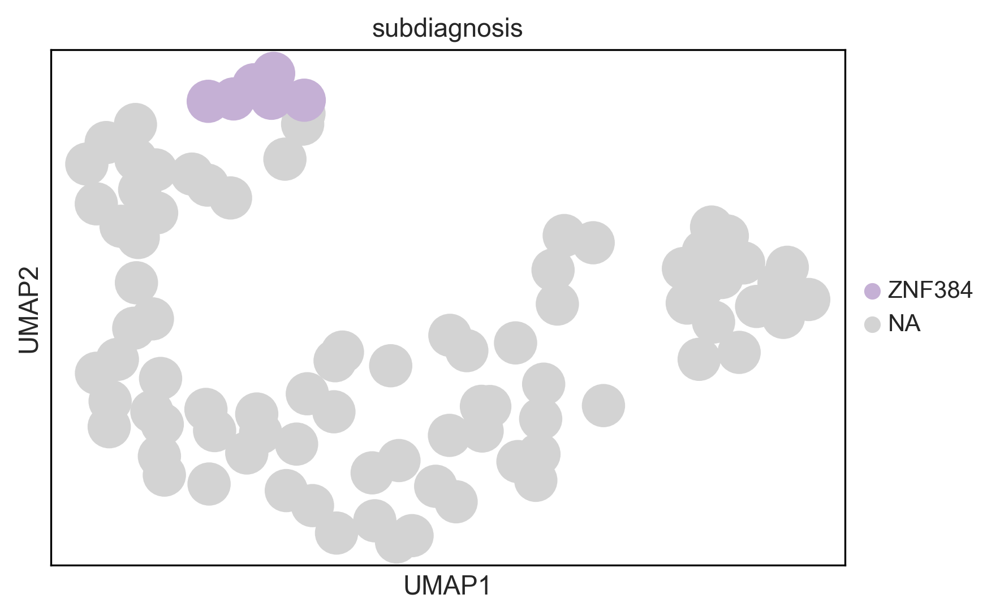

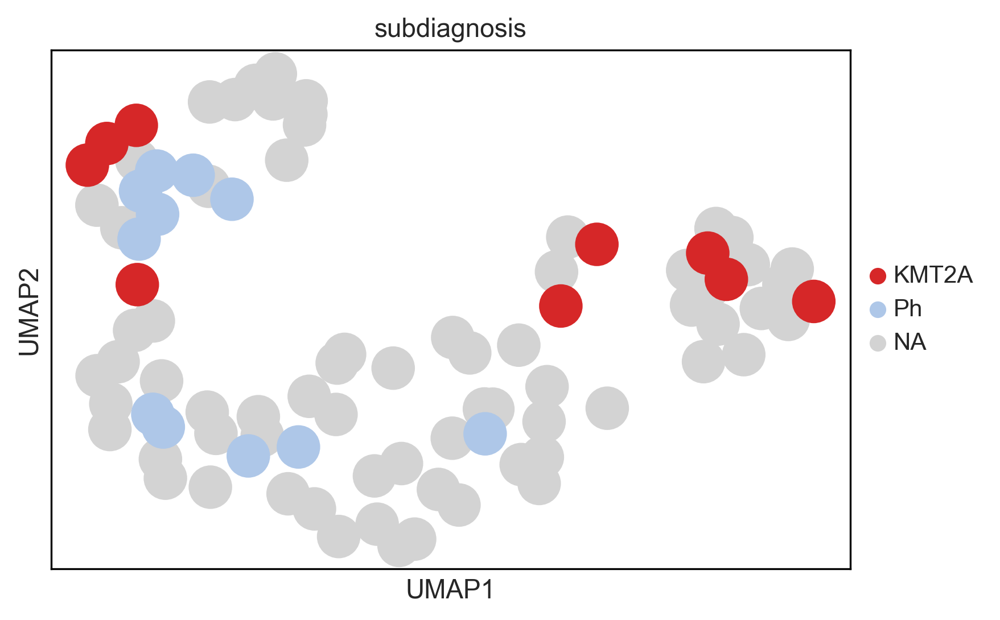

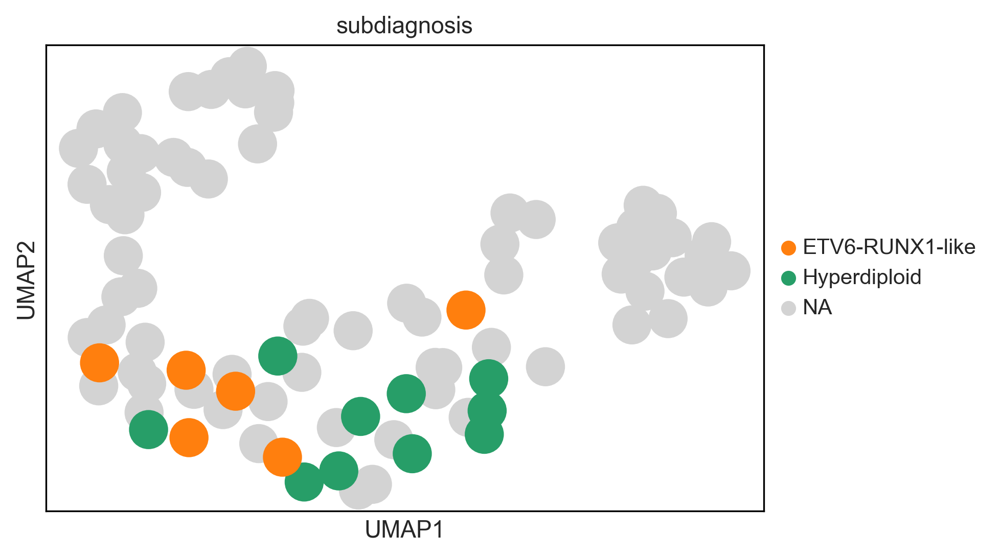

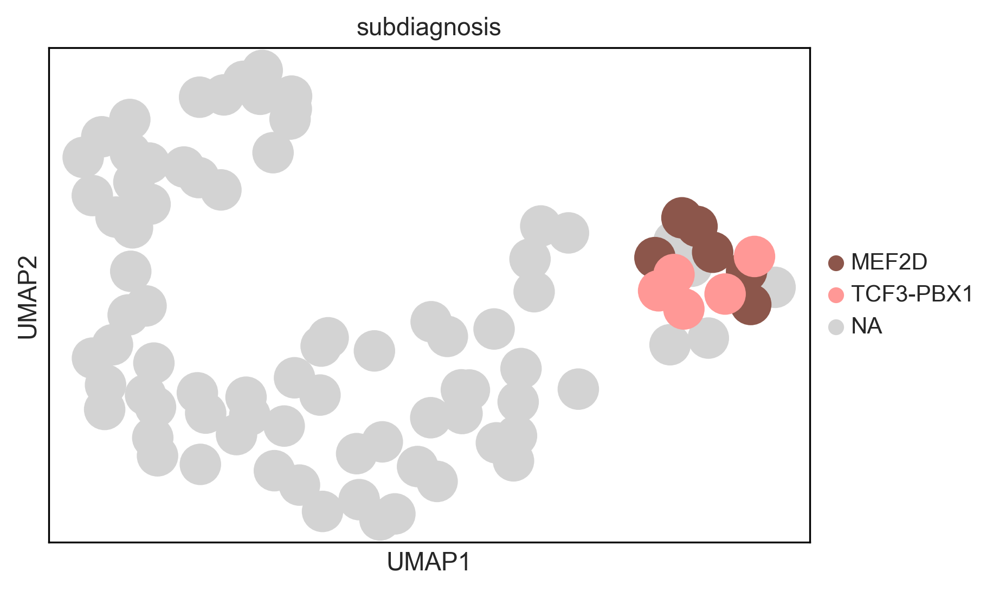

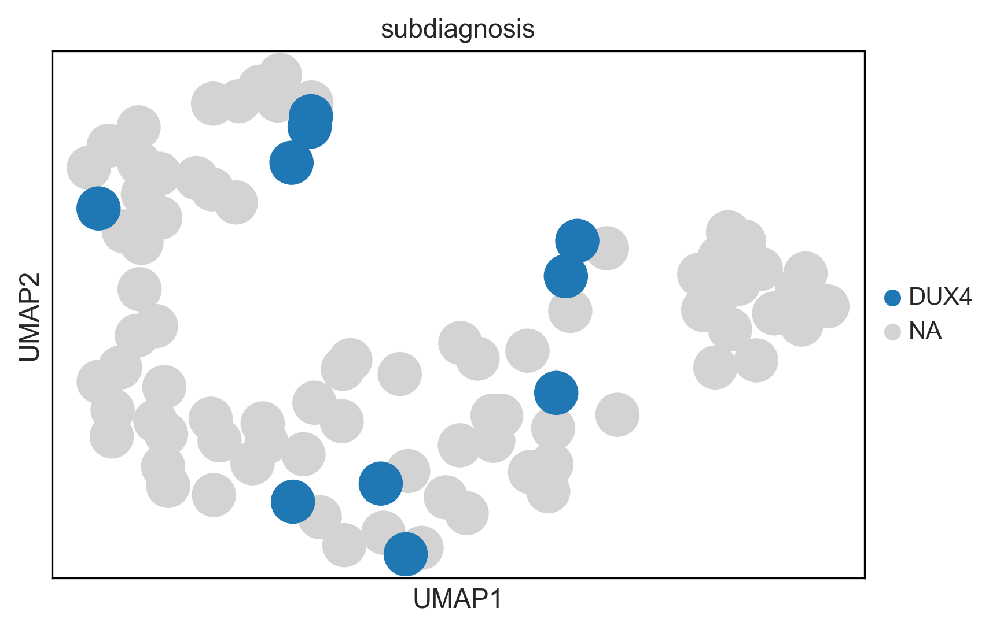

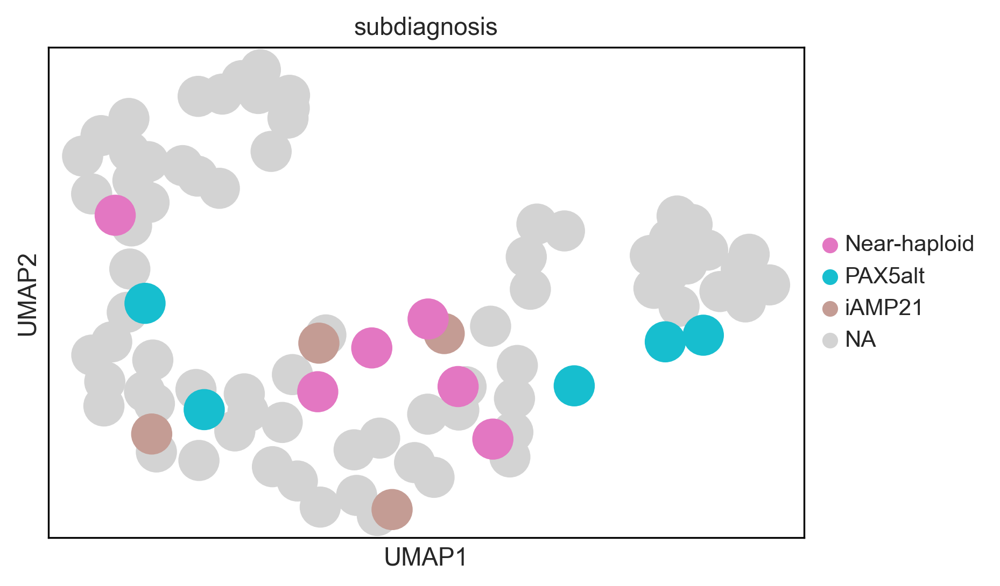

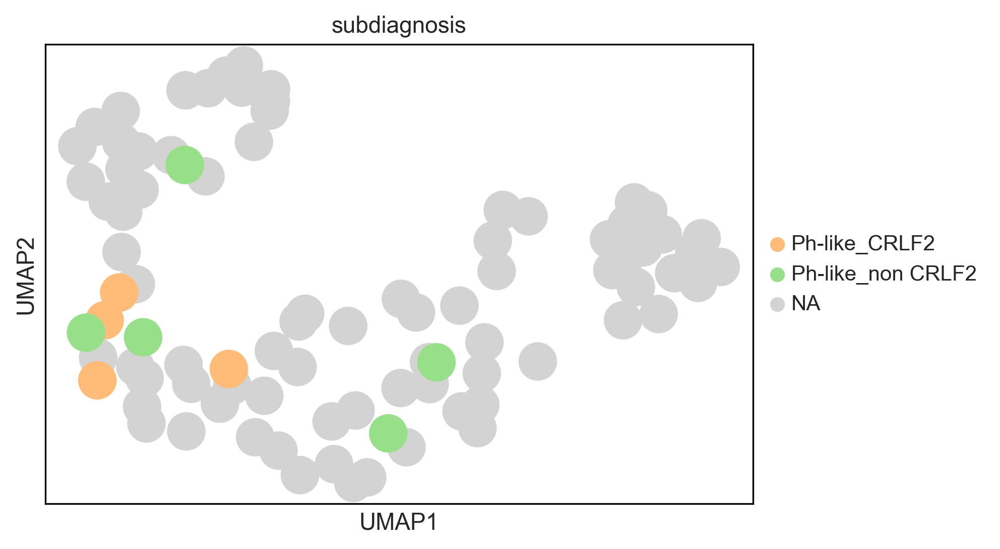

In [89]:
sc.pl.umap(dat, color=['subdiagnosis'], groups = ['ZNF384'], save = 'DevState_UMAP_ZNF384.pdf')
sc.pl.umap(dat, color=['subdiagnosis'], groups = ['Ph', 'KMT2A'], save = 'DevState_UMAP_Ph_KMT2A.pdf')
sc.pl.umap(dat, color=['subdiagnosis'], groups = ['ETV6-RUNX1-like', 'Hyperdiploid'], save = 'DevState_UMAP_ETV6RUNX1_HyperDiploid.pdf')
sc.pl.umap(dat, color=['subdiagnosis'], groups = ['TCF3-PBX1', 'MEF2D'], save = 'DevState_UMAP_TCF3PBX1_MEF2D.pdf')


sc.pl.umap(dat, color=['subdiagnosis'], groups = ['DUX4'], save = 'DevState_UMAP_DUX4.pdf')
sc.pl.umap(dat, color=['subdiagnosis'], groups = ['iAMP21', 'PAX5alt', 'Near-haploid'], save = 'DevState_UMAP_iAMP21_PAX5alt_NearHaploid.pdf')
sc.pl.umap(dat, color=['subdiagnosis'], groups = ['Ph-like_CRLF2', 'Ph-like_non CRLF2'], save = 'DevState_UMAP_Ph_like.pdf')

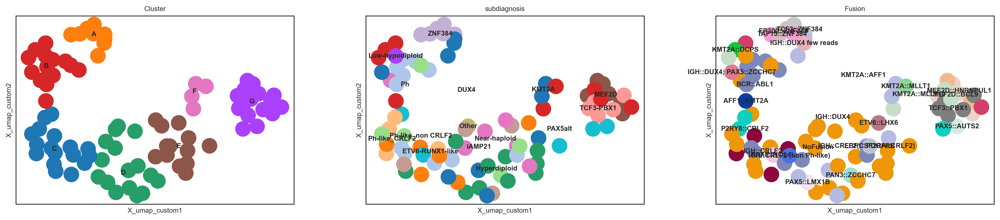

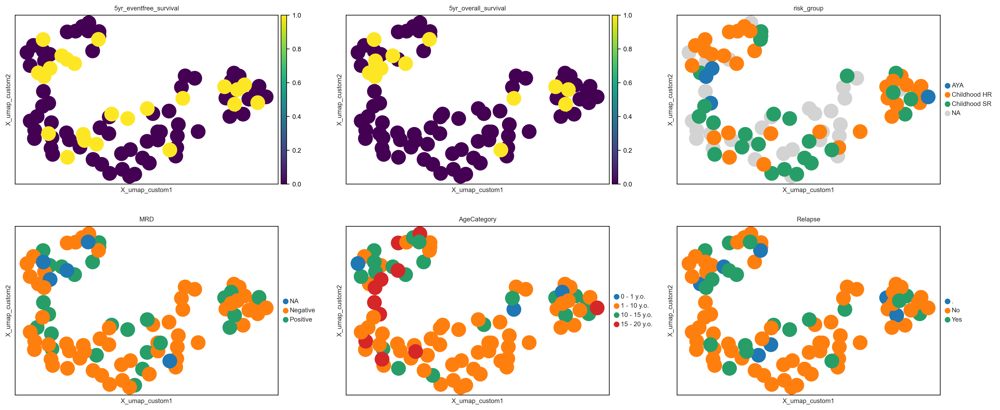

In [90]:
sc.settings.set_figure_params(dpi=150, fontsize=8, dpi_save=200, figsize=(6,4), format='png')

sc.pl.embedding(dat, basis = 'X_umap_custom', color=['Cluster', 'subdiagnosis', 'Fusion'], legend_loc = 'on data', legend_fontsize=8, ncols=3, cmap='viridis')
sc.pl.embedding(dat, basis = 'X_umap_custom', color=['5yr_eventfree_survival', '5yr_overall_survival', 'risk_group', 
                                                         'MRD', 'AgeCategory', 'Relapse'], legend_fontsize=8, ncols=3, cmap='viridis')

In [91]:
BDev_CellTypes = ['HSC/MPP', 'MPP-MyLy', 'LMPP', 
                  'Early GMP', 'Pre-pDC', 'Pre-pDC Cycling', #'Pre-pDC Cycling Unk', 
                  'pDC',
                  'MLP', 'CLP', 'Pre-Pro-B', 
                
                  'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                  'Large Pre-B 1', 'Large Pre-B 2', 'Large Pre-B Unk', 'Small Pre-B',
                  'Immature B', 'Mature B']

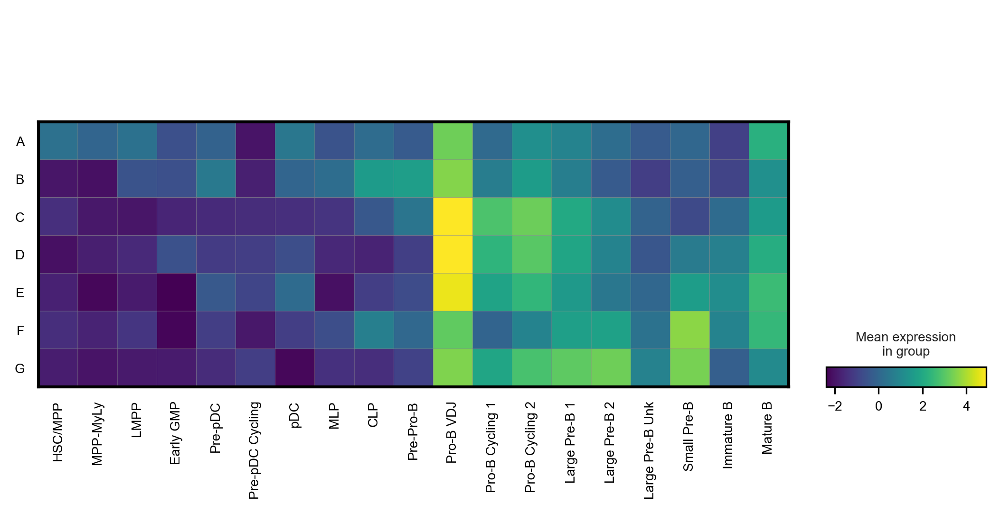

In [92]:
sc.pl.matrixplot(dat, var_names = BDev_CellTypes, 
                 groupby='Cluster', cmap = 'viridis')

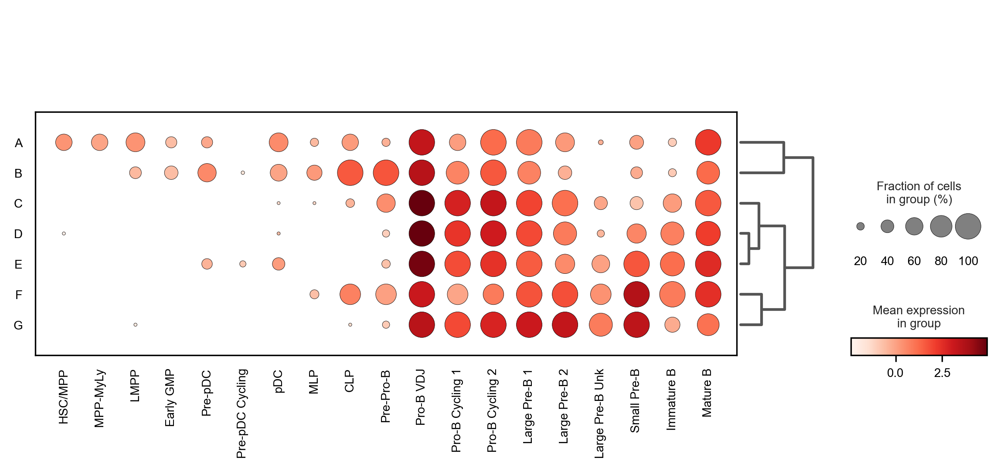

In [93]:
sc.pl.dotplot(dat, var_names = BDev_CellTypes, groupby = 'Cluster', dendrogram=True)

# CHECKPOINT FOR COMPOSITION CLUSTERING

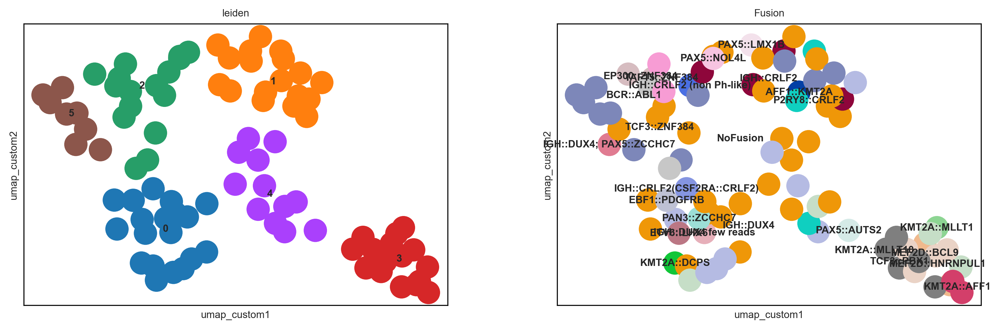

In [202]:
sc.pl.embedding(dat_NMF_X, basis = 'umap_custom', color=['leiden', 'Fusion'], legend_loc = 'on data')

In [1121]:
sc.set_figure_params(fontsize=8)
sns.clustermap(tk.get_obs_prop(dat_NMF_X, 'Fusion', 'Cluster', prop=True).T, cmap='viridis')

KeyError: 'Column not found: Cluster'

In [204]:
dat_floor.obs['leiden'] = dat_NMF_X.obs['leiden']

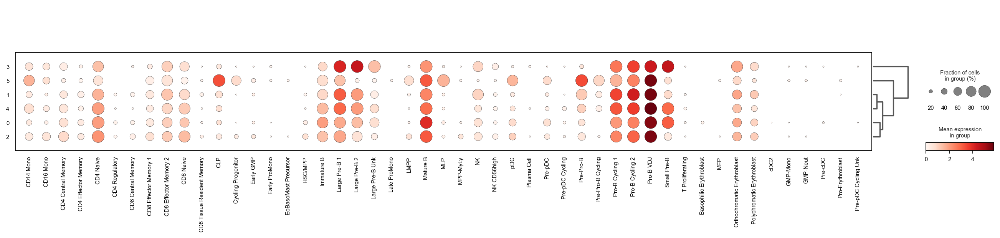

In [205]:
sc.pl.dotplot(dat_floor, var_names = dat_floor.var_names, groupby = 'leiden', dendrogram=True)

## What about consensus clustering

In [206]:
dat_NMF_mat = dat_NMF_X.to_df().T

R[write to console]: end fraction

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered



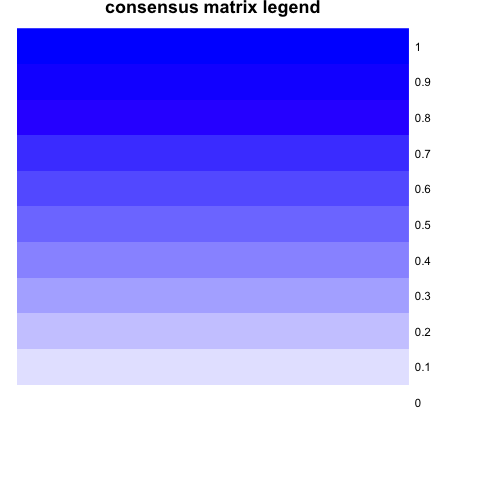

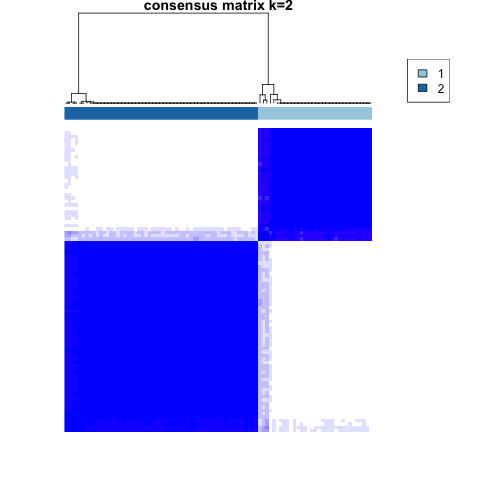

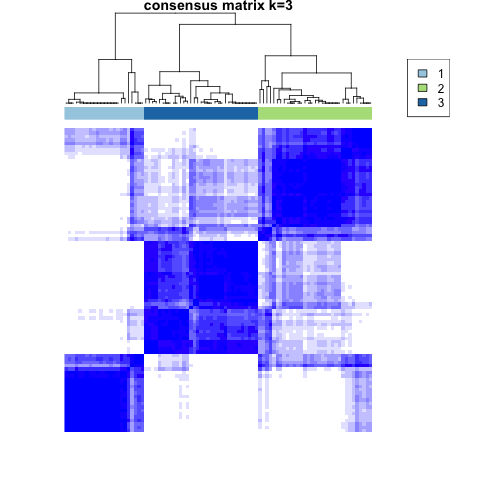

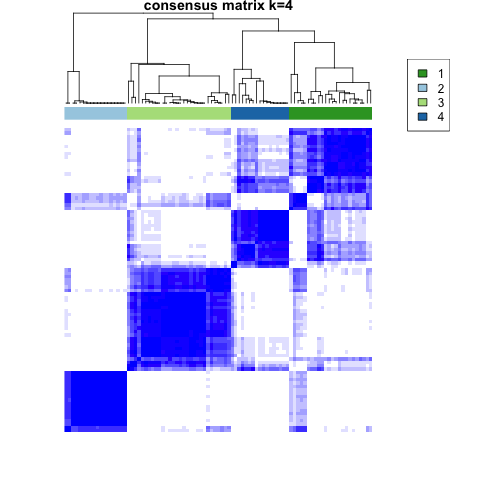

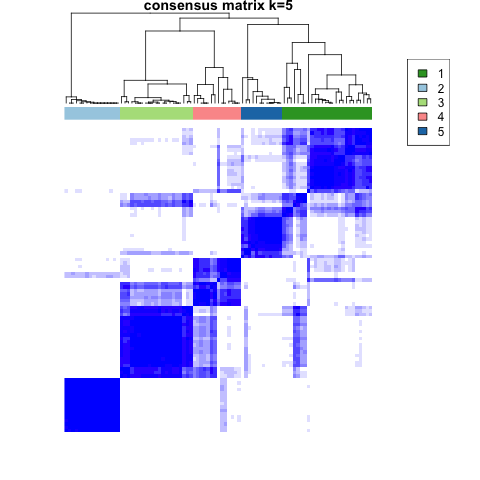

...

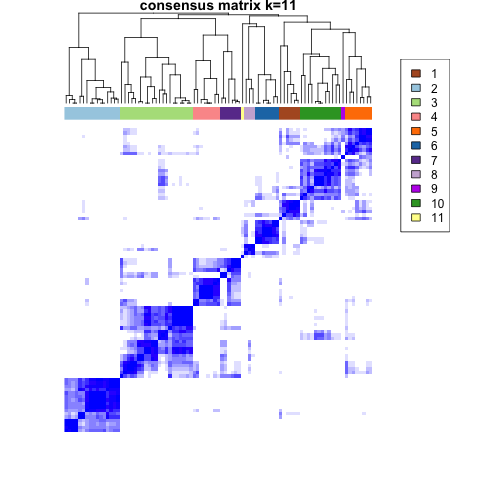

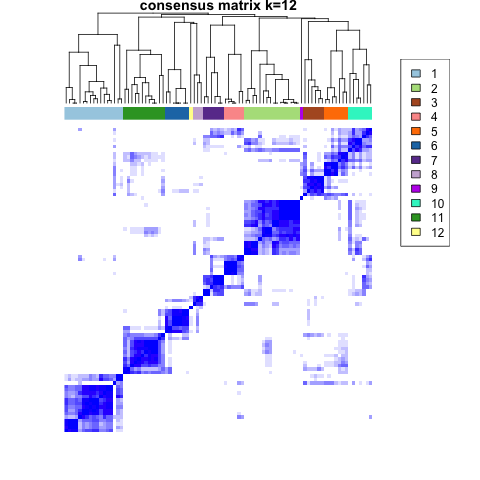

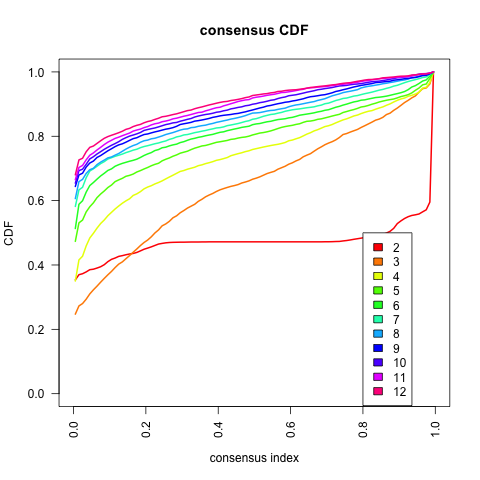

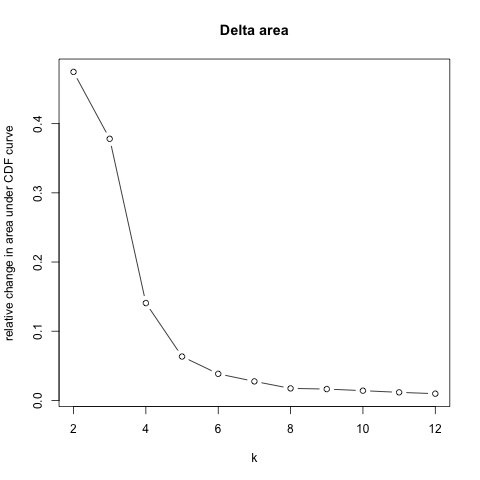

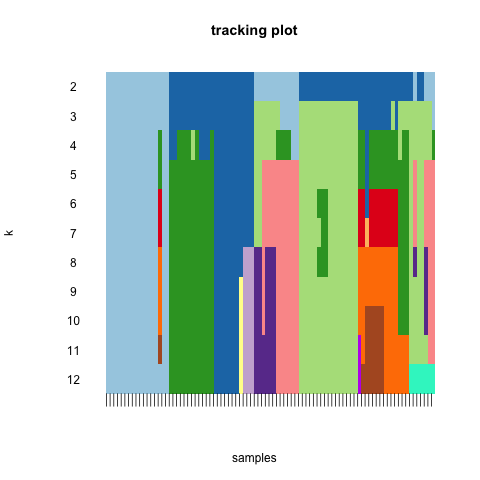

In [207]:
%%R -i dat_NMF_mat
 
library(ConsensusClusterPlus)

rcc = ConsensusClusterPlus(dat_NMF_mat %>% data.matrix(),
                           maxK=12,reps=100,pItem=0.8,pFeature=1,title="testNMF",distance="euclidean",clusterAlg="km")


In [208]:
%%R

consensusClass = rcc[[6]]$consensusClass
consensusClass

 TB-11-6166  TB-12-2483  TB-12-3696  TB-12-3750  TB-13-2250  TB-13-2323 
          1           2           3           2           1           4 
 TB-13-2963  TB-13-5847 TB-17-09220  TB-14-3491  TB-07-0464  TB-01-0950 
          5           1           6           3           2           2 
 TB-06-0952  TB-13-5927  TB-09-4526  TB-09-3424  TB-10-1925  TB-10-2873 
          2           3           1           1           3           5 
 TB-10-4911  TB-09-3407  TB-10-2315  TB-10-2190  TB-15-6137  TB-15-7123 
          5           2           3           3           6           4 
 TB-15-7393  TB-15-8878 TB-15-10479  TB-15-9672 TB-17-12402 TB-16-00956 
          5           3           4           3           2           1 
TB-16-01179 TB-16-02900 TB-16-05323 TB-16-06985 TB-16-05894 TB-16-08325 
          1           4           4           3           3           4 
TB-16-08105 TB-16-10584 TB-17-00797 TB-17-03907 TB-17-04561 TB-17-05726 
          4           2           3           3    

In [209]:
consensusClass = %Rget consensusClass
consensusClass

array([1, 2, 3, 2, 1, 4, 5, 1, 6, 3, 2, 2, 2, 3, 1, 1, 3, 5, 5, 2, 3, 3,
       6, 4, 5, 3, 4, 3, 2, 1, 1, 4, 4, 3, 3, 4, 4, 2, 3, 3, 3, 3, 6, 4,
       4, 6, 6, 1, 4, 6, 3, 6, 3, 6, 1, 5, 6, 4, 6, 1, 2, 6, 2, 6, 6, 5,
       2, 1, 6, 2, 2, 2, 4, 4, 4, 5, 6, 3, 6, 2, 5, 2, 3, 6, 5, 6, 5, 5,
       5], dtype=int32)

In [210]:
dat_NMF_X.obs['consensusCluster'] = consensusClass.astype('str')

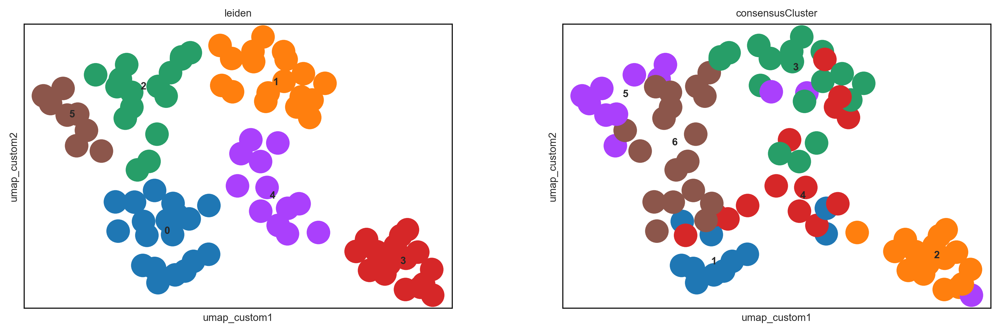

In [211]:
sc.settings.set_figure_params(dpi=150, fontsize=8, dpi_save=200, figsize=(6,4), format='png')

sc.pl.embedding(dat_NMF_X, basis = 'umap_custom', color=['leiden', 'consensusCluster'], legend_loc = 'on data', legend_fontsize=8, ncols=3)

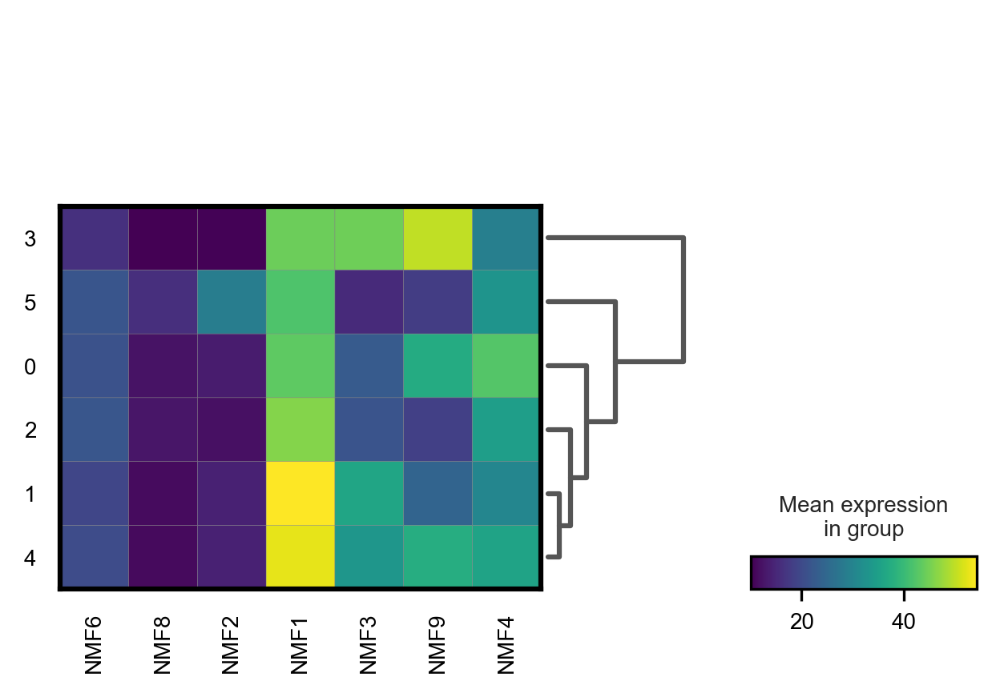

In [214]:
sc.pl.matrixplot(dat_NMF_X, var_names = dat_NMF_X.var_names, groupby='leiden', dendrogram=True)

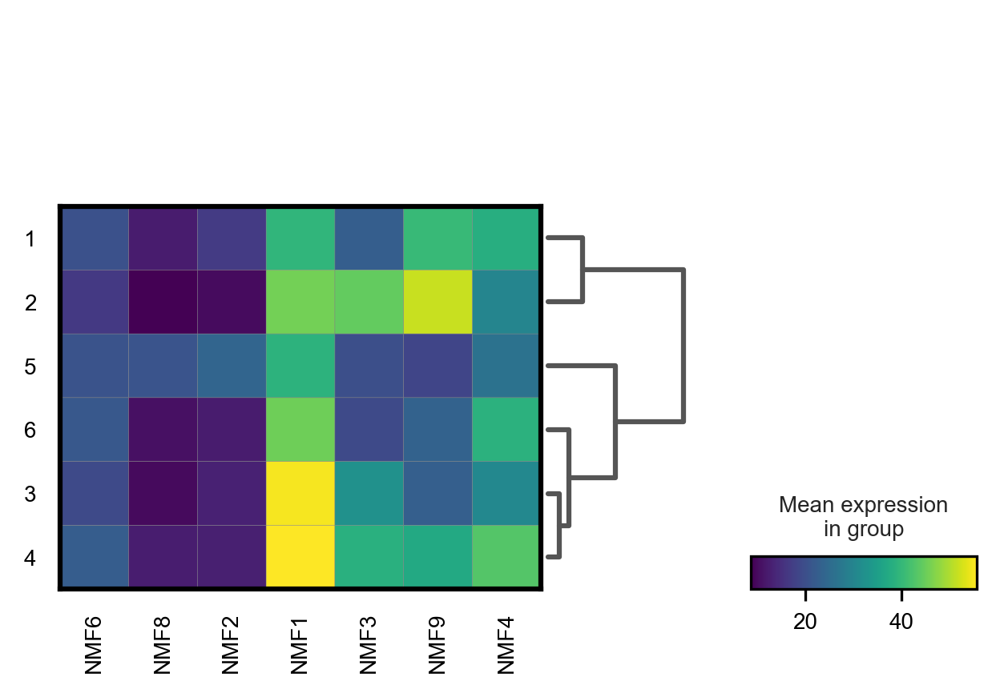

In [215]:
sc.pl.matrixplot(dat_NMF_X, var_names = dat_NMF_X.var_names, groupby='consensusCluster', dendrogram=True)

In [217]:
dat_NMF_X.obs.to_csv("BALLcomposition_NMFClustering_Anno.csv", index_label = 'Patient')

In [221]:
sc.tl.leiden(dat_NMF_X, resolution=1)

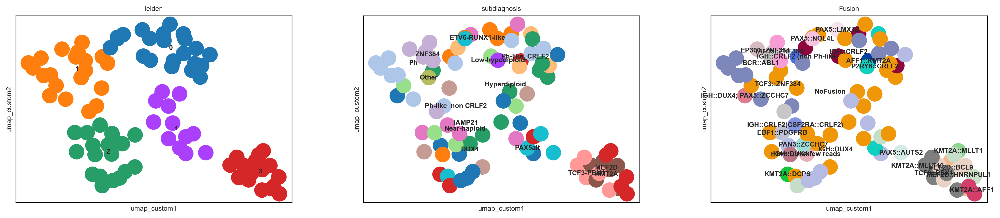

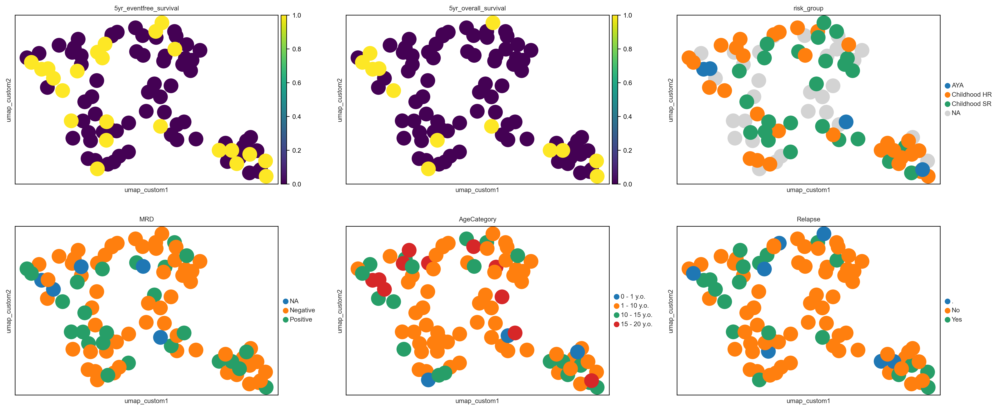

In [222]:
sc.settings.set_figure_params(dpi=150, fontsize=8, dpi_save=200, figsize=(6,4), format='png')

sc.pl.embedding(dat_NMF_X, basis = 'umap_custom', color=['leiden', 'subdiagnosis', 'Fusion'], legend_loc = 'on data', legend_fontsize=8, ncols=3, cmap='viridis')
sc.pl.embedding(dat_NMF_X, basis = 'umap_custom', color=['5yr_eventfree_survival', '5yr_overall_survival', 'risk_group', 
                                                         'MRD', 'AgeCategory', 'Relapse'], legend_fontsize=8, ncols=3, cmap='viridis')

In [223]:
dat_NMF_X.obs.to_csv("BALLcomposition_NMFClustering_Anno.csv", index_label = 'Patient')

## Quantifying by Lineage

In [27]:
# First load prop and exclude celltypes with max proportion < 2% of blasts
dat = sc.read_csv('../BALL_89pt_Filtered_CompositionMatrix.csv').T
sc.pp.filter_genes(dat, min_counts=100) # exclude total cells < 100
dat

AnnData object with n_obs × n_vars = 89 × 49
    var: 'n_counts'

### add annotations

In [28]:
anno1 = pd.read_csv('../BALL_metadata_20230105.txt', delimiter='\t')
dat.obs = dat.obs.join(anno1.set_index('Directory')).reset_index().rename(columns={'TB':'TB_ID', 'index':'Directory'}).set_index('TB_ID')
dat.obs

,Directory,Sample,ID,age,sex,diagnosis,subdiagnosis,location
TB_ID,,,,,,,,
TB-11-6166,SJALL040053_D1,SJALL040053_D1,SJALL040053_D1,4.00,Male,BALL,DUX4,Bone Marrow
TB-12-2483,SJALL040066_D1,SJALL040066_D1,SJALL040066_D1,7.10,Male,BALL,TCF3-PBX1,Bone Marrow
TB-12-3696,SJALL040069,SJALL040069_D1,SJALL040069_D1,7.40,Female,BALL,Ph-like_CRLF2,Bone Marrow
TB-12-3750,SJALL040070_D1,SJALL040070_D1,SJALL040070_D1,5.08,Male,BALL,TCF3-PBX1,Bone Marrow
TB-13-2250,SJALL040099_D1,SJALL040099_D1,SJALL040099_D1,10.00,Male,BALL,DUX4,Bone Marrow
...,...,...,...,...,...,...,...,...
TB-04-1105,SJPHALL007_D1,SJPHALL007_D1,SJPHALL007_D,5.90,Male,BALL,Ph,Bone Marrow
TB-03-1020,SJPHALL010_D1,SJPHALL010_D1_r,SJPHALL010_D,11.90,Female,BALL,Ph,Bone Marrow
TB-94-0662,SJPHALL020_D1,SJPHALL020_D,SJPHALL020_D,17.92,Male,BALL,Ph,Bone Marrow


Keep Diagnosis and Subdiagnosis from Anno1 (one near-haploid converted to Ph-like)

Keep age and sex from anno2 (missing for some of anno1

In [29]:
#anno2 = pd.read_csv('../../../../../BALLmap_deconvolution/scCohort_annotations.csv').set_index('TB-ID')
anno2 = pd.read_csv('scBALL_annotations.csv').set_index('TB-ID')
dat.obs = dat.obs.drop(columns = {'age', 'sex'}).join(anno2.drop(columns = {'diagnosis', 'subdiagnosis'}))
dat.obs

,Directory,Sample,ID,diagnosis,subdiagnosis,location,scpca_sample_id,scpca_project_id,submitter _Short,Sample ID,...,ostime (years),oscensor,Relapse,SJ_MRD_D46 (EOI),EOI MRD (pos/neg),WGS,WGS accession number,RNA,RNA-seq accession number,Unnamed: 33
TB_ID,,,,,,,,,,,,,,,,,,,,,
TB-11-6166,SJALL040053_D1,SJALL040053_D1,SJALL040053_D1,BALL,DUX4,Bone Marrow,SCPCS000301,SCPCP000008,SJALL040053,SJALL040053_D1,...,8.312286,0,No,"Negative, <0.01%",Negative <0.01%,NO,.,YES,EGAS00001003266,NaN
TB-12-2483,SJALL040066_D1,SJALL040066_D1,SJALL040066_D1,BALL,TCF3-PBX1,Bone Marrow,SCPCS000349,SCPCP000008,SJALL040066,SJALL040066_D1,...,0.643408,1,.,"Positive, >0.01%",Positive >0.01%,NO,.,YES,EGAS00001003266,NaN
TB-12-3696,SJALL040069,SJALL040069_D1,SJALL040069_D1,BALL,Ph-like_CRLF2,Bone Marrow,SCPCS000386,SCPCP000008,SJALL040069,SJALL040069_D1,...,6.677755,0,No,"Positive, >0.01%",Positive >0.01%,NO,.,YES,EGAS00001003266,> 0.7
TB-12-3750,SJALL040070_D1,SJALL040070_D1,SJALL040070_D1,BALL,TCF3-PBX1,Bone Marrow,SCPCS000350,SCPCP000008,SJALL040070,SJALL040070_D1,...,7.671615,0,No,"Negative, <0.01%",Negative <0.01%,NO,.,YES,EGAS00001003266,NaN
TB-13-2250,SJALL040099_D1,SJALL040099_D1,SJALL040099_D1,BALL,DUX4,Bone Marrow,SCPCS000302,SCPCP000008,SJALL040099,SJALL040099_D1,...,6.727038,0,No,"Positive, >0.01%",Positive >0.01%,NO,.,YES,EGAS00001003266,> 0.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TB-04-1105,SJPHALL007_D1,SJPHALL007_D1,SJPHALL007_D,BALL,Ph,Bone Marrow,SCPCS000347,SCPCP000008,SJPHALL007,SJPHALL007_D,...,15.113247,0,No,"Positive, >0.01%",Positive >0.01%,YES,EGAS00001005250,YES,EGAS00001003266,NaN
TB-03-1020,SJPHALL010_D1,SJPHALL010_D1_r,SJPHALL010_D,BALL,Ph,Bone Marrow,SCPCS000348,SCPCP000008,SJPHALL010,SJPHALL010_D,...,1.056832,1,Yes,"Positive, >0.01%",Positive >0.01%,YES,EGAS00001005250,YES,EGAS00001000447,> 0.7
TB-94-0662,SJPHALL020_D1,SJPHALL020_D,SJPHALL020_D,BALL,Ph,Bone Marrow,SCPCS000374,SCPCP000008,SJPHALL020,SJPHALL020_D,...,1.284078,1,Yes,.,NaN,YES,EGAS00001003975,YES,EGAS00001000447,NaN


In [30]:
dat.obs['5yr_overall_survival'] = np.where(dat.obs['ostime (years)'] < 5, dat.obs['oscensor'], dat.obs['oscensor']*0)
dat.obs['5yr_eventfree_survival'] = np.where(dat.obs['efstime'] < 5*365.24, dat.obs['efscensor'], dat.obs['efscensor']*0)

dat.obs['AgeCategory'] = np.where(dat.obs['age'] < 1, '0 - 1 y.o.', 
                                       np.where(dat.obs['age'] < 10, '1 - 10 y.o.', 
                                                np.where(dat.obs['age'] < 15, '10 - 15 y.o.', 
                                                         np.where(dat.obs['age'] >= 15, '15 - 20 y.o.', 'NA'))))

dat.obs['MRD'] = np.where(dat.obs['SJ_MRD_D46 (EOI)'] == 'Negative, <0.01%', 'Negative', 
                              np.where(dat.obs['SJ_MRD_D46 (EOI)'] == 'Positive, >0.01%', 'Positive', 'NA'))

Annotations should all be there, and the following samples should be excluded (SJBALL021941_D1 and SJHYPO123_D)

### Add up counts from celltypes

In [31]:
count_matrix = dat.to_df()

In [32]:
%%R -i count_matrix

count_Lineage = count_matrix %>%
    rownames_to_column('Patient') %>% 
    pivot_longer(-Patient, names_to = 'CellType', values_to = 'count') %>% 
    left_join(read_csv('NMF_LineageWeight_ConsensusCluster.csv')) %>% 
    group_by(Patient, Lineage) %>% 
    summarise(count = sum(count)) %>% 
    ungroup() %>% 
    filter(Lineage != 'NA') %>%
    pivot_wider(id_cols = Patient, names_from = Lineage, values_from = count) 
    
count_Lineage

R[write to console]: Parsed with column specification:
cols(
  CellType = col_character(),
  ConsensusCluster = col_double(),
  Lineage = col_character()
)



Joining, by = "CellType"
`summarise()` regrouping output by 'Patient' (override with `.groups` argument)
# A tibble: 89 x 12
   Patient     B Cytotoxic_T_NK Erythroid HSC_MPP_LMPP Large_PreB
   <chr>   <dbl>          <dbl>     <dbl>        <dbl>      <dbl>
 1 TB-00-…   473             77       329           38        170
 2 TB-00-…    49             54        56            0        450
 3 TB-01-…    91             28        30            3       1535
 4 TB-03-…   248            183       330          108        356
 5 TB-03-…   260             13         5           14         25
 6 TB-03-…   284             48       539            0         68
 7 TB-04-…   144             21       137            0         10
 8 TB-04-…   150             40         0           71         27
 9 TB-04-…   155             24        96           78          6
10 TB-05-…   203             17         8            0       1439
# … with 79 more rows, and 6 more variables: MLP_CLP_PreProB <dbl>,
#   Monocyte <d

In [34]:
count_Lineage = %Rget count_Lineage
count_Lineage

,Patient,B,Cytotoxic_T_NK,Erythroid,HSC_MPP_LMPP,Large_PreB,MLP_CLP_PreProB,Monocyte,Naive_T,pDC_Myeloid_Prog,Pro_B,Small_PreB
1,TB-00-0805,473.0,77.0,329.0,38.0,170.0,11.0,124.0,625.0,54.0,1767.0,89.0
2,TB-00-1178,49.0,54.0,56.0,0.0,450.0,32.0,12.0,13.0,0.0,4116.0,14.0
3,TB-01-0950,91.0,28.0,30.0,3.0,1535.0,8.0,22.0,122.0,0.0,2078.0,1457.0
4,TB-03-0327,248.0,183.0,330.0,108.0,356.0,25.0,268.0,281.0,2669.0,618.0,70.0
5,TB-03-1020,260.0,13.0,5.0,14.0,25.0,171.0,181.0,15.0,17.0,1158.0,34.0
...,...,...,...,...,...,...,...,...,...,...,...,...
85,TB-90-0922,288.0,162.0,214.0,9.0,387.0,5.0,74.0,148.0,262.0,3466.0,340.0
86,TB-94-0662,309.0,90.0,0.0,24.0,55.0,664.0,125.0,55.0,114.0,5619.0,25.0
87,TB-95-0372,685.0,75.0,254.0,22.0,129.0,990.0,20.0,88.0,83.0,3873.0,11.0
88,TB-96-1010,83.0,169.0,61.0,74.0,182.0,540.0,28.0,17.0,692.0,3203.0,58.0


In [35]:
dat_lineage = sc.AnnData(count_Lineage.set_index('Patient').loc[dat.obs_names,:], obs = dat.obs)
dat_lineage

/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  """Entry point for launching an IPython kernel.


AnnData object with n_obs × n_vars = 89 × 11
    obs: 'Directory', 'Sample', 'ID', 'diagnosis', 'subdiagnosis', 'location', 'scpca_sample_id', 'scpca_project_id', 'submitter _Short', 'Sample ID', 'In BALL_sample_list', 'age', 'sex', 'tissue_location', 'disease_timing', 'white_blood_cell_count', 'blasts_percentage', 'risk_group', 'Karyotype', 'Fusion', 'In PanALL', 'Mutated genes', 'SV', 'Protocol', 'efstime', 'efscensor', 'ostime', 'ostime (years)', 'oscensor', 'Relapse', 'SJ_MRD_D46 (EOI)', 'EOI MRD (pos/neg)', 'WGS', 'WGS accession number', 'RNA', 'RNA-seq accession number', 'Unnamed: 33', '5yr_overall_survival', '5yr_eventfree_survival', 'AgeCategory', 'MRD'

# Centered Log Ratio Normalization

In [36]:
from skbio.stats import composition

In [37]:
#dat.raw = dat
rawcounts = dat_lineage.to_df()

In [38]:
propcounts = (rawcounts.T/rawcounts.sum(axis=1)).T
propcounts

,B,Cytotoxic_T_NK,Erythroid,HSC_MPP_LMPP,Large_PreB,MLP_CLP_PreProB,Monocyte,Naive_T,pDC_Myeloid_Prog,Pro_B,Small_PreB
TB_ID,,,,,,,,,,,
TB-11-6166,0.109858,0.010631,0.000000,0.008698,0.105026,0.038338,0.019330,0.040593,0.003866,0.515786,0.147874
TB-12-2483,0.022954,0.020641,0.008541,0.001779,0.142171,0.000712,0.001423,0.016548,0.000000,0.551246,0.233986
TB-12-3696,0.056637,0.017152,0.001608,0.009827,0.129176,0.013579,0.011971,0.082366,0.017152,0.655172,0.005360
TB-12-3750,0.014342,0.032652,0.075069,0.000000,0.108331,0.000000,0.007934,0.009155,0.000915,0.410436,0.341166
TB-13-2250,0.269578,0.000712,0.027053,0.053868,0.039867,0.060038,0.000000,0.003085,0.012103,0.503322,0.030375
...,...,...,...,...,...,...,...,...,...,...,...
TB-04-1105,0.024789,0.006610,0.000000,0.011734,0.004462,0.527186,0.012229,0.004793,0.067262,0.340109,0.000826
TB-03-1020,0.137348,0.006867,0.002641,0.007396,0.013207,0.090333,0.095615,0.007924,0.008980,0.611727,0.017961
TB-94-0662,0.043644,0.012712,0.000000,0.003390,0.007768,0.093785,0.017655,0.007768,0.016102,0.793644,0.003531


In [39]:
propcounts_subtype = dat_lineage.obs[['subdiagnosis']].join(propcounts)

In [40]:
%%R -i propcounts_subtype -h 10.5 -w 18 --units in

propcounts_subtype %>% 
    mutate(rankstat = `Pro_B`) %>%
    pivot_longer(-c(subdiagnosis, rankstat)) %>% 
    #mutate(name = factor(name, levels = c('NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6'))) %>% 
    ggplot(aes(x = reorder(subdiagnosis, rankstat), y = value)) +
    facet_wrap(.~name, ncol=3, scales = 'free_y') +
    geom_boxplot(outlier.size=0) + ggpubr::theme_pubr() + 
    ggbeeswarm::geom_quasirandom(width = 0.3, size = 1) + stat_compare_means(method = 'anova') + 
    theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5))
    

R[write to console]: Error in stat_compare_means(method = "anova") : 
  could not find function "stat_compare_means"




Error in stat_compare_means(method = "anova") : 
  could not find function "stat_compare_means"


In [1585]:
dat_lineage.X = composition.multiplicative_replacement(dat_lineage.X)
dat_lineage.X = composition.clr(dat_lineage.X)

In [1586]:
normcounts = dat_lineage.to_df()

In [1605]:
# save CLR normalized
dat_lineage.obs[['Directory']].join(normcounts).reset_index().drop(columns={'TB_ID'}).set_index('Directory')

,B,Cytotoxic_T_NK,Erythroid,HSC_MPP_LMPP,Large_PreB,MLP_CLP_EarlyProB,Monocyte,Naive_T,pDC_Myeloid_Prog,Pro_B,Small_PreB
Directory,,,,,,,,,,,
SJALL040053_D1,1.162231,-1.173144,-1.416697,-1.373815,1.117246,0.109472,-0.575307,0.166630,-2.184745,2.708732,1.459398
SJALL040066_D1,0.356578,0.250355,-0.632034,-2.200650,2.180126,-3.116941,-2.423793,0.029365,-0.656640,3.535277,2.678357
SJALL040069,0.854109,-0.340444,-2.707568,-0.897459,1.678617,-0.574059,-0.700100,1.228606,-0.340444,3.302337,-1.503595
SJALL040070_D1,-0.560116,0.262565,1.095068,-1.094703,1.461854,-1.094703,-1.152167,-1.009066,-3.311651,2.793886,2.609033
SJALL040099_D1,2.351677,-3.584979,0.052607,0.741358,0.440372,0.849798,-1.124916,-2.118642,-0.751766,2.976051,0.168439
...,...,...,...,...,...,...,...,...,...,...,...
SJPHALL007_D1,0.359236,-0.962520,-0.730913,-0.388720,-1.355563,3.416377,-0.347335,-1.284104,1.357413,2.978090,-3.041962
SJPHALL010_D1,1.737478,-1.258254,-2.213765,-1.184146,-0.604327,1.318460,1.375294,-1.115153,-0.989990,3.231246,-0.296843
SJPHALL020_D1,0.877070,-0.356462,-0.778734,-1.678218,-0.848938,1.642011,-0.027958,-0.848938,-0.120073,3.777637,-1.637396


In [1606]:
# save CLR normalized
normcounts.to_csv("BALL_LineageComposition_CLR.csv", index_label = 'TB_ID')

In [1590]:
normcounts_subtype = dat_lineage.obs[['subdiagnosis']].join(normcounts)

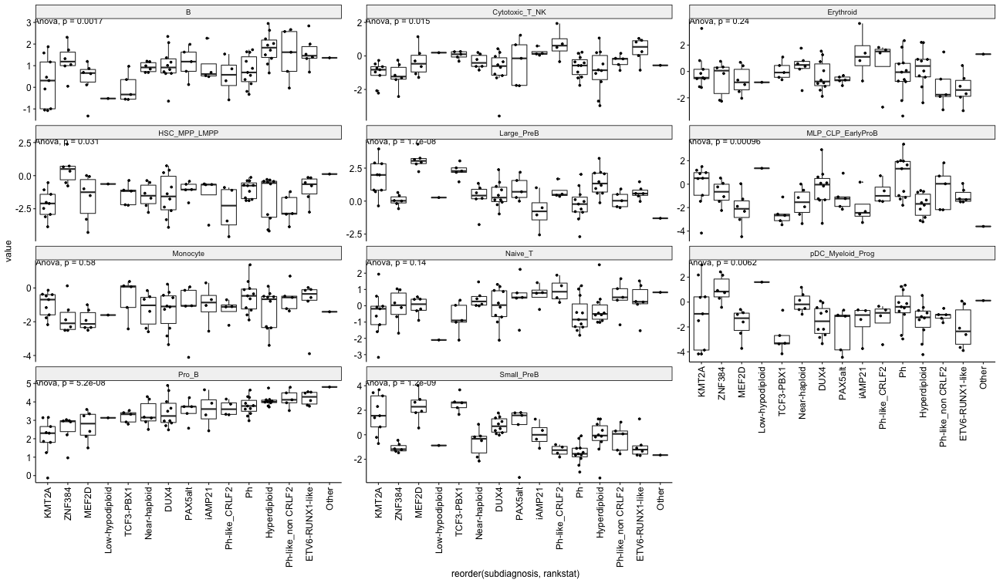

In [1591]:
%%R -i normcounts_subtype -h 10.5 -w 18 --units in

normcounts_subtype %>% 
    mutate(rankstat = Pro_B) %>%
    pivot_longer(-c(subdiagnosis, rankstat)) %>% 
    #mutate(name = factor(name, levels = c('NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6'))) %>% 
    ggplot(aes(x = reorder(subdiagnosis, rankstat), y = value)) +
    facet_wrap(.~name, ncol=3, scales = 'free_y') +
    geom_boxplot(outlier.size=0) + ggpubr::theme_pubr() + 
    ggbeeswarm::geom_quasirandom(width = 0.3, size = 1) + stat_compare_means(method = 'anova') + 
    theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5))
    

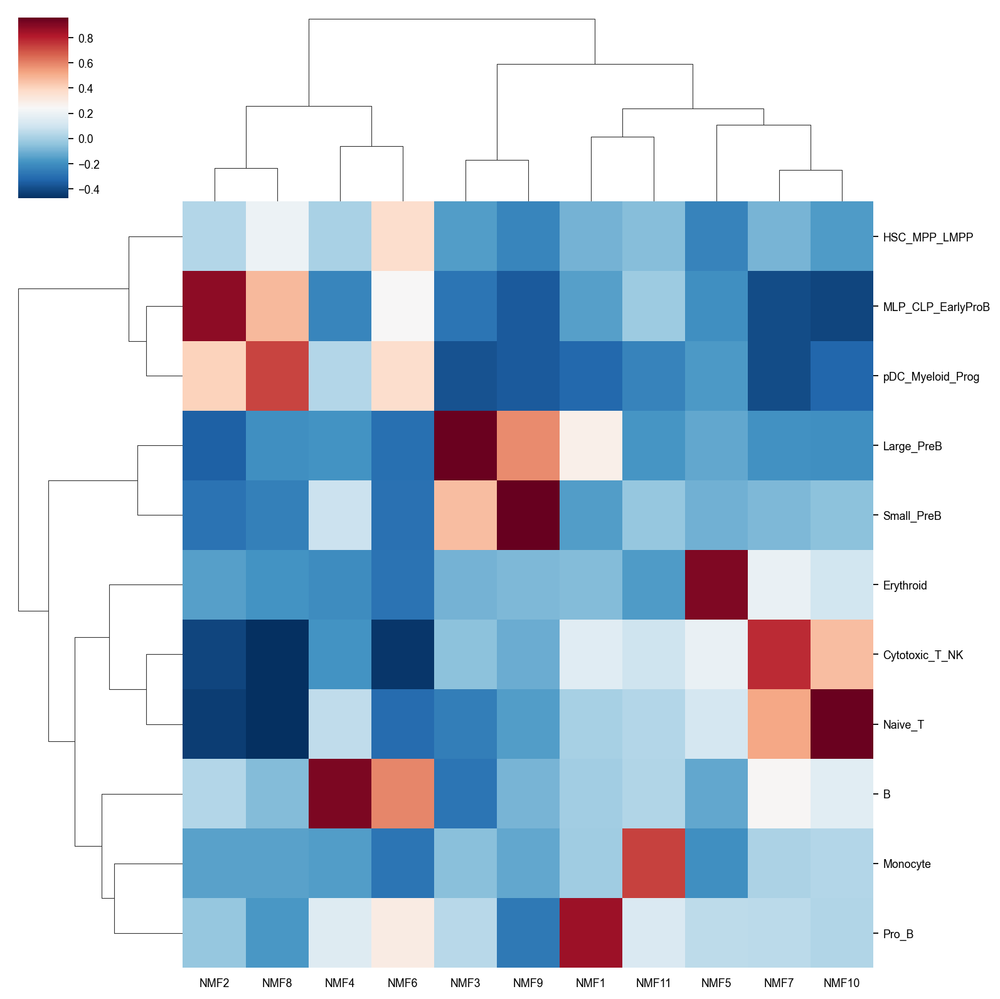

In [1529]:
sc.settings.set_figure_params(dpi=80, fontsize=8, dpi_save=200, figsize=(6,4), format='png')
NMF_Lineage_corr = dat_NMF.obs.filter(regex='NMF').join(dat_lineage.to_df()).corr().filter(regex='NMF').tail(-11)
sns.clustermap(NMF_Lineage_corr, cmap='RdBu_r', method='ward')

In [1568]:
dat_lineage_mat = dat_lineage.to_df()

R[write to console]: end fraction

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered

R[write to console]: clustered



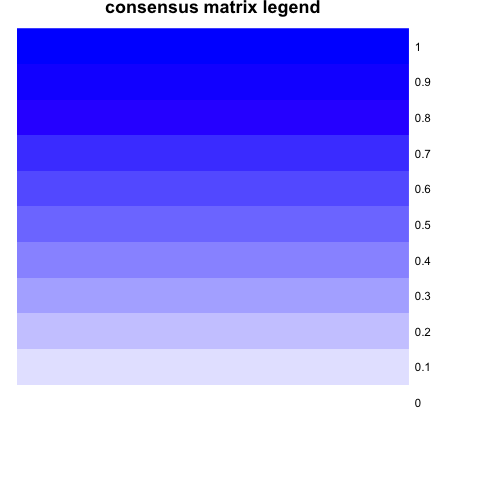

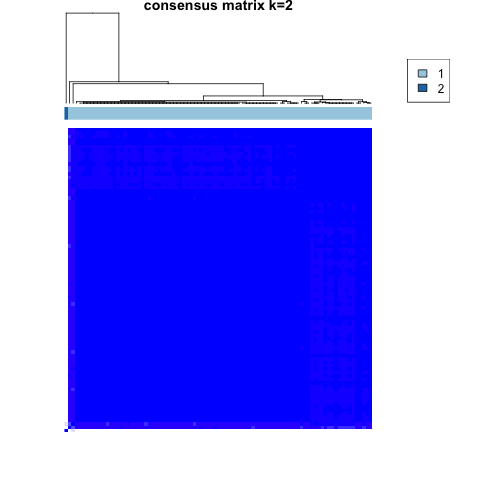

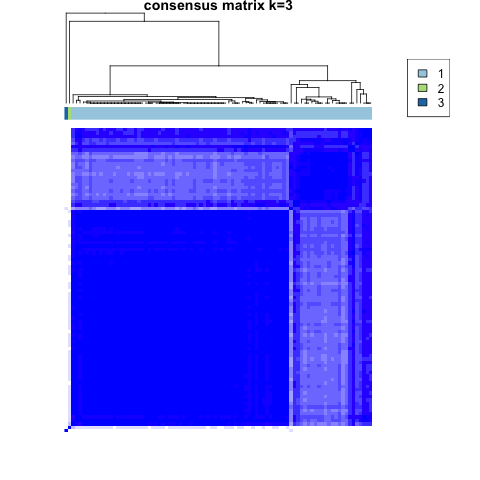

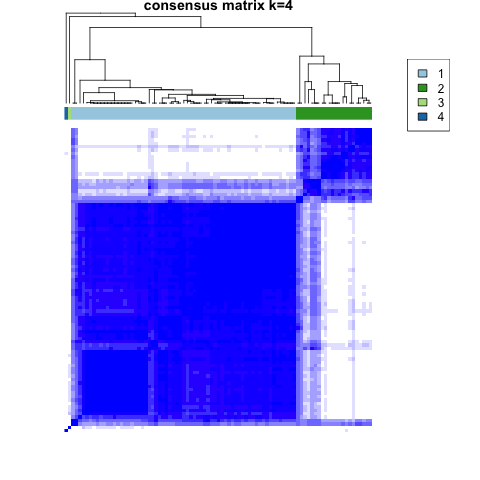

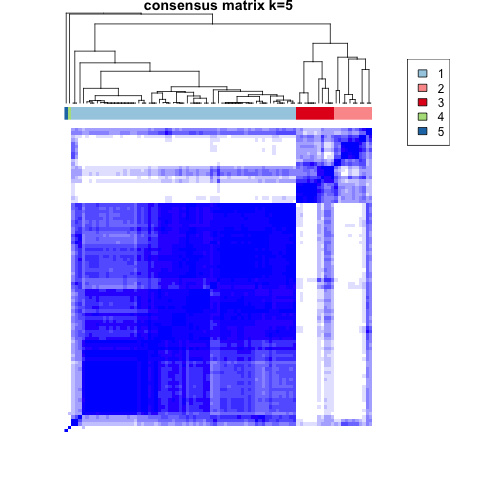

...

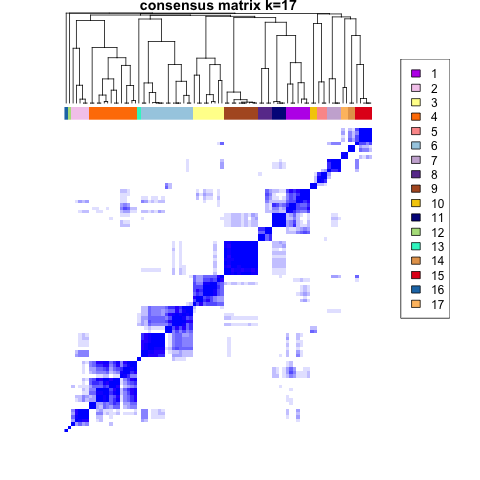

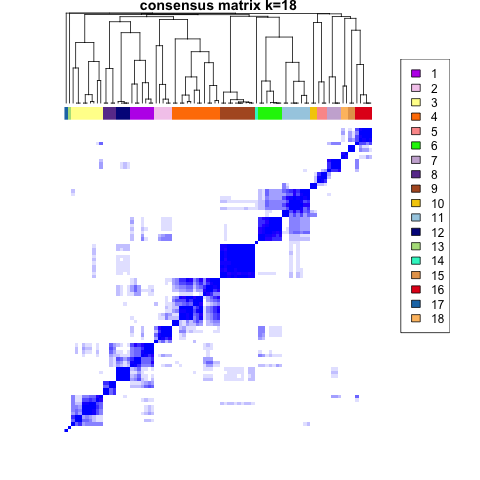

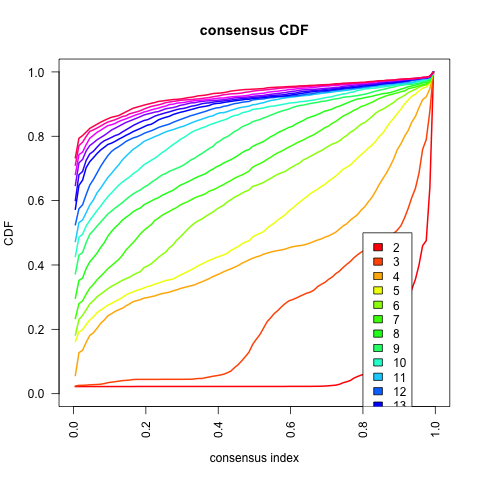

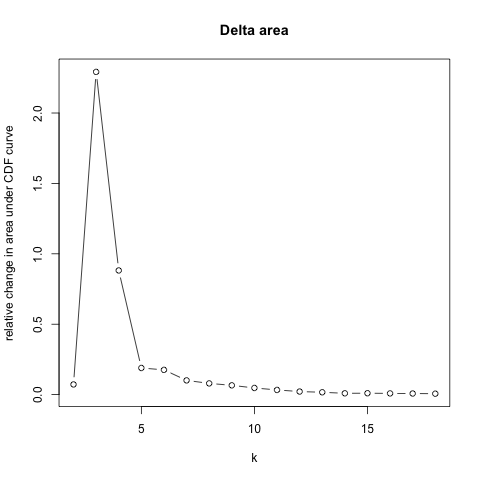

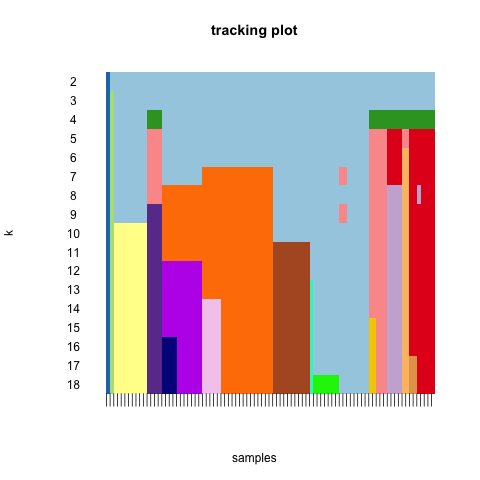

In [1569]:
%%R -i dat_lineage_mat
 
library(ConsensusClusterPlus)

rcc = ConsensusClusterPlus(dat_lineage_mat %>% data.matrix() %>% t(),
                           maxK=18,reps=100,pItem=0.8,pFeature=1,title="testNMF",distance="pearson",clusterAlg="hc")


In [1561]:
%%R

rcc[[14]]$consensusClass %>% sort()

                  CD14 Mono                   CD16 Mono 
                          1                           1 
         CD4 Central Memory         CD4 Effector Memory 
                          2                           2 
                  CD4 Naive              CD4 Regulatory 
                          2                           2 
         CD8 Central Memory       CD8 Effector Memory 1 
                          2                           2 
      CD8 Effector Memory 2                   CD8 Naive 
                          2                           2 
 CD8 Tissue Resident Memory                          NK 
                          2                           2 
                NK CD56high             T Proliferating 
                          2                           2 
                        CLP                         MLP 
                          3                           3 
                  Pre-Pro-B           Pre-Pro-B Cycling 
                          3    

In [82]:
dat_bdev.obs['5yr_overall_survival'] = np.where(dat_bdev.obs['ostime (years)'] < 5, dat_bdev.obs['oscensor'], dat_bdev.obs['oscensor']*0)
dat_bdev.obs['5yr_eventfree_survival'] = np.where(dat_bdev.obs['efstime'] < 5*365.24, dat_bdev.obs['efscensor'], dat_bdev.obs['efscensor']*0)

In [83]:
dat_bdev.obs['log2_blast_percentage'] = np.log2(dat_bdev.obs['blasts_percentage'])
dat_bdev.obs['log2_WBC'] = np.log2(dat_bdev.obs['white_blood_cell_count'])

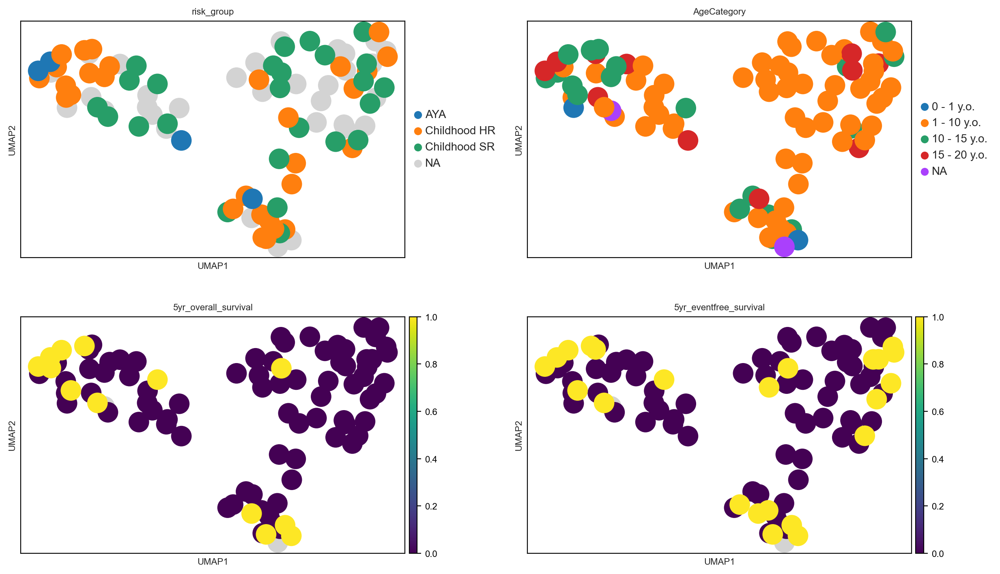

In [86]:
sc.pl.umap(dat_bdev, color=['risk_group', 'AgeCategory',
                            '5yr_overall_survival', '5yr_eventfree_survival', 
                            ], legend_fontsize=10, cmap='viridis', ncols=2, wspace=0.2)


In [1003]:
dat_bdev.obs['PC1'] = dat_bdev.obsm['X_pca'][:,0]
dat_bdev.obs['PC2'] = dat_bdev.obsm['X_pca'][:,1]
dat_bdev.obs['PC3'] = dat_bdev.obsm['X_pca'][:,2]
dat_bdev.obs['PC4'] = dat_bdev.obsm['X_pca'][:,3]
dat_bdev.obs['PC5'] = dat_bdev.obsm['X_pca'][:,4]
dat_bdev.obs['PC6'] = dat_bdev.obsm['X_pca'][:,5]

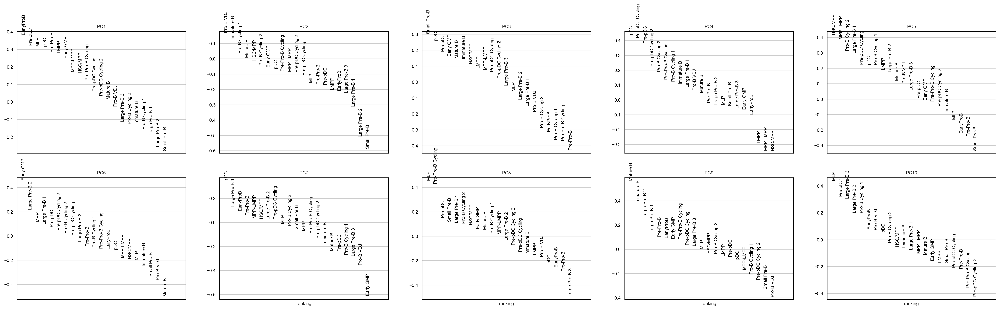

In [1008]:
sc.pl.pca_loadings(dat_bdev, components=[1,2,3,4,5,6,7,8,9,10])

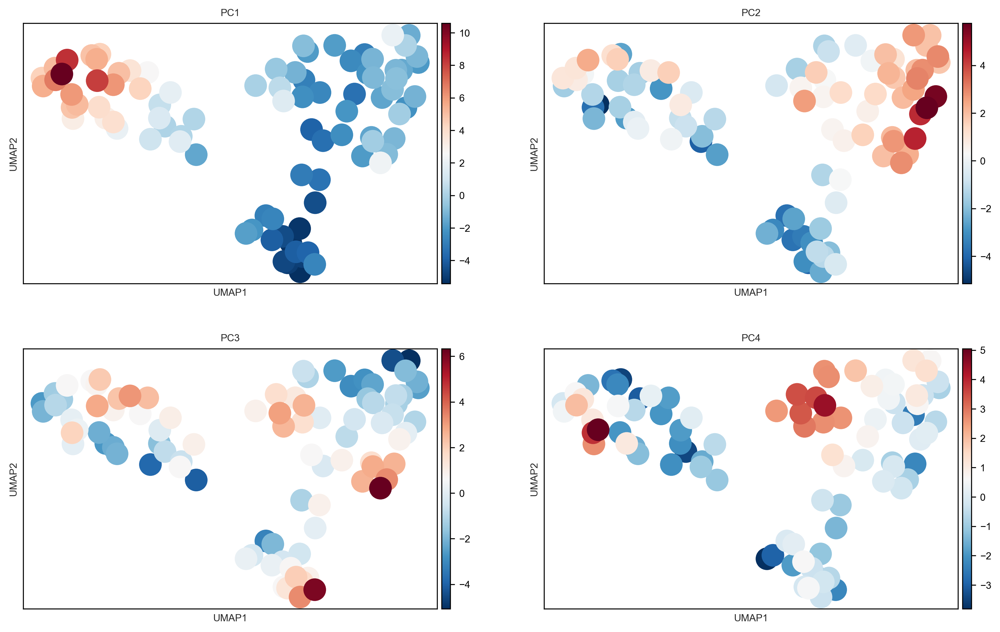

In [1015]:
sc.pl.umap(dat_bdev, color=['PC1', 'PC2', 
                            'PC3', 'PC4'], legend_fontsize=10, cmap='RdBu_r', ncols=2)


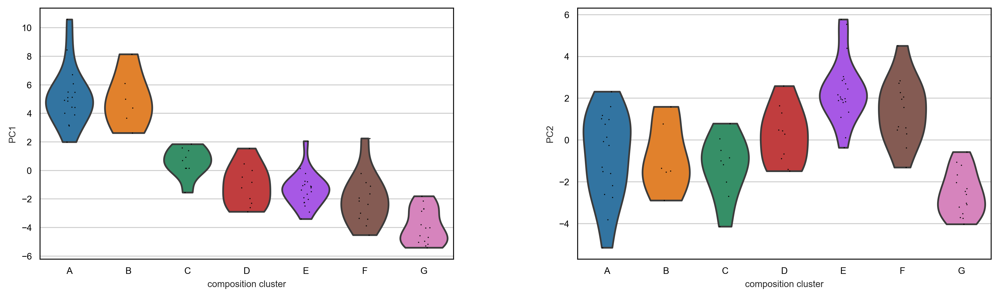

In [1012]:
sc.pl.violin(dat_bdev, keys=['PC1', 'PC2'], groupby = 'composition_cluster')

In [1019]:
dat_bdev_obs = dat_bdev.obs[['composition_cluster', 'sex', 'disease_timing', 'risk_group', 'subdiagnosis', 'MRD', 'Relapse', 
                             'efstime', 'efscensor', 'ostime', 'oscensor', 'ostime (years)', 'risk_group']]

In [1020]:
dat_bdev

AnnData object with n_obs × n_vars = 90 × 21
    obs: 'WGS.1', 'Cluster_fine', 'leiden', 'scpca_sample_id', 'scpca_project_id', 'submitter _Short', 'In BALL_sample_list', 'TB-ID', 'age', 'sex', 'diagnosis', 'subdiagnosis', 'tissue_location', 'disease_timing', 'white_blood_cell_count', 'blasts_percentage', 'risk_group', 'Karyotype', 'Fusion', 'In PanALL', 'Mutated genes', 'SV', 'Protocol', 'efstime', 'efscensor', 'ostime', 'ostime (years)', 'oscensor', 'Relapse', 'SJ_MRD_D46 (EOI)', 'EOI MRD (pos/neg)', 'WGS', 'WGS accession number', 'RNA', 'RNA-seq accession number', 'Unnamed: 33', 'Cluster_Broad', 'MRD', 'composition_cluster', '5yr_overall_survival', '5yr_eventfree_survival', 'log2_blast_percentage', 'log2_WBC', 'PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6'
    var: 'Stdev'
    uns: 'pca', 'dendrogram_CellType', 'neighbors', 'umap', 'leiden', 'Cluster_Broad_colors', 'Cluster_fine_colors', 'subdiagnosis_colors', 'dendrogram_Cluster_Broad', 'dendrogram_subdiagnosis', 'leiden_colors', 'SJ_MRD

### Quick check on survival

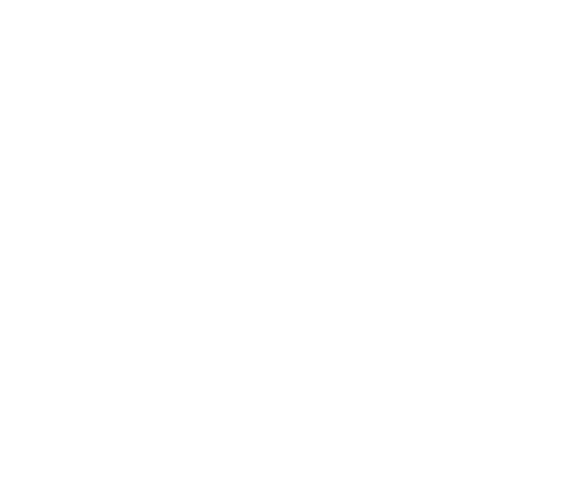

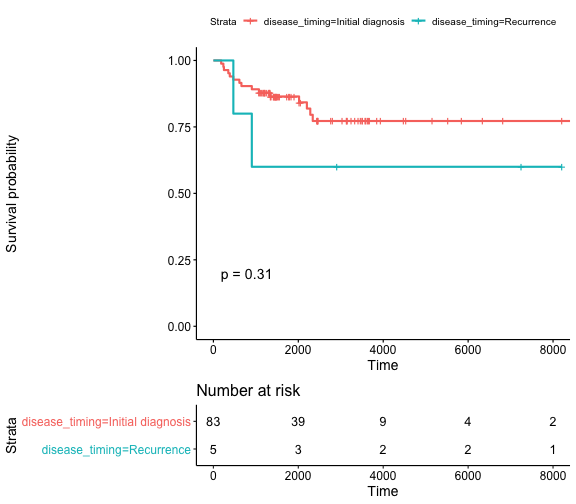

In [1021]:
%%R -i dat_bdev_obs --units in -h 7 -w 8

library(survival)
library(tidyverse)
library(survminer)

ggsurvplot(survfit(Surv(ostime, oscensor) ~ disease_timing, data = dat_bdev_obs), pval=T, risk.table = T)


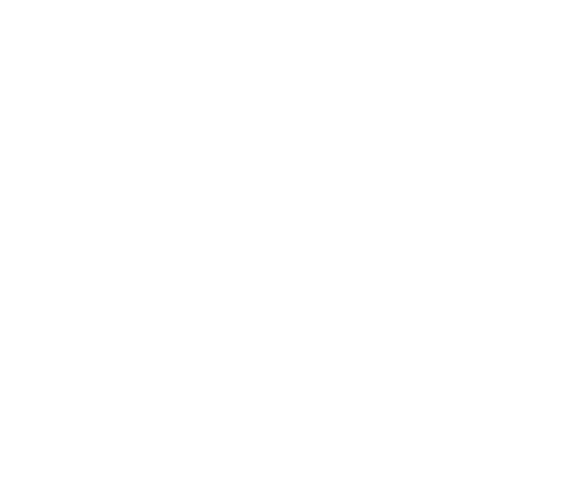

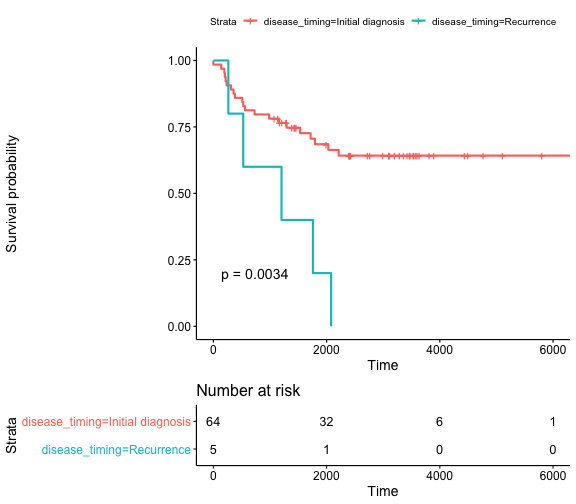

In [1022]:
%%R --units in -h 7 -w 8

ggsurvplot(survfit(Surv(efstime, efscensor) ~ disease_timing, data = dat_bdev_obs), pval=T, risk.table = T)


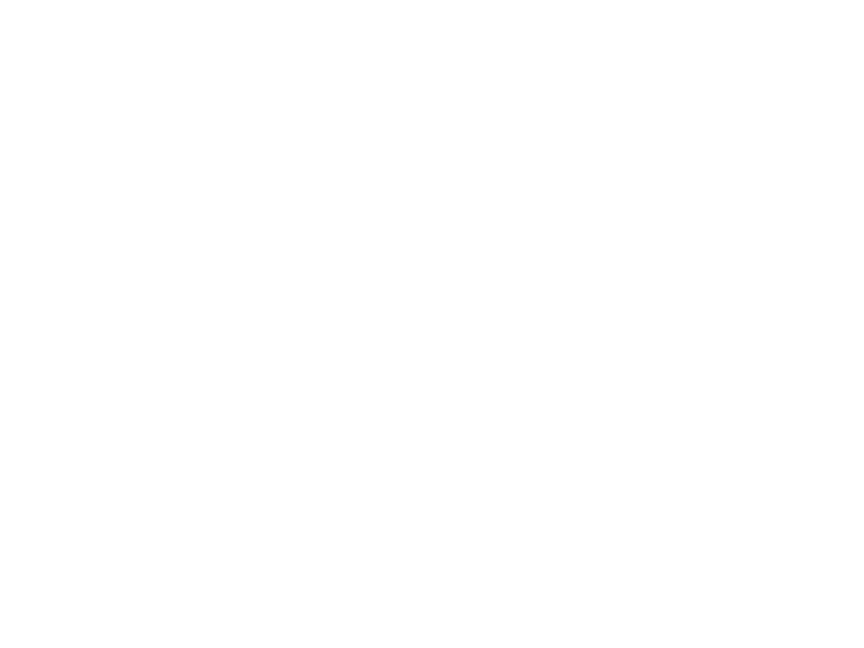

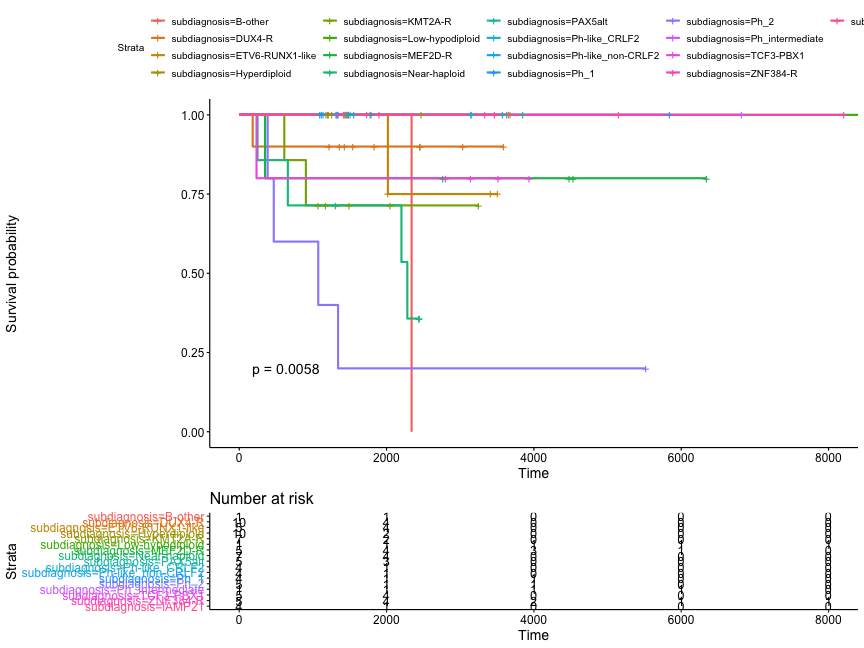

In [1023]:
%%R --units in -h 9 -w 12

ggsurvplot(survfit(Surv(ostime, oscensor) ~ subdiagnosis, data = dat_bdev_obs %>% filter(disease_timing == 'Initial diagnosis')), pval=T, risk.table = T)

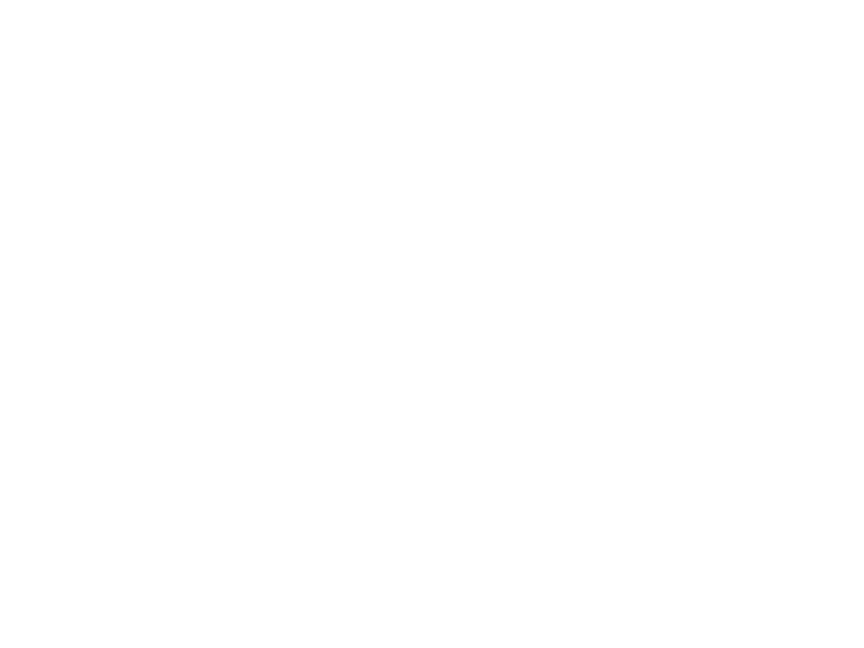

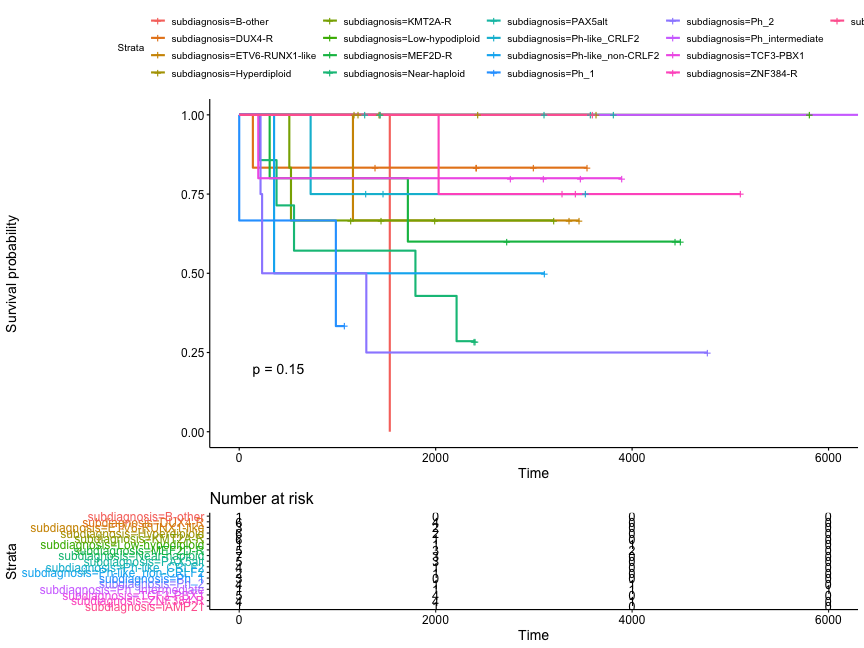

In [1024]:
%%R --units in -h 9 -w 12

ggsurvplot(survfit(Surv(efstime, efscensor) ~ subdiagnosis, data = dat_bdev_obs %>% filter(disease_timing == 'Initial diagnosis')), pval=T, risk.table = T)

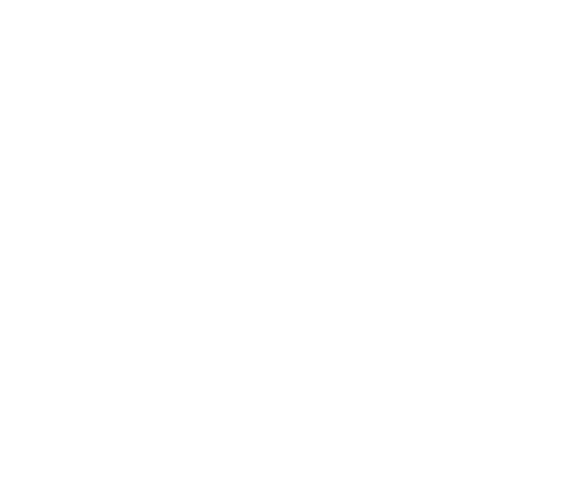

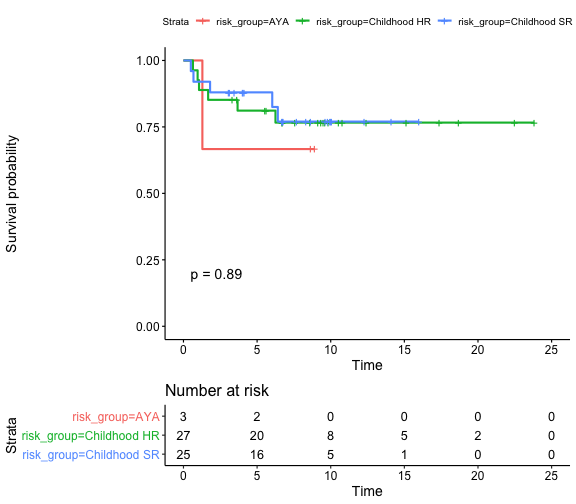

In [1025]:
%%R --units in -h 7 -w 8

ggsurvplot(survfit(Surv(ostime/365.24, oscensor) ~ risk_group, data = dat_bdev_obs %>% filter(disease_timing == 'Initial diagnosis')), pval=T, risk.table = T)


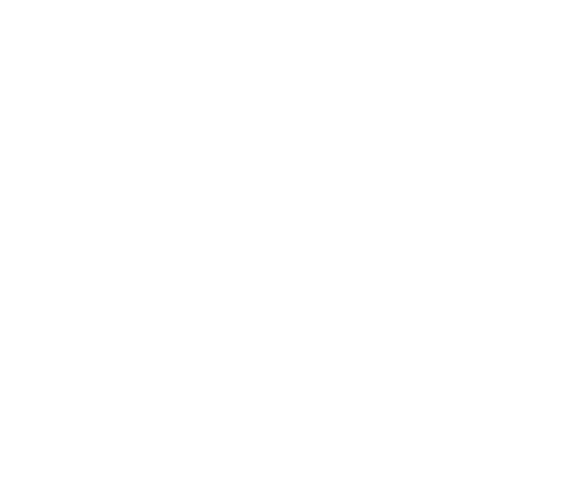

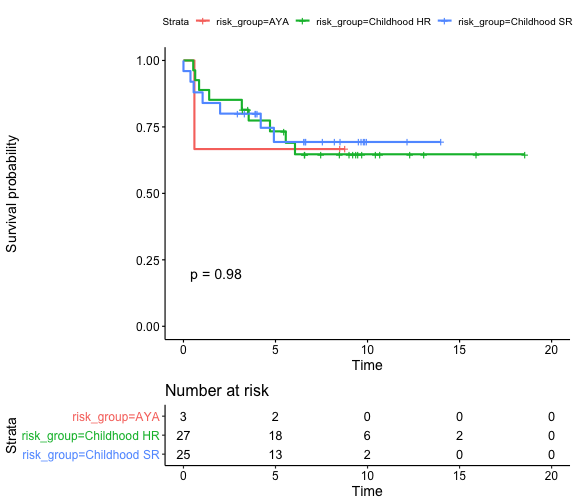

In [1026]:
%%R --units in -h 7 -w 8

ggsurvplot(survfit(Surv(efstime/365.24, efscensor) ~ risk_group, data = dat_bdev_obs %>% filter(disease_timing == 'Initial diagnosis')), pval=T, risk.table = T)


### Composition cluster

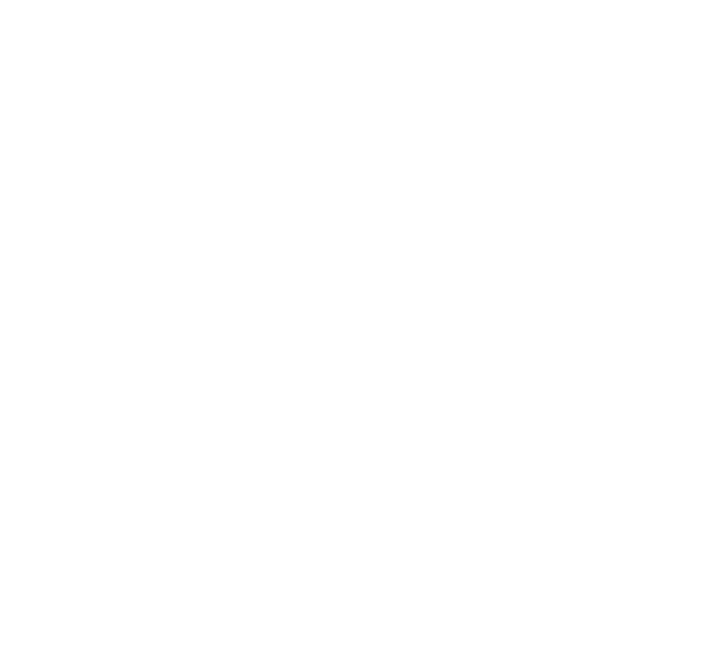

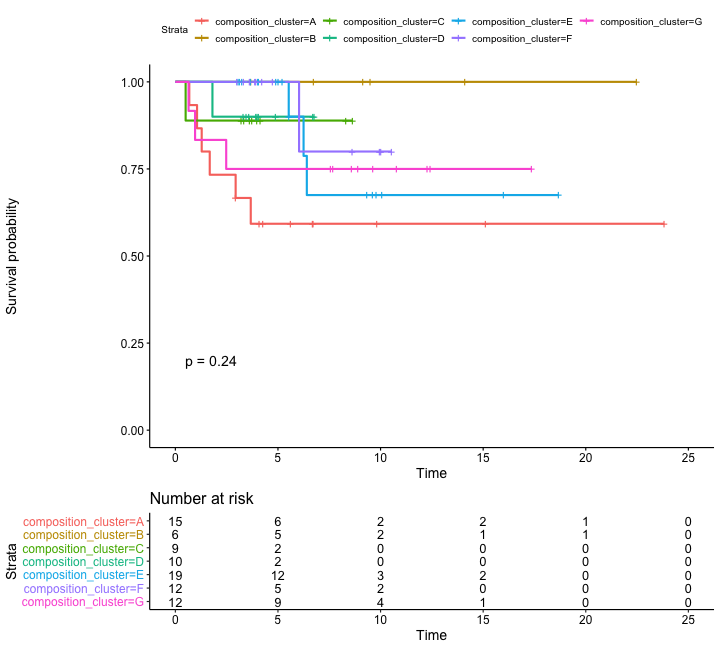

In [1027]:
%%R --units in -h 9 -w 10

ggsurvplot(survfit(Surv(ostime/365.24, oscensor) ~ composition_cluster, data = dat_bdev_obs %>% filter(disease_timing == 'Initial diagnosis')), pval=T, risk.table = T)


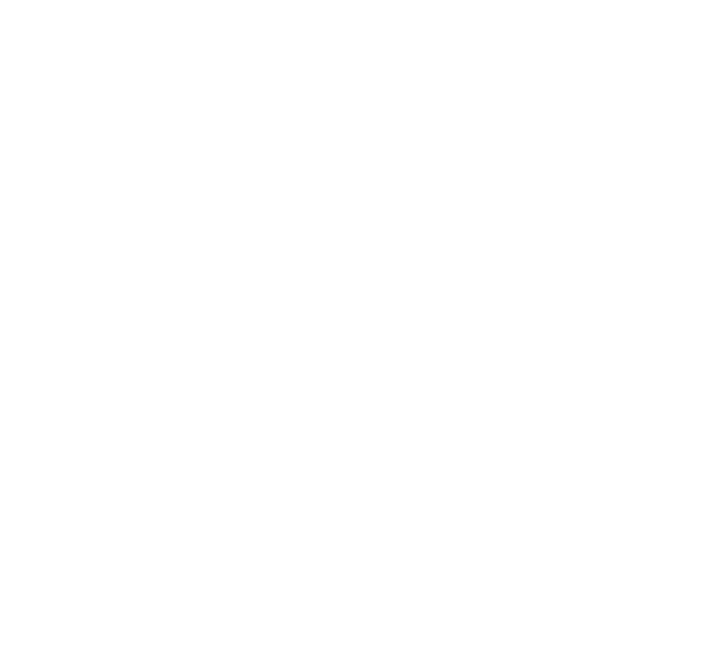

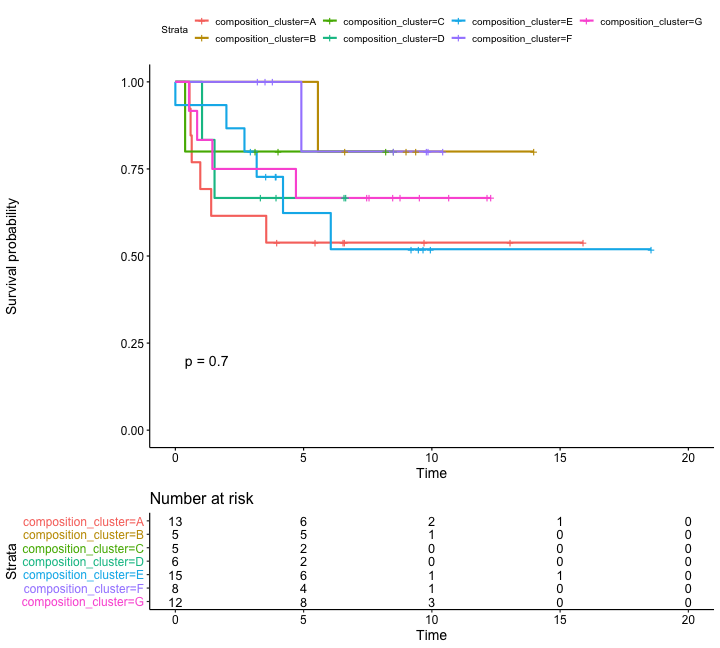

In [1028]:
%%R --units in -h 9 -w 10

ggsurvplot(survfit(Surv(efstime/365.24, efscensor) ~ composition_cluster, data = dat_bdev_obs %>% filter(disease_timing == 'Initial diagnosis')), pval=T, risk.table = T)


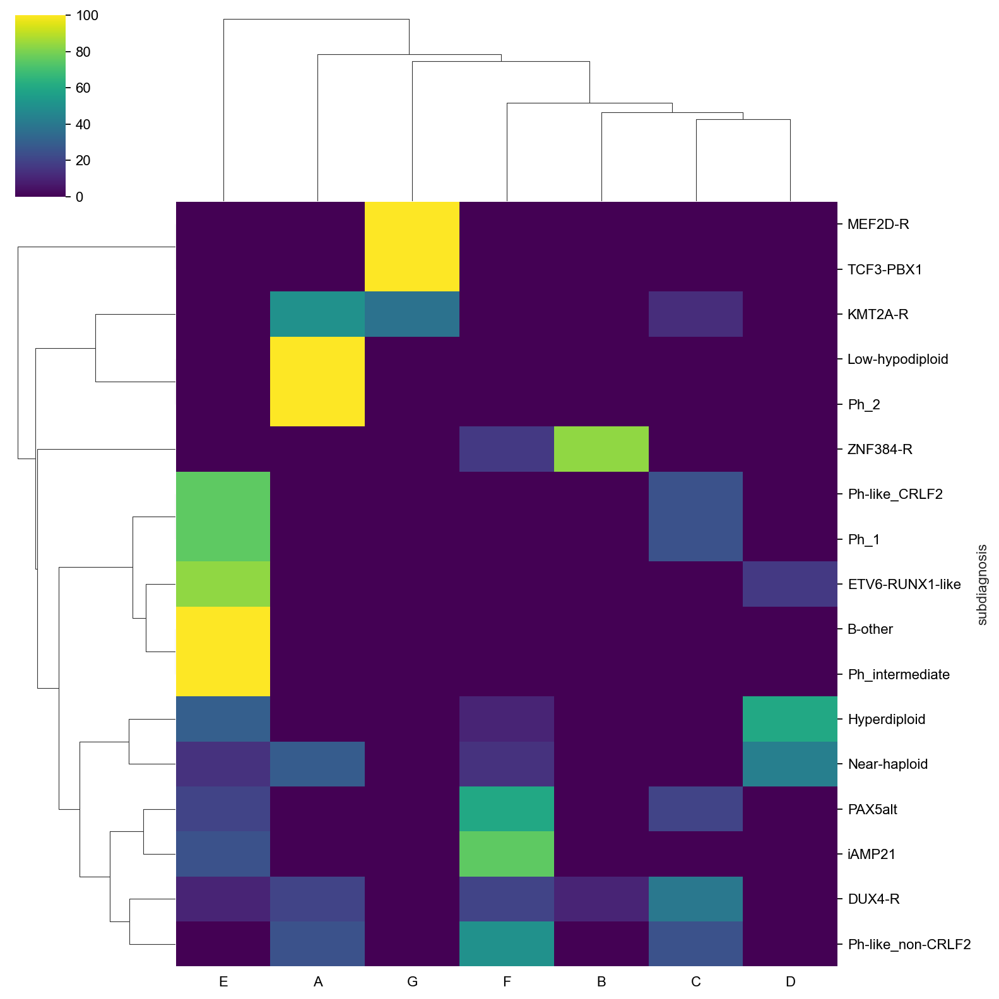

In [1030]:
sc.set_figure_params(fontsize=10)
sns.clustermap(tk.get_obs_prop(dat_bdev, 'subdiagnosis', 'composition_cluster', prop=True).T, cmap='viridis')

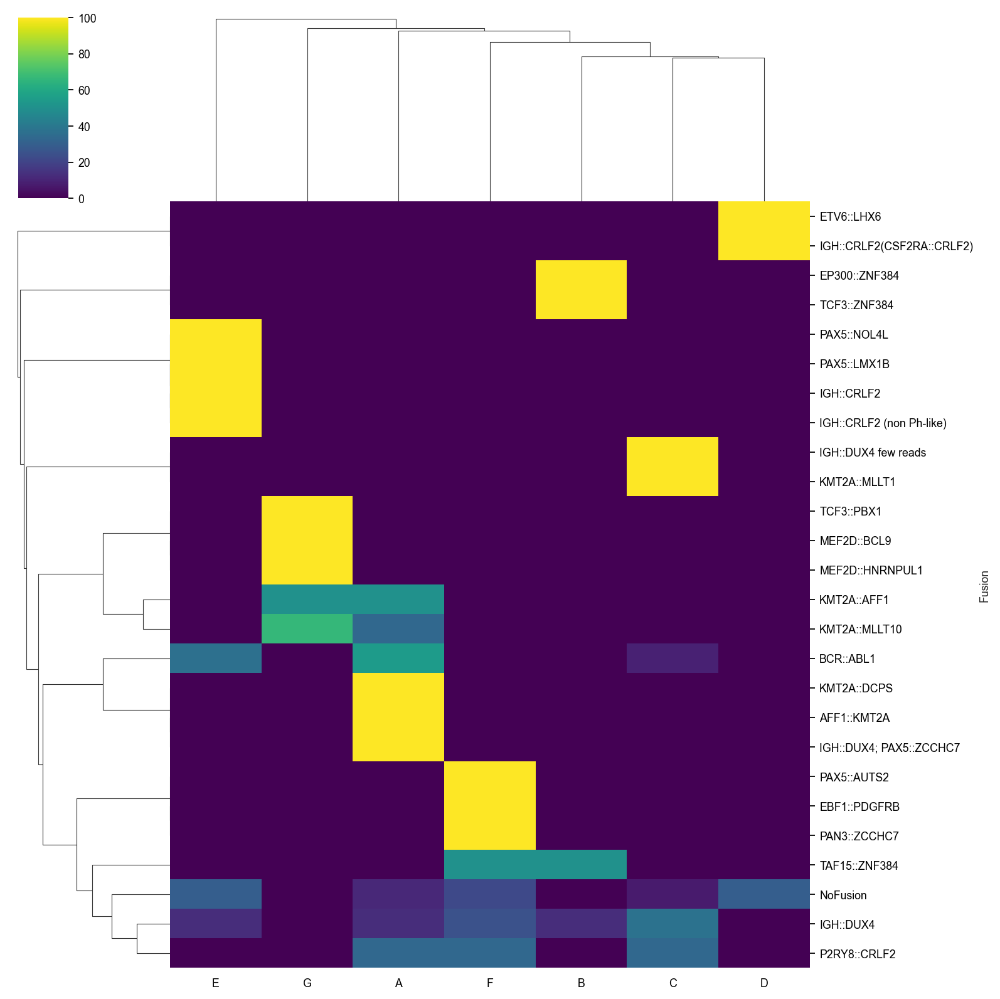

In [1033]:
sc.set_figure_params(fontsize=8)
sns.clustermap(tk.get_obs_prop(dat_bdev, 'Fusion', 'composition_cluster', prop=True).T, cmap='viridis')

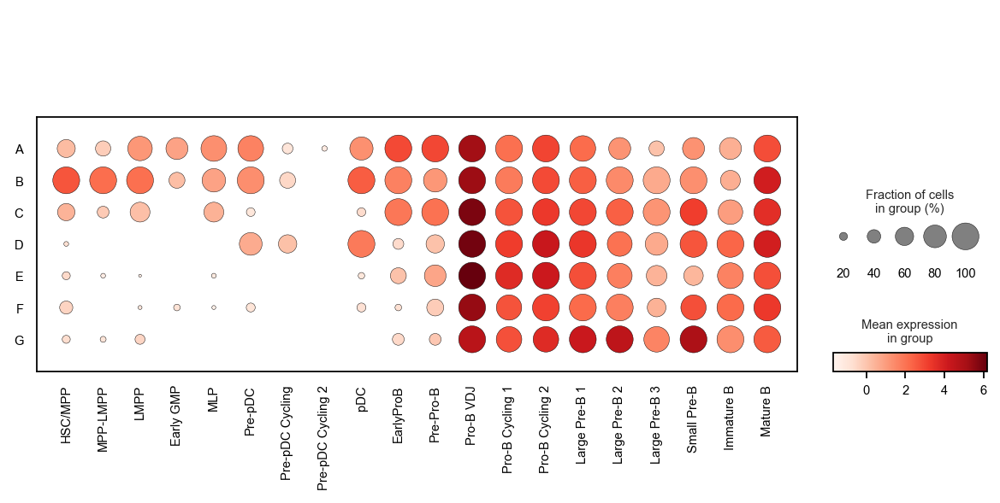

In [1036]:
sc.pl.dotplot(dat_bdev, var_names = focused_BDev_Lineages, groupby = 'composition_cluster', dendrogram=False)

In [1221]:
dat_bdev.write_h5ad('BDevelopment_Composition.h5ad')

In [87]:
dat_bdev.to_df()

,Early GMP,EarlyProB,HSC/MPP,Immature B,Large Pre-B 1,Large Pre-B 2,Large Pre-B 3,LMPP,Mature B,MLP,...,pDC,Pre-pDC,Pre-pDC Cycling,Pre-pDC Cycling 2,Pre-Pro-B,Pre-Pro-B Cycling,Pro-B Cycling 1,Pro-B Cycling 2,Pro-B VDJ,Small Pre-B
SJALL030517_R1,-1.236862,0.660258,-1.236862,1.995259,2.207820,1.535727,0.372576,-1.236862,2.947729,-0.949180,...,-1.202725,-2.335474,-1.202725,-2.335474,0.608965,-1.236862,3.132586,3.767084,6.578210,0.554897
SJALL040053_D1,-1.245772,1.889722,0.600055,2.356096,3.290406,2.886724,1.239135,0.140523,3.616621,0.428205,...,-0.552625,-0.958090,-2.344384,-1.651237,1.904111,0.700138,2.240583,3.261418,5.047031,3.919014
SJALL040066_D1,-2.249052,-1.150440,0.523537,1.488618,4.144539,3.916366,1.334467,0.053533,2.602978,-1.374799,...,-0.169611,-1.555905,-1.374799,-1.374799,-0.457293,-1.150440,3.531692,4.113976,5.741186,5.122437
SJALL040069_D1,0.922392,1.393997,0.842349,0.149202,4.283924,2.576950,-0.067021,0.724566,2.747768,0.149202,...,-0.949410,0.349872,-2.048023,-2.335705,1.463523,0.842349,2.827174,4.590545,4.882472,-0.102113
SJALL040070_D1,-2.064847,-1.552231,-1.371700,0.825524,3.584127,3.872689,0.930885,-1.552231,2.183648,-1.552231,...,-0.678553,-1.552231,-1.552231,-2.064847,-1.552231,-1.552231,2.904966,3.381890,5.352733,5.307271
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SJPHALL007_D,1.559521,5.133738,-0.185718,0.748591,1.154056,-0.185718,-0.504172,2.228571,2.620393,4.479435,...,3.227528,2.563881,-0.018664,-0.637703,4.089684,1.423720,1.367630,2.098518,5.268437,-1.563608
SJPHALL010_D,2.165141,2.403100,1.073964,1.529981,1.199127,0.039890,-1.123261,1.310352,3.356346,0.701288,...,-0.940939,1.004971,-2.430792,-2.039551,2.329896,0.039890,1.598035,1.831649,4.753354,1.179324
SJPHALL020_D,0.025067,2.814185,-0.285088,0.495070,1.229039,-0.198077,0.312749,0.261455,3.069589,1.324350,...,1.816826,0.495070,-1.073546,-1.584371,3.471874,0.954603,2.353969,2.763754,6.037313,0.751004
SJPHALL020_R,-1.071873,3.108649,-0.196405,-0.484087,1.923859,0.263128,-0.283416,-0.116362,3.917198,0.815196,...,0.752676,-0.283416,-1.582699,-1.295017,3.874046,1.523381,1.972649,3.058482,5.544995,0.314421


## NMF

In [88]:
from sklearn import metrics, decomposition

def ncomponents_NMF(adata):
    def get_score(model, data, scorer=metrics.explained_variance_score):
        prediction = model.inverse_transform(model.transform(data))
        return scorer(data, prediction)

    ks = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40]
    perform = []
    for k in ks:
        nmf = decomposition.NMF(n_components=k).fit(adata.X.T)
        perform.append(1-get_score(nmf, adata.X.T))
    print(perform)

    plt.figure(figsize=[10, 6])
    sns.lineplot(x = ks, y = perform)
    plt.title("Unexplained Variance at K Factors (NMF)")
    plt.figure(figsize=[6, 4])


In [89]:
def do_NMF(dat, n_comp):
    adata = dat.copy()
    
    # Run NMF
    model = decomposition.NMF(n_components = n_comp)
    model.fit(adata.X.T)
    nmf_features = model.transform(adata.X.T)
    
    # Get column names
    columns=[]
    for i in range(1,n_comp+1):
        columns.append("NMF"+str(i))

    # Get NMF results
    NMF_var = pd.DataFrame(nmf_features, index=adata.var_names, columns=columns)
    NMF_obs = pd.DataFrame(np.dot(nmf_features.T, adata.X.T).T, index=adata.obs_names, columns=columns)
    # Add to object
    adata.var = adata.var.merge(NMF_var, how='left', left_index=True, right_index=True)
    adata.obs = adata.obs.merge(NMF_obs, how='left', left_index=True, right_index=True)
    
    return(adata)

In [90]:
dat_NMF = dat.copy()
dat_NMF.var = dat_NMF.var[[]]

In [91]:
# Shift values linearly up
dat_NMF.X = dat_NMF.X + np.abs(dat_NMF.X.min())

/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,
/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 rea

[0.33495306508575584, 0.2507212820049184, 0.2107430365905717, 0.17923669624983518, 0.15139428923249798, 0.13086874339647625, 0.11440284076351426, 0.09851605627969628, 0.08783348906864552, 0.07715181337343835, 0.07126825106277468, 0.06554354391650064, 0.06068459509114443, 0.05662655165556929, 0.05261233154603606, 0.049126218458205084, 0.045645178856110635, 0.042270622921436574, 0.03921888258718631, 0.036061600238672, 0.033599068869049176, 0.03151919031949746, 0.028994421381890678, 0.026516321285212974, 0.0244130459118449, 0.0225976019329156, 0.02053111437170696, 0.018983062534086326, 0.017533902816842528, 0.015887919602767142, 0.014503608662472023, 0.013576029938778489, 0.012436533538416783, 0.010928174343894481, 0.010032083790871393, 0.009275813159131618, 0.008521733124188358, 0.0075915700879942705, 0.006646133724672265, 0.006132693907717757]


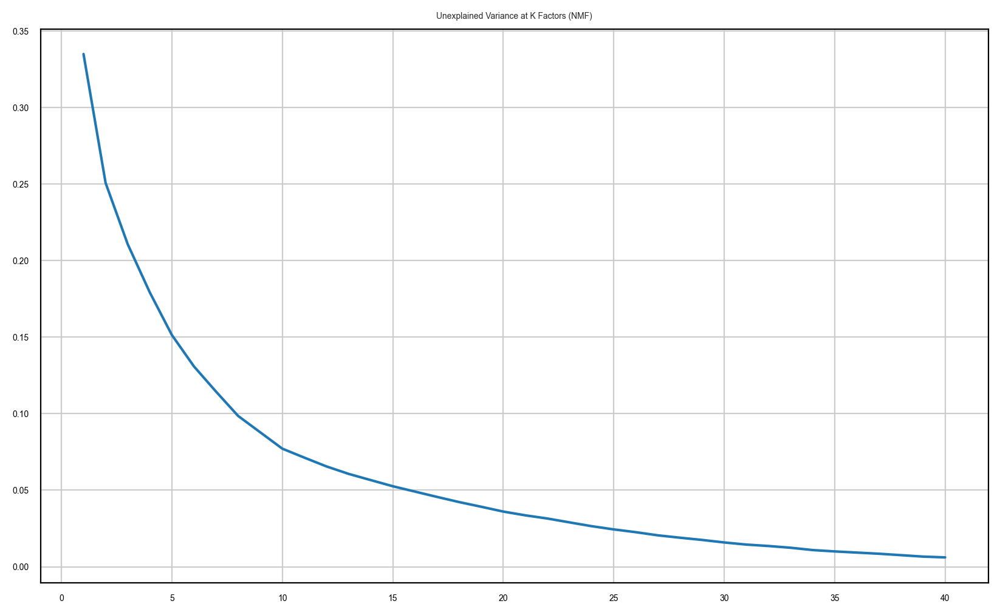

<Figure size 600x400 with 0 Axes>

In [92]:
import matplotlib.pyplot as plt 
sc.settings.set_figure_params(dpi=100, fontsize=5, dpi_save=200, figsize=(6,4), format='png')
ncomponents_NMF(dat_NMF)

/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,


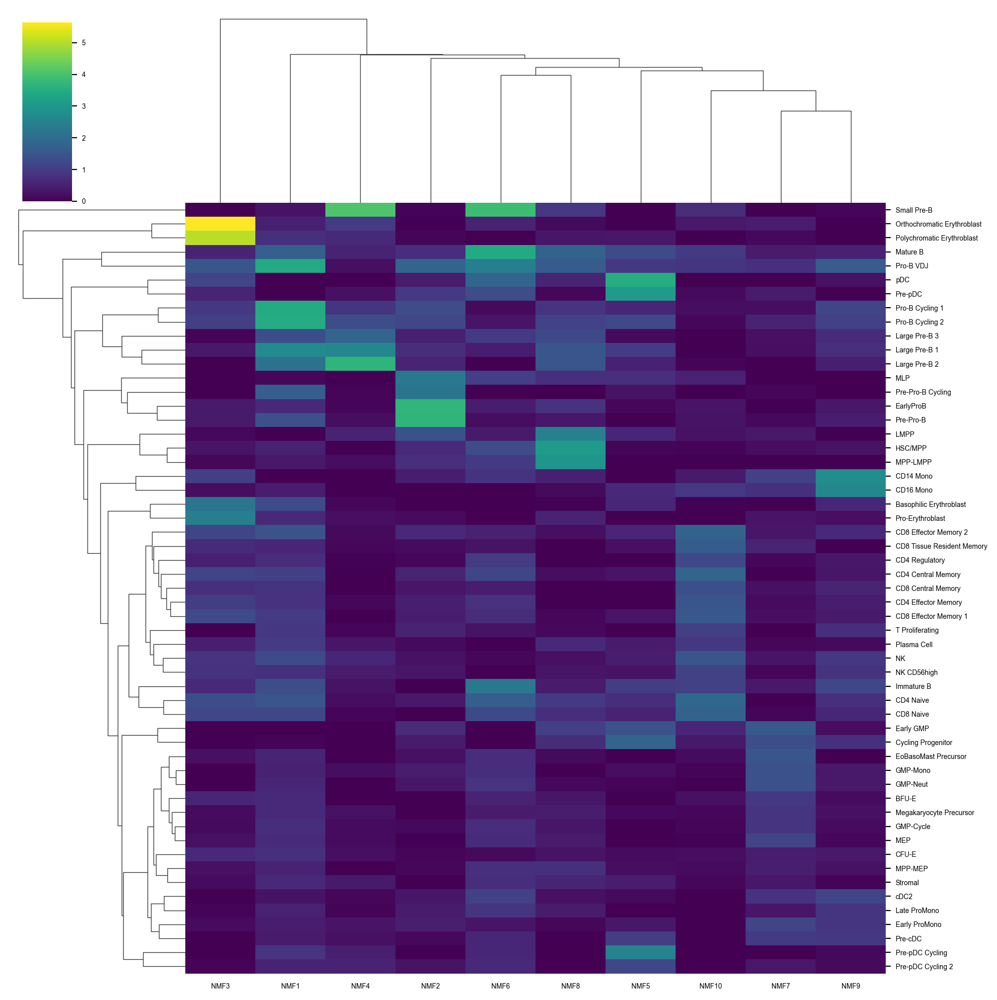

In [93]:
dat_NMF = do_NMF(dat_NMF, 10)
#dat.X = dat.X - 3.5
sns.clustermap(dat_NMF.var, cmap='viridis')

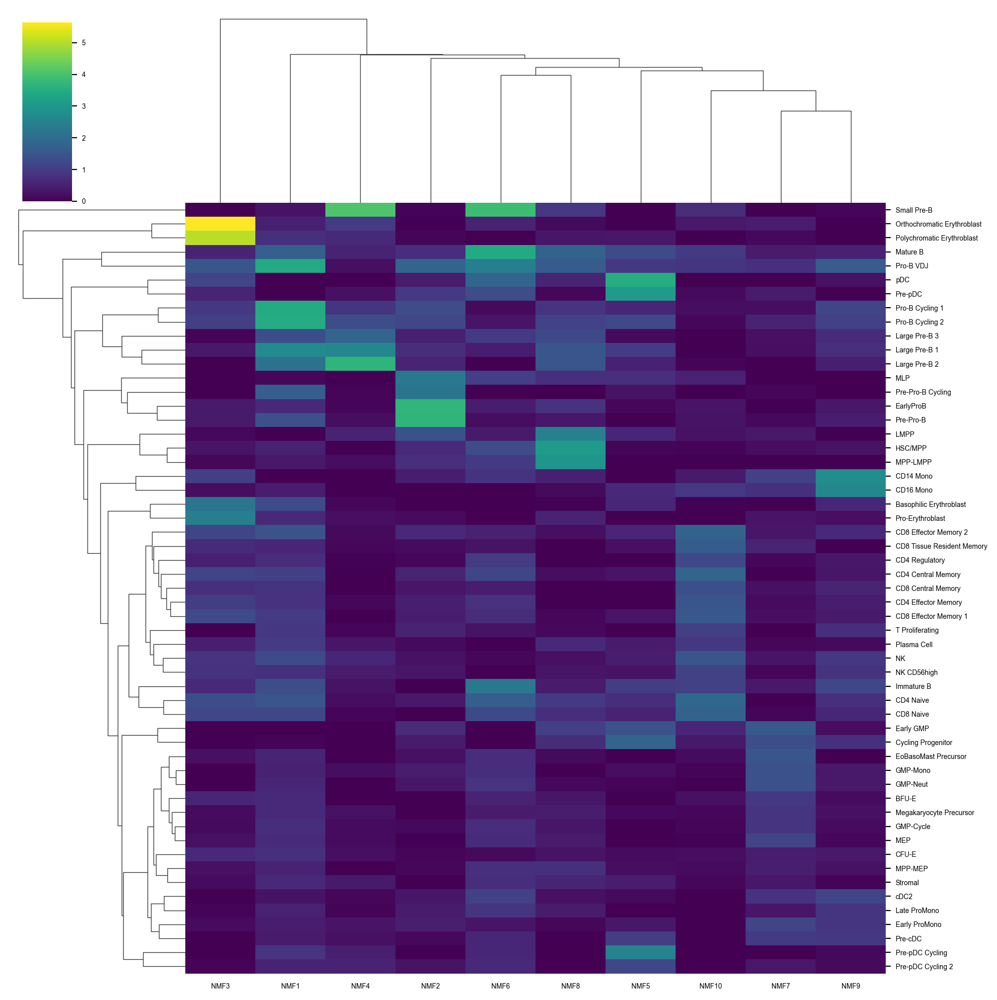

In [94]:
sns.clustermap(dat_NMF.var, cmap='viridis')

In [130]:
dat_NMF.var.loc[['HSC/MPP', 'MPP-LMPP', 'LMPP', 'Pre-pDC', 'pDC', 
                 'MLP', 'EarlyProB', 'Pre-Pro-B', 
                 'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                 'Large Pre-B 1', 'Large Pre-B 2', 'Small Pre-B',
                 'Early GMP', 'EoBasoMast Precursor', 'GMP-Neut', 'GMP-Mono', 'Cycling Progenitor', 'MEP', 'Early ProMono',
                 'CD14 Mono', 'CD16 Mono', 
                 'Orthochromatic Erythroblast', 'Polychromatic Erythroblast', 'Basophilic Erythroblast', 'Pro-Erythroblast',
                 'CD4 Naive', 'CD8 Naive', 'CD4 Central Memory', 'CD8 Effector Memory 2', 'CD8 Tissue Resident Memory', 'CD8 Effector Memory 1', 
                 'CD4 Effector Memory', 'CD4 Regulatory', 'NK'], 
                ['NMF8', 'NMF5', 'NMF2', 'NMF1', 'NMF4', 'NMF7', 'NMF9', 'NMF3', 'NMF10']].style.background_gradient()

,NMF8,NMF5,NMF2,NMF1,NMF4,NMF7,NMF9,NMF3,NMF10
HSC/MPP,3.085712,0.079671,0.635979,0.526759,0.000000,0.182759,0.273496,0.295993,0.050904
MPP-LMPP,2.942133,0.000000,0.757318,0.371115,0.195288,0.006457,0.000000,0.096994,0.000000
LMPP,2.440806,0.602764,1.400284,0.000000,0.535546,0.365320,0.000000,0.119443,0.251212
Pre-pDC,0.098066,3.074206,0.929872,0.000000,0.221490,0.400888,0.000000,0.559170,0.142821
pDC,0.558242,3.479952,0.415795,0.000000,0.000000,0.000000,0.259393,1.135844,0.000000
MLP,0.749856,0.754904,2.258815,0.093152,0.000000,0.011524,0.000000,0.000000,0.517276
EarlyProB,0.804366,0.104669,3.687239,0.650790,0.087767,0.000000,0.340589,0.379556,0.287417
Pre-Pro-B,0.346648,0.000000,3.670891,1.385456,0.177079,0.120720,0.448123,0.382662,0.264321
Pro-B VDJ,1.625116,0.914542,1.787039,3.412235,0.206122,0.791209,1.637871,1.505905,0.876315
Pro-B Cycling 1,0.874504,0.602635,1.282570,3.455255,0.871152,0.194760,1.162618,0.921372,0.185249


In [126]:
dat_NMF.var.loc[['HSC/MPP', 'MPP-MEP', 'MPP-LMPP', 'LMPP', 'Pre-pDC', 'pDC', 'Pre-pDC Cycling', 'Pre-pDC Cycling 2',
                 'MLP', 'EarlyProB', 'Pre-Pro-B', 'Pre-Pro-B Cycling', 'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                 'Large Pre-B 1', 'Large Pre-B 2', 'Large Pre-B 3', 'Small Pre-B', 'Immature B', 'Mature B', 
                 'MEP', 'Megakaryocyte Precursor', 'EoBasoMast Precursor', 'BFU-E', 'CFU-E', 
                 'Pro-Erythroblast', 'Basophilic Erythroblast', 'Polychromatic Erythroblast', 'Orthochromatic Erythroblast',
                 'Cycling Progenitor', 'GMP-Cycle', 'Early GMP', 'GMP-Mono', 'GMP-Neut', 'Early ProMono', 'Late ProMono', 
                 'Pre-cDC', 'cDC2', 'CD14 Mono', 'CD16 Mono',
                 'CD4 Naive', 'CD8 Naive', 'CD4 Central Memory', 'CD4 Effector Memory', 'CD4 Regulatory', 
                 'CD8 Central Memory', 'CD8 Tissue Resident Memory', 'CD8 Effector Memory 1', 'CD8 Effector Memory 2', 
                 'T Proliferating', 'NK', 'NK CD56high', 'Plasma Cell', 'Stromal'], 
                ['NMF8', 'NMF5', 'NMF2', 'NMF1', 'NMF4', 'NMF6', 'NMF7', 'NMF3', 'NMF9', 'NMF10']].style.background_gradient()

,NMF8,NMF5,NMF2,NMF1,NMF4,NMF6,NMF7,NMF3,NMF9,NMF10
HSC/MPP,3.085712,0.079671,0.635979,0.526759,0.000000,1.296772,0.182759,0.295993,0.273496,0.050904
MPP-MEP,0.788258,0.178347,0.091551,0.536935,0.007927,0.766867,0.475561,0.224615,0.247092,0.157706
MPP-LMPP,2.942133,0.000000,0.757318,0.371115,0.195288,0.948213,0.006457,0.096994,0.000000,0.000000
LMPP,2.440806,0.602764,1.400284,0.000000,0.535546,0.375053,0.365320,0.119443,0.000000,0.251212
Pre-pDC,0.098066,3.074206,0.929872,0.000000,0.221490,1.287161,0.400888,0.559170,0.000000,0.142821
pDC,0.558242,3.479952,0.415795,0.000000,0.000000,1.820211,0.000000,1.135844,0.259393,0.000000
Pre-pDC Cycling,0.000000,2.485866,0.000000,0.845337,0.467773,0.603331,0.000000,0.000000,0.129097,0.000000
Pre-pDC Cycling 2,0.000000,1.190318,0.264583,0.539725,0.548461,0.635431,0.336484,0.054278,0.149429,0.006255
MLP,0.749856,0.754904,2.258815,0.093152,0.000000,1.026552,0.011524,0.000000,0.000000,0.517276
EarlyProB,0.804366,0.104669,3.687239,0.650790,0.087767,0.456875,0.000000,0.379556,0.340589,0.287417


In [105]:
from jenkspy import jenks_breaks 
bins = 3
NMFvar = ['NMF8', 'NMF5', 'NMF2', 'NMF1', 'NMF4', 'NMF6', 'NMF7', 'NMF3', 'NMF9', 'NMF10']

for NMF in NMFvar:
    print(NMF)
    
    celltypes = dat_NMF.var[dat_NMF.var[NMF] > jenks_breaks(dat_NMF.var[NMF], bins)[bins-1]].index.values
    print(celltypes)
    print(dat_NMF.to_df()[celltypes].sum(axis=1).corr(dat_NMF.obs[NMF]))

NMF8
['HSC/MPP' 'LMPP' 'MPP-LMPP']
0.8745390214204649
NMF5
['pDC' 'Pre-pDC' 'Pre-pDC Cycling']
0.9696702356076806
NMF2
['EarlyProB' 'Pre-Pro-B']
0.9597830873688236
NMF1
['Large Pre-B 1' 'Pro-B Cycling 1' 'Pro-B Cycling 2' 'Pro-B VDJ']
0.9037914703335517
NMF4
['Large Pre-B 1' 'Large Pre-B 2' 'Small Pre-B']
0.9805185351311397
NMF6
['Immature B' 'Mature B' 'Pro-B VDJ' 'Small Pre-B']
0.8566262617104282
NMF7
['Early GMP' 'Pro-B VDJ' 'BFU-E' 'CD14 Mono' 'CD16 Mono' 'cDC2'
 'Cycling Progenitor' 'Early ProMono' 'EoBasoMast Precursor' 'GMP-Cycle'
 'GMP-Mono' 'GMP-Neut' 'Megakaryocyte Precursor' 'MEP' 'Pre-cDC']
0.9798837820017317
NMF3
['Orthochromatic Erythroblast' 'Polychromatic Erythroblast']
0.9490750878719068
NMF9
['CD14 Mono' 'CD16 Mono']
0.7637732132911723
NMF10
['CD4 Central Memory' 'CD4 Effector Memory' 'CD4 Naive'
 'CD8 Central Memory' 'CD8 Effector Memory 1' 'CD8 Effector Memory 2'
 'CD8 Naive' 'CD8 Tissue Resident Memory' 'NK']
0.9734328810493943


In [1045]:
from jenkspy import jenks_breaks 
bins = 5
NMFvar = ['NMF8', 'NMF5', 'NMF2', 'NMF1', 'NMF4', 'NMF6', 'NMF7', 'NMF3', 'NMF9', 'NMF10']

for NMF in NMFvar:
    print(NMF)
    
    celltypes = dat_NMF.var[dat_NMF.var[NMF] > jenks_breaks(dat_NMF.var[NMF], bins)[bins-1]].index.values
    print(celltypes)
    print(dat_NMF.to_df()[celltypes].sum(axis=1).corr(dat_NMF.obs[NMF]))

NMF8
['HSC/MPP' 'LMPP' 'MPP-LMPP']
0.8743445740259926
NMF5
['pDC' 'Pre-pDC']
0.9401136598884416
NMF2
['EarlyProB' 'Pre-Pro-B']
0.9597741898758257
NMF1
['Pro-B Cycling 1' 'Pro-B Cycling 2' 'Pro-B VDJ']
0.8585538490944009
NMF4
['Large Pre-B 2' 'Small Pre-B']
0.9572298724038352
NMF6
['Mature B' 'Small Pre-B']
0.8349182159874382
NMF7
['Early GMP' 'Cycling Progenitor' 'EoBasoMast Precursor' 'GMP-Mono'
 'GMP-Neut']
0.8963274093257326
NMF3
['Orthochromatic Erythroblast' 'Polychromatic Erythroblast']
0.9490667481586026
NMF9
['CD14 Mono' 'CD16 Mono']
0.7635498532169012
NMF10
['CD4 Central Memory' 'CD4 Naive' 'CD8 Effector Memory 2' 'CD8 Naive'
 'CD8 Tissue Resident Memory']
0.9467390282156122


In [101]:
dat_NMF.var.loc[['HSC/MPP', 'MPP-LMPP', 'LMPP', 
                 'Pre-pDC', 'pDC', 
                 'EarlyProB', 'Pre-Pro-B',
                 'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2', 
                 'Large Pre-B 2', 'Small Pre-B', 
                 'Early GMP', 'Cycling Progenitor', 'EoBasoMast Precursor', 'GMP-Neut', 'GMP-Mono',
                 'CD14 Mono', 'CD16 Mono',
                 'Orthochromatic Erythroblast', 'Polychromatic Erythroblast',
                 'CD4 Naive', 'CD8 Naive', 'CD4 Central Memory', 'CD8 Tissue Resident Memory', 'CD8 Effector Memory 2'], 
                ['NMF8', 'NMF5', 'NMF2', 'NMF1', 'NMF4', 'NMF7',  'NMF9', 'NMF3', 'NMF10']].style.background_gradient()

,NMF8,NMF5,NMF2,NMF1,NMF4,NMF7,NMF9,NMF3,NMF10
HSC/MPP,3.085712,0.079671,0.635979,0.526759,0.000000,0.182759,0.273496,0.295993,0.050904
MPP-LMPP,2.942133,0.000000,0.757318,0.371115,0.195288,0.006457,0.000000,0.096994,0.000000
LMPP,2.440806,0.602764,1.400284,0.000000,0.535546,0.365320,0.000000,0.119443,0.251212
Pre-pDC,0.098066,3.074206,0.929872,0.000000,0.221490,0.400888,0.000000,0.559170,0.142821
pDC,0.558242,3.479952,0.415795,0.000000,0.000000,0.000000,0.259393,1.135844,0.000000
EarlyProB,0.804366,0.104669,3.687239,0.650790,0.087767,0.000000,0.340589,0.379556,0.287417
Pre-Pro-B,0.346648,0.000000,3.670891,1.385456,0.177079,0.120720,0.448123,0.382662,0.264321
Pro-B VDJ,1.625116,0.914542,1.787039,3.412235,0.206122,0.791209,1.637871,1.505905,0.876315
Pro-B Cycling 1,0.874504,0.602635,1.282570,3.455255,0.871152,0.194760,1.162618,0.921372,0.185249
Pro-B Cycling 2,1.114026,1.215788,1.168276,3.473697,1.306507,0.533578,1.073144,1.035643,0.093069


/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  """Entry point for launching an IPython kernel.


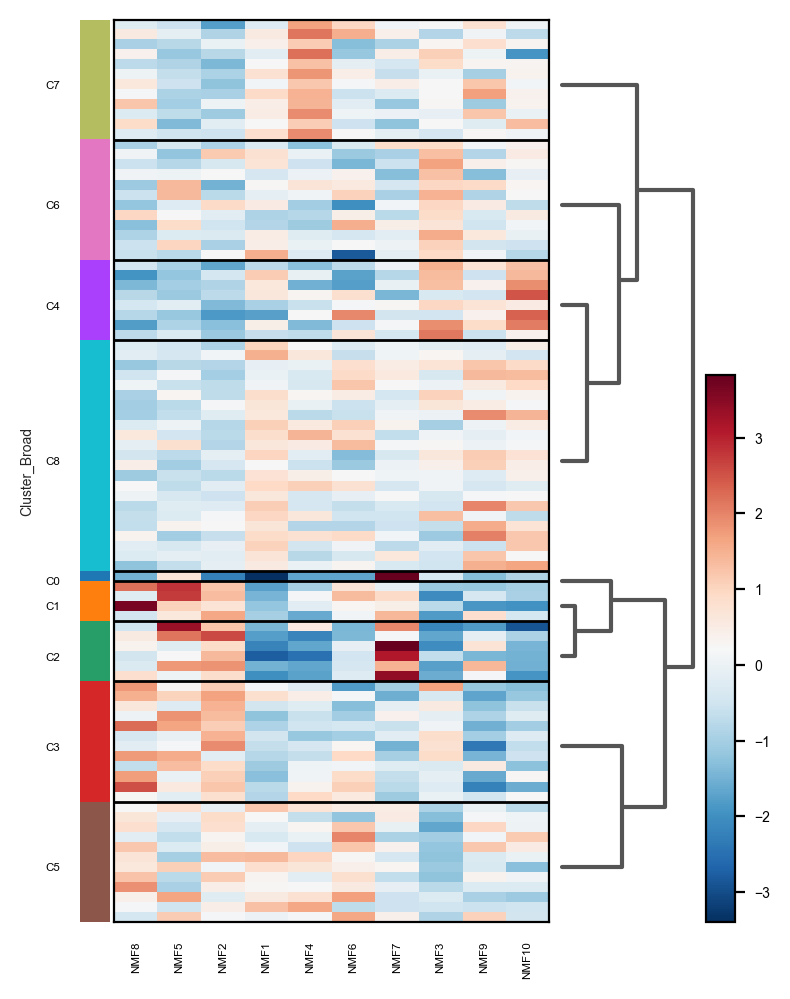

In [95]:
temp = sc.AnnData(dat_NMF.obs.filter(regex='NMF'), obs = dat.obs)
sc.pp.scale(temp)
sc.pl.heatmap(temp, 
              var_names = ['NMF8', 'NMF5', 'NMF2', 'NMF1', 'NMF4', 'NMF6', 'NMF7', 'NMF3', 'NMF9', 'NMF10'], 
              groupby='Cluster_Broad', dendrogram=True, cmap='RdBu_r')

In [1055]:
bins = 5
NMFvar = ['NMF8', 'NMF5', 'NMF2', 'NMF1', 'NMF4', 'NMF6', 'NMF7', 'NMF3', 'NMF9', 'NMF10']

for NMF in NMFvar:    
    celltypes = dat_NMF.var[dat_NMF.var[NMF] > jenks_breaks(dat_NMF.var[NMF], bins)[bins-1]].index.values
    dat.obs[NMF+'_prop'] = dat.to_df()[celltypes].sum(axis=1)

In [1056]:
dat.obs['MLP_prop'] = dat.to_df()['MLP']
dat.obs['MLPEarlyProBPreProB_prop'] = dat.to_df()['MLP'] + dat.to_df()['EarlyProB'] + dat.to_df()['Pre-Pro-B']

In [1057]:
dat_NMF_obs = dat.obs[['subdiagnosis', 'NMF1_prop', 'NMF2_prop', 'NMF3_prop', 'NMF4_prop', 'NMF5_prop', 
                           'NMF6_prop', 'NMF7_prop', 'NMF8_prop', 'NMF9_prop', 'NMF10_prop', 'MLP_prop', 'MLPEarlyProBPreProB_prop']]
dat_NMF_obs

,subdiagnosis,NMF1_prop,NMF2_prop,NMF3_prop,NMF4_prop,NMF5_prop,NMF6_prop,NMF7_prop,NMF8_prop,NMF9_prop,NMF10_prop,MLP_prop,MLPEarlyProBPreProB_prop
SJALL030517_R1,ETV6-RUNX1-like,13.477880,1.269222,0.108175,2.090624,-3.538199,3.502627,-5.794216,-4.116051,3.294597,7.556949,-0.949180,0.320042
SJALL040053_D1,DUX4-R,10.549032,3.793833,-4.055240,6.805739,-1.510714,7.535635,-6.192492,0.342103,1.300193,3.234250,0.428205,4.222038
SJALL040066_D1,TCF3-PBX1,13.386854,-1.607732,1.716504,9.038803,-1.725515,7.725415,-8.803608,-0.062544,-1.607732,5.411603,-1.374799,-2.982532
SJALL040069_D1,Near-haploid,12.300191,2.857519,-4.383728,2.474837,-0.599538,2.645655,-2.240948,1.223640,-0.272854,5.377422,0.149202,3.006721
SJALL040070_D1,TCF3-PBX1,11.639589,-3.104461,5.072815,9.179959,-2.230784,7.490918,-7.507244,-3.890166,1.268468,3.747338,-1.552231,-4.656692
...,...,...,...,...,...,...,...,...,...,...,...,...,...
SJPHALL007_D,Ph,8.734585,9.223422,-3.454074,-1.749326,5.791409,1.056785,-2.364757,2.454972,2.441644,-0.166097,4.479435,13.702857
SJPHALL010_D,Ph,8.183038,4.732996,-3.268173,1.219214,0.064031,4.535670,5.348159,2.909714,4.177245,-1.731437,0.701288,5.434284
SJPHALL020_D,Ph,11.155036,6.286059,-4.672820,0.552927,2.311896,3.820593,0.501026,-0.914857,1.743912,0.371699,1.324350,7.610409
SJPHALL020_R,Ph,10.576126,6.982695,5.094233,0.577549,0.469260,4.231619,-4.358146,-0.914636,-0.757452,3.176725,0.815196,7.797891


R[write to console]: Picking joint bandwidth of 1.33



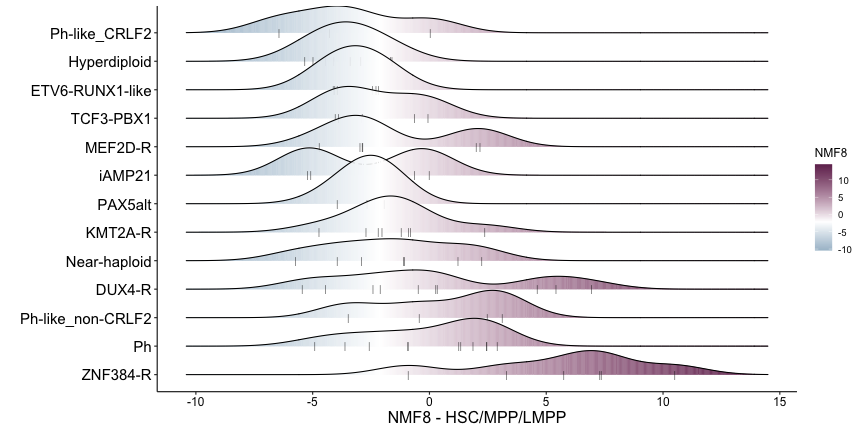

In [1058]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)
library(tidyverse)

NMF = 'NMF8'
name = 'HSC/MPP/LMPP'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 1.06



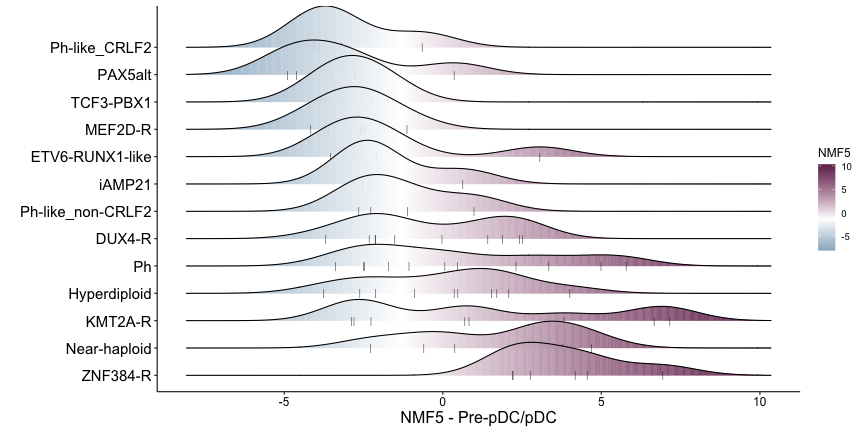

In [1059]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF5'
name = 'Pre-pDC/pDC'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 1.27



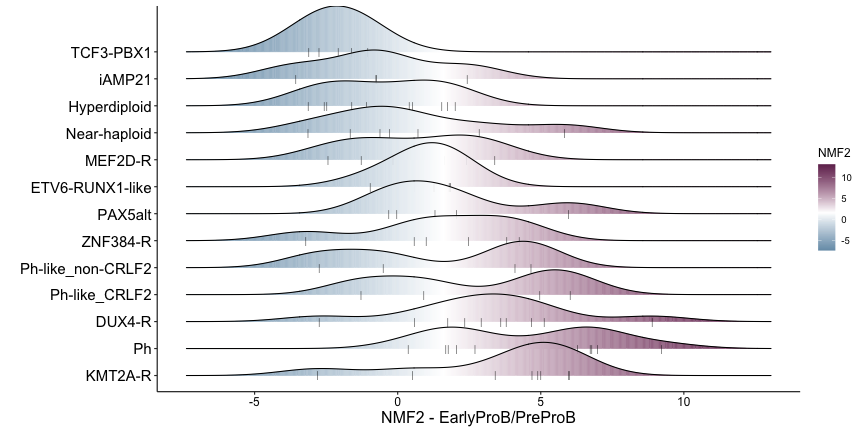

In [1060]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF2'
name = 'EarlyProB/PreProB'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 0.872



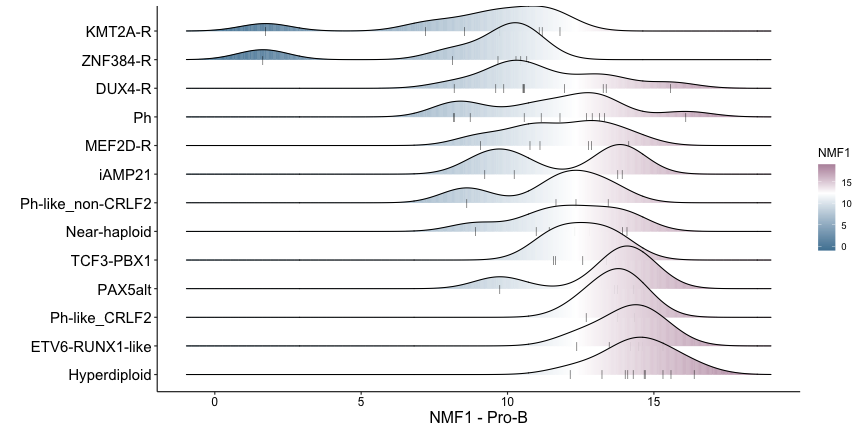

In [1061]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF1'
name = 'Pro-B'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 0.747



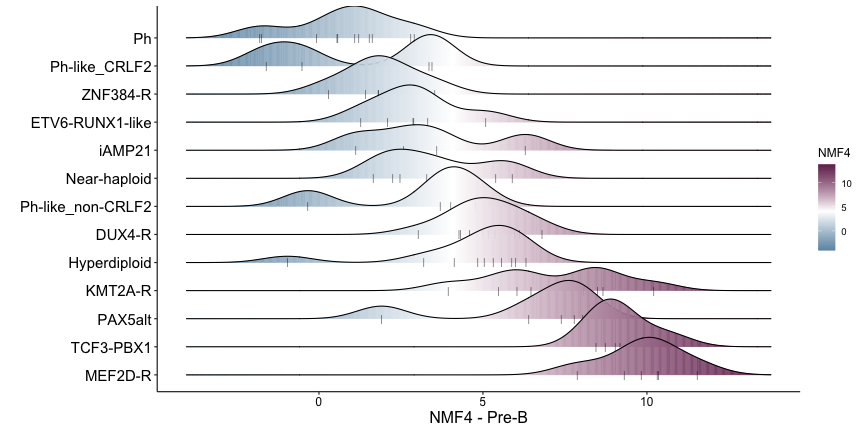

In [1062]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF4'
name = 'Pre-B'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 0.77



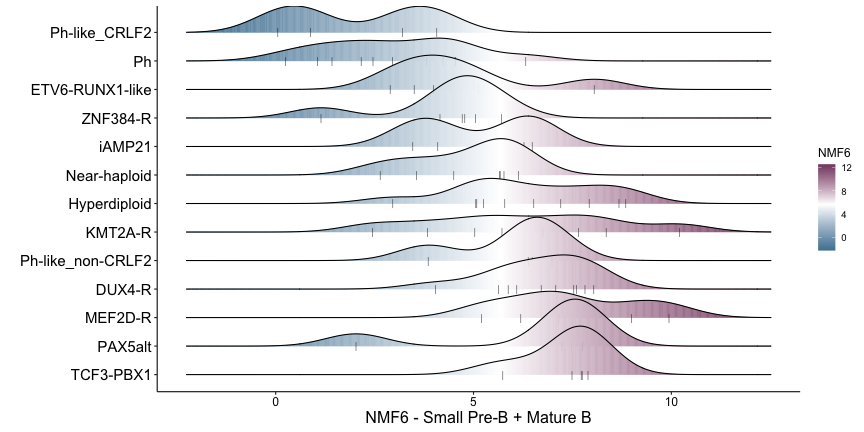

In [1063]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF6'
name = 'Small Pre-B + Mature B'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 1.3



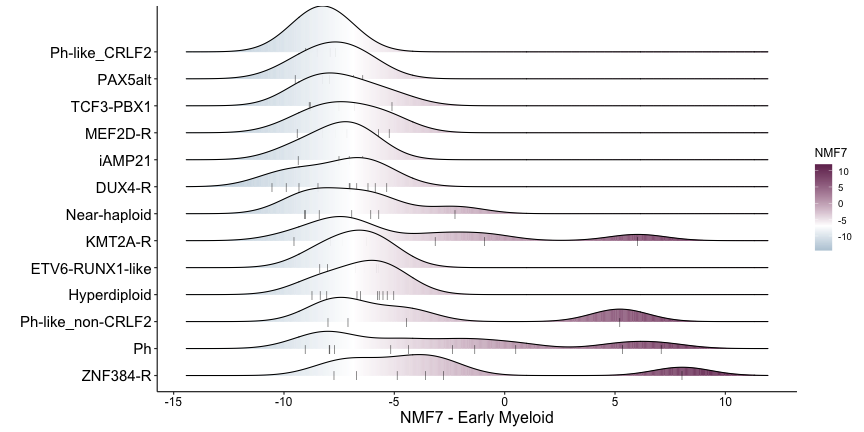

In [1064]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF7'
name = 'Early Myeloid'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 1.39



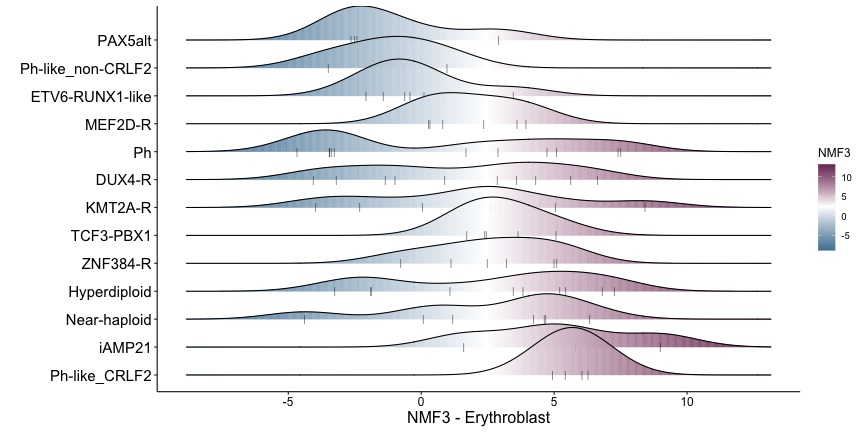

In [1065]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF3'
name = 'Erythroblast'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 0.973



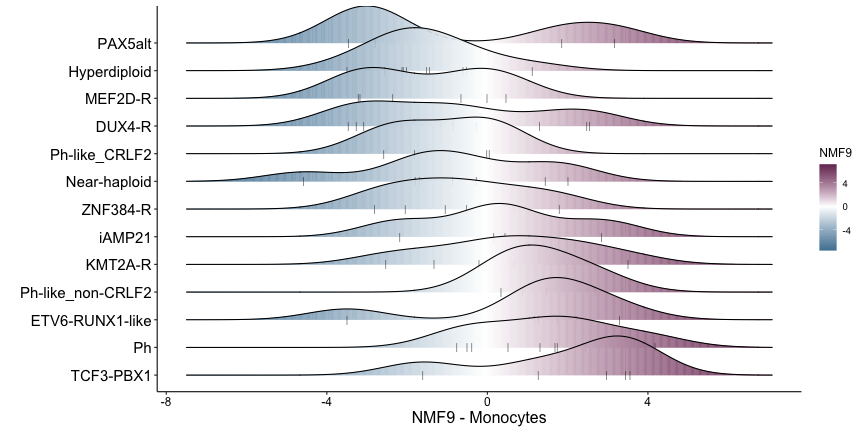

In [1066]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF9'
name = 'Monocytes'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 1.6



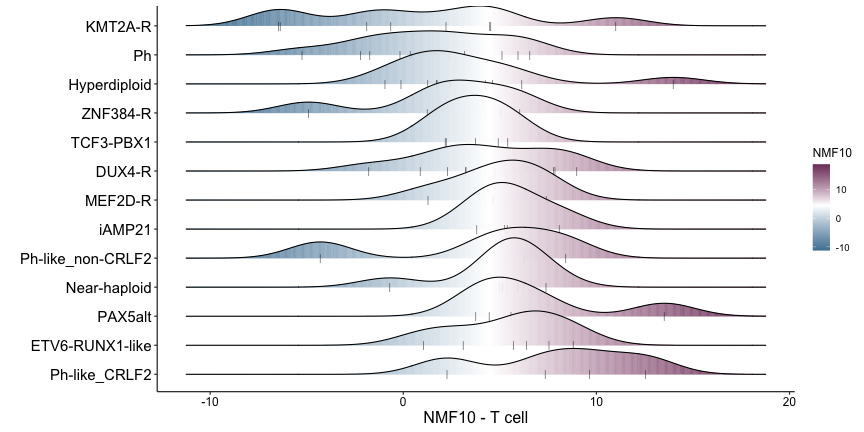

In [1067]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF10'
name = 'T cell'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(paste0(NMF, '_prop'))) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

## Actual NMF Signature

In [1068]:
dat_NMF_obs = dat_NMF.obs[['subdiagnosis', 'NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10']]
dat_NMF_obs

,subdiagnosis,NMF1,NMF2,NMF3,NMF4,NMF5,NMF6,NMF7,NMF8,NMF9,NMF10
SJALL030517_R1,ETV6-RUNX1-like,233.613074,126.963767,157.910807,102.474287,104.171061,162.459376,73.172022,126.618835,129.395025,127.639580
SJALL040053_D1,DUX4-R,222.275707,144.643625,119.537852,119.860423,107.728340,180.485242,72.252650,145.406825,122.077553,110.474698
SJALL040066_D1,TCF3-PBX1,237.467608,117.943706,160.210200,138.848581,106.887211,176.092713,67.821933,143.114528,113.464512,111.615246
SJALL040069_D1,Near-haploid,227.930982,145.420581,127.323062,104.629282,111.861358,156.100448,76.229701,143.869124,115.884959,110.962936
SJALL040070_D1,TCF3-PBX1,227.462206,106.895995,178.891330,136.026121,101.703835,167.194963,69.958330,129.557605,116.907728,114.114532
...,...,...,...,...,...,...,...,...,...,...,...
SJPHALL007_D,Ph,197.531965,174.155308,119.031000,79.162840,140.768108,154.002306,73.772236,142.659540,113.396639,98.944275
SJPHALL010_D,Ph,191.224759,145.231721,110.621386,87.743480,110.227809,167.552596,99.300893,140.431021,120.036017,92.160954
SJPHALL020_D,Ph,209.731206,157.708731,115.255110,88.688593,120.714994,169.653817,82.427072,132.407382,121.029548,104.918663
SJPHALL020_R,Ph,217.888707,155.339838,178.049032,95.979887,112.398346,158.194730,71.177768,132.861550,106.717341,107.204490


R[write to console]: Picking joint bandwidth of 4.08



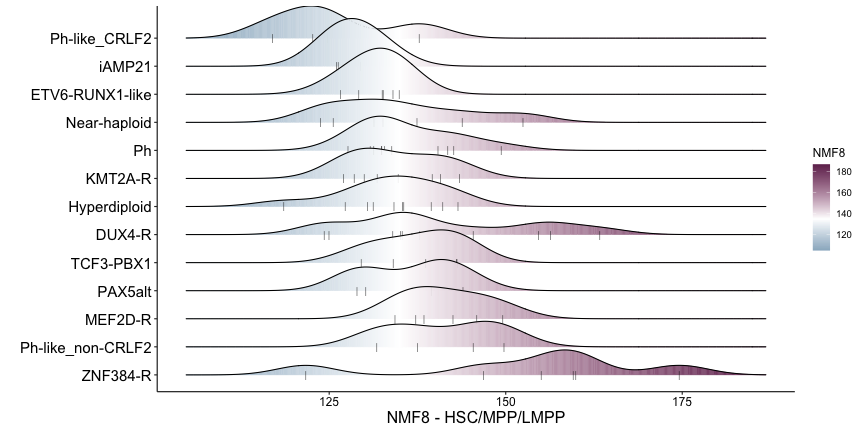

In [1069]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF8'
name = 'HSC/MPP/LMPP'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 4.33



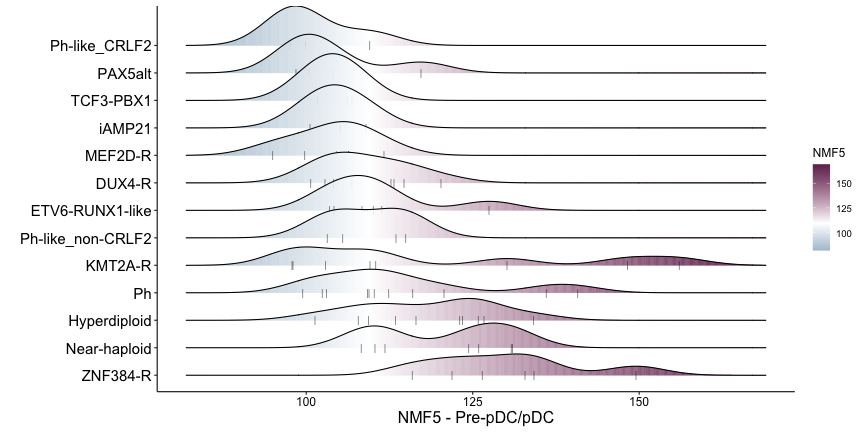

In [1070]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF5'
name = 'Pre-pDC/pDC'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 7.53



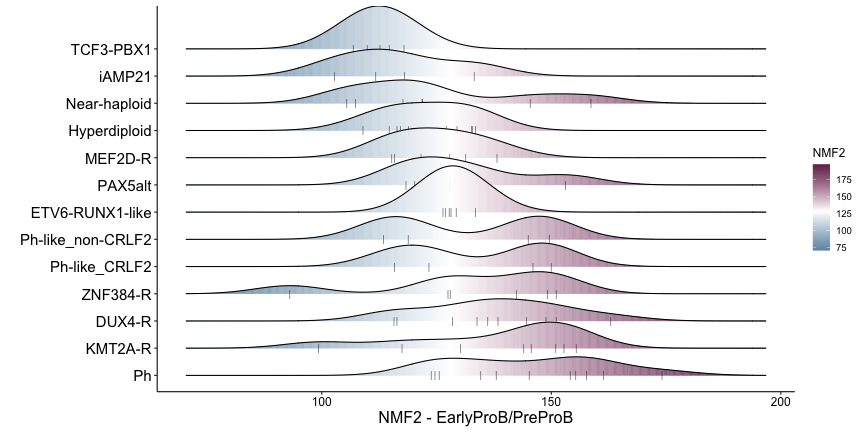

In [1071]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF2'
name = 'EarlyProB/PreProB'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 4.89



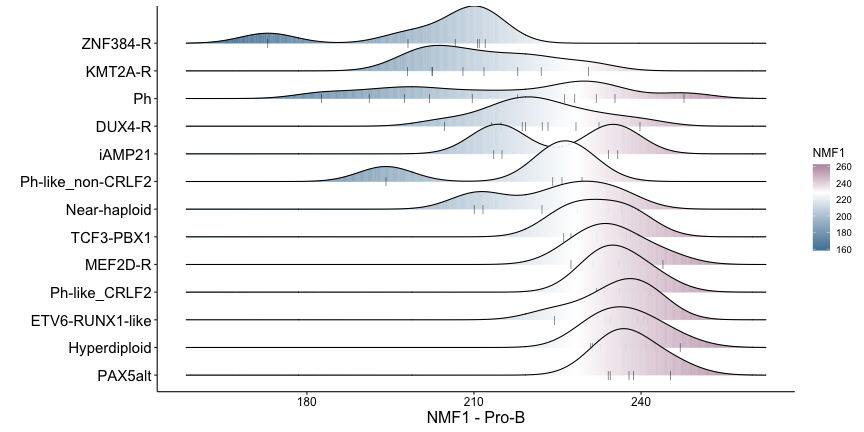

In [1072]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF1'
name = 'Pro-B'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 4.62



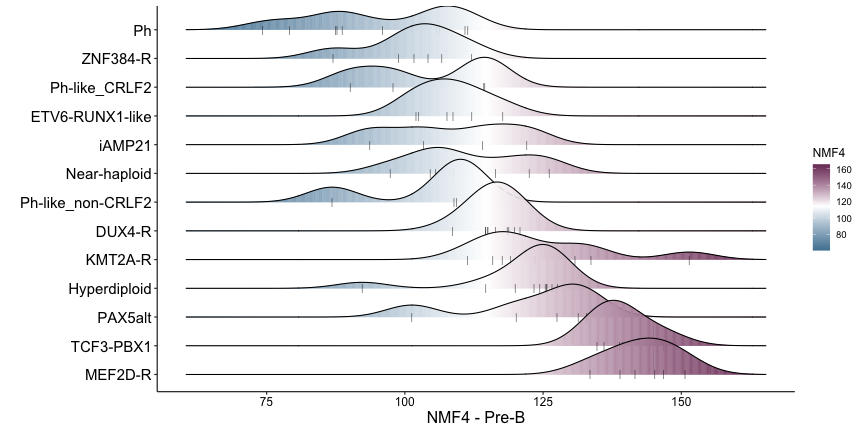

In [1073]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF4'
name = 'Pre-B'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 3.64



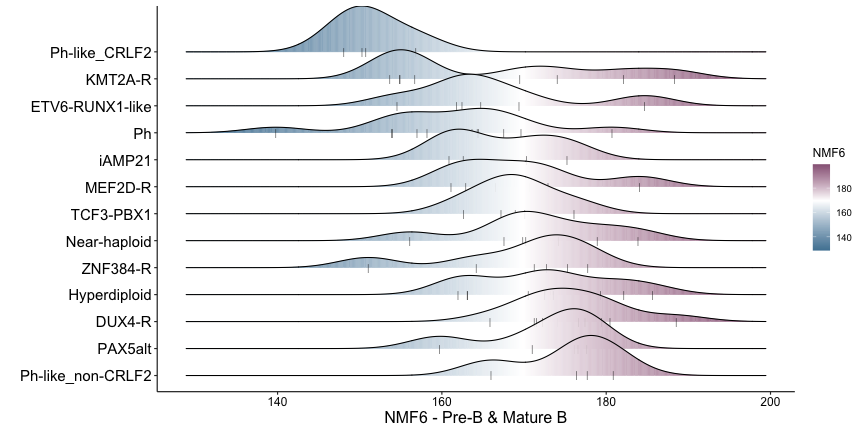

In [1074]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF6'
name = 'Pre-B & Mature B'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 2.54



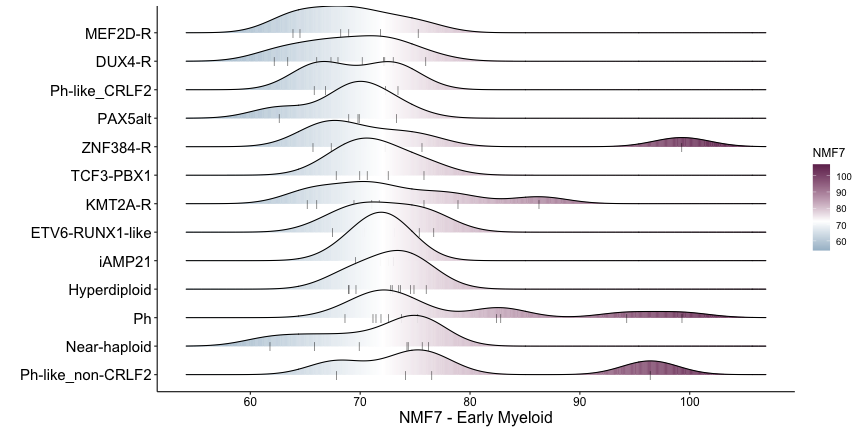

In [1075]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF7'
name = 'Early Myeloid'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 10.1



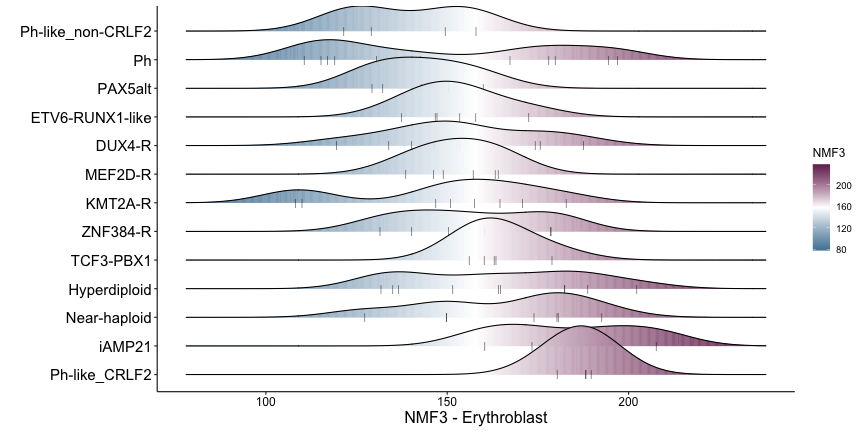

In [1076]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF3'
name = 'Erythroblast'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 3.28



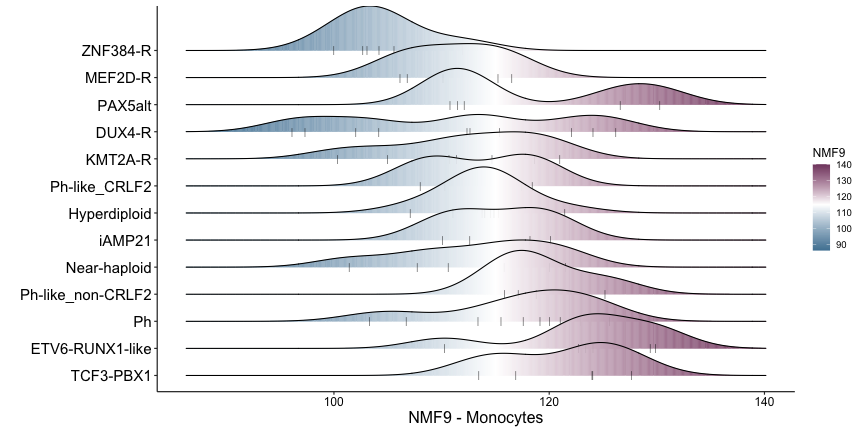

In [1077]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF9'
name = 'Monocytes'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

R[write to console]: Picking joint bandwidth of 4.97



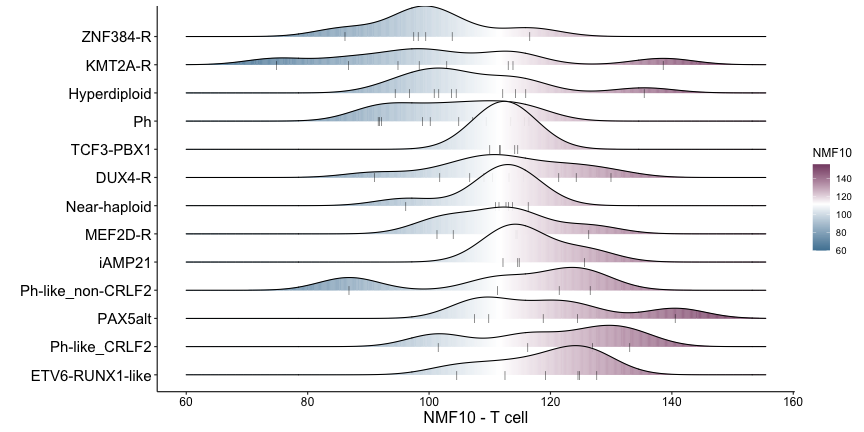

In [1078]:
%%R -i dat_NMF_obs -h 6 -w 12 --units in
library(ggridges)
library(ggpubr)

NMF = 'NMF10'
name = 'T cell'
dat_NMF_obs <- dat_NMF_obs %>% 
    mutate(NMFkey = get(NMF)) 

cutoff = median(dat_NMF_obs$NMFkey)

dat_NMF_obs %>% 
    filter(subdiagnosis %in% names(table(dat_NMF_obs$subdiagnosis)[dat_NMF_obs$subdiagnosis %>% table() >= 3])) %>% 
    ggplot(aes(y = fct_reorder(subdiagnosis, -NMFkey), x = NMFkey, fill=stat(x))) +
    geom_density_ridges_gradient(
        jittered_points = TRUE, scale = 1.7,
        position = position_points_jitter(width = 0, height = 0), 
        point_shape = '|', point_size = 3, point_alpha = 0.6) +
    scale_fill_gradient2(midpoint=cutoff, high='#71305D', low='#5083A2', name = NMF) +
    xlab(paste0(NMF, ' - ', name)) +
    theme_pubr() + 
    ylab('') +
    theme(legend.position='right', 
          axis.text.y = element_text(size=15),
          axis.title.x = element_text(size=16))# + ggsave("Mutations/figures/Combo2_Hierarchy_PC2_unimodal.png", dpi='retina', height=9.5, width=10)

### Visualize on UMAP clusters

In [131]:
dat_bdev.obs = dat_bdev.obs.join(dat_NMF.obs[['NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10']])

In [132]:
dat_bdev

AnnData object with n_obs × n_vars = 90 × 21
    obs: 'WGS.1', 'Cluster_fine', 'leiden', 'scpca_sample_id', 'scpca_project_id', 'submitter _Short', 'In BALL_sample_list', 'TB-ID', 'age', 'sex', 'diagnosis', 'subdiagnosis', 'tissue_location', 'disease_timing', 'white_blood_cell_count', 'blasts_percentage', 'risk_group', 'Karyotype', 'Fusion', 'In PanALL', 'Mutated genes', 'SV', 'Protocol', 'efstime', 'efscensor', 'ostime', 'ostime (years)', 'oscensor', 'Relapse', 'SJ_MRD_D46 (EOI)', 'EOI MRD (pos/neg)', 'WGS', 'WGS accession number', 'RNA', 'RNA-seq accession number', 'Unnamed: 33', 'Cluster_Broad', 'composition_cluster', 'MRD', 'AgeCategory', '5yr_overall_survival', '5yr_eventfree_survival', 'log2_blast_percentage', 'log2_WBC', 'NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10'
    var: 'Stdev'
    uns: 'pca', 'dendrogram_CellType', 'neighbors', 'umap', 'leiden', 'Cluster_Broad_colors', 'Cluster_fine_colors', 'subdiagnosis_colors', 'dendrogram_Cluster_Broad

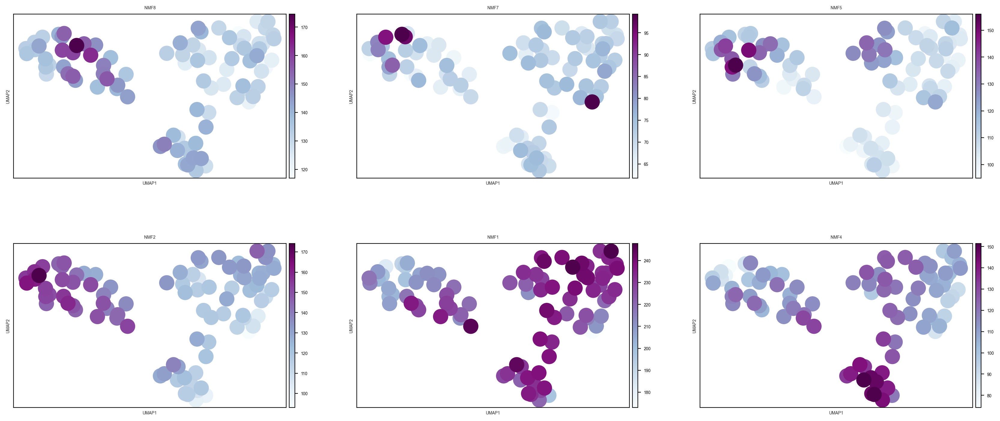

In [138]:
## NMF: HSC/MPP -> Early Myeloid -> pDC -> EarlyProB/PreProB -> 
##.     ProB -> PreB 

sc.pl.umap(dat_bdev, color = ['NMF8', 'NMF7', 'NMF5', 'NMF2', 
                              'NMF1', 'NMF4'], cmap='BuPu', ncols=3, hspace=0.4)

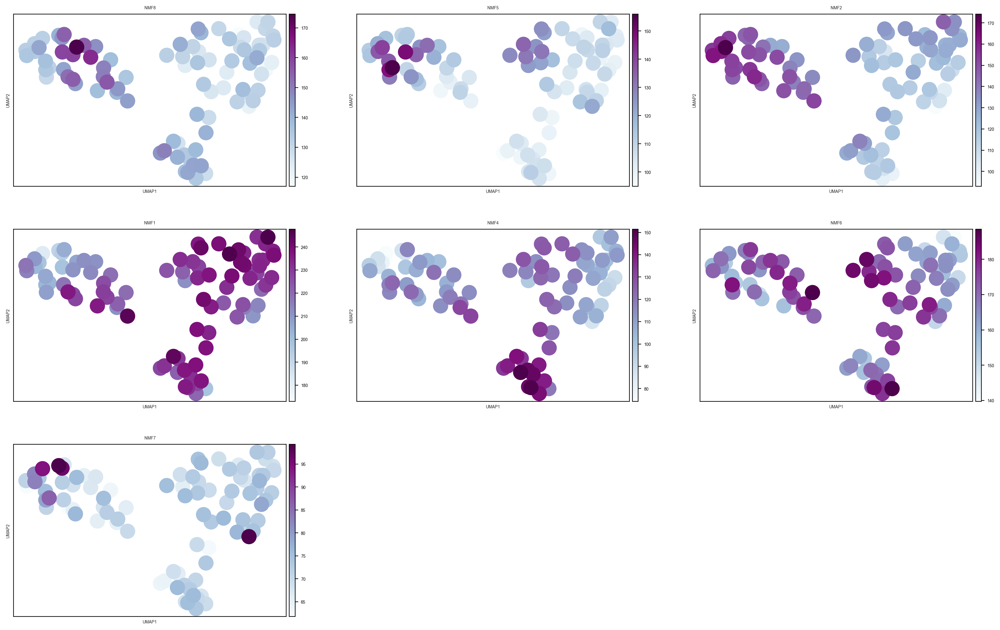

In [1102]:
## NMF: HSC/MPP -> pDC -> EarlyProB/PreProB -> 
##.     ProB -> PreB -> Mature / Small Pre B -> 
##.     Early Myeloid
sc.pl.umap(dat_bdev, color = ['NMF8', 'NMF5', 'NMF2', 
                              'NMF1', 'NMF4', 'NMF6', 
                              'NMF7'], cmap='BuPu', ncols=3)

In [1079]:
bins = 5
NMFvar = ['NMF8', 'NMF5', 'NMF2', 'NMF1', 'NMF4', 'NMF6', 'NMF7', 'NMF3', 'NMF9', 'NMF10']

for NMF in NMFvar:
    print(NMF)
    
    celltypes = dat_NMF.var[dat_NMF.var[NMF] > jenks_breaks(dat_NMF.var[NMF], bins)[bins-1]].index.values
    print(celltypes)
    print(dat_NMF.to_df()[celltypes].sum(axis=1).corr(dat_NMF.obs[NMF]))

NMF8
['HSC/MPP' 'LMPP' 'MPP-LMPP']
0.8743445740259926
NMF5
['pDC' 'Pre-pDC']
0.9401136598884416
NMF2
['EarlyProB' 'Pre-Pro-B']
0.9597741898758257
NMF1
['Pro-B Cycling 1' 'Pro-B Cycling 2' 'Pro-B VDJ']
0.8585538490944009
NMF4
['Large Pre-B 2' 'Small Pre-B']
0.9572298724038352
NMF6
['Mature B' 'Small Pre-B']
0.8349182159874382
NMF7
['Early GMP' 'Cycling Progenitor' 'EoBasoMast Precursor' 'GMP-Mono'
 'GMP-Neut']
0.8963274093257326
NMF3
['Orthochromatic Erythroblast' 'Polychromatic Erythroblast']
0.9490667481586026
NMF9
['CD14 Mono' 'CD16 Mono']
0.7635498532169012
NMF10
['CD4 Central Memory' 'CD4 Naive' 'CD8 Effector Memory 2' 'CD8 Naive'
 'CD8 Tissue Resident Memory']
0.9467390282156122


In [1105]:
dat_NMF.obs = dat_NMF.obs.join(dat_bdev.obs[['composition_cluster']])

In [1106]:
dat_NMF_obs = dat_NMF.obs[['composition_cluster', 'NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10']]
dat_NMF_obs

,composition_cluster,NMF1,NMF2,NMF3,NMF4,NMF5,NMF6,NMF7,NMF8,NMF9,NMF10
SJALL030517_R1,E,233.613074,126.963767,157.910807,102.474287,104.171061,162.459376,73.172022,126.618835,129.395025,127.639580
SJALL040053_D1,C,222.275707,144.643625,119.537852,119.860423,107.728340,180.485242,72.252650,145.406825,122.077553,110.474698
SJALL040066_D1,G,237.467608,117.943706,160.210200,138.848581,106.887211,176.092713,67.821933,143.114528,113.464512,111.615246
SJALL040069_D1,A,227.930982,145.420581,127.323062,104.629282,111.861358,156.100448,76.229701,143.869124,115.884959,110.962936
SJALL040070_D1,G,227.462206,106.895995,178.891330,136.026121,101.703835,167.194963,69.958330,129.557605,116.907728,114.114532
...,...,...,...,...,...,...,...,...,...,...,...
SJPHALL007_D,A,197.531965,174.155308,119.031000,79.162840,140.768108,154.002306,73.772236,142.659540,113.396639,98.944275
SJPHALL010_D,A,191.224759,145.231721,110.621386,87.743480,110.227809,167.552596,99.300893,140.431021,120.036017,92.160954
SJPHALL020_D,A,209.731206,157.708731,115.255110,88.688593,120.714994,169.653817,82.427072,132.407382,121.029548,104.918663
SJPHALL020_R,A,217.888707,155.339838,178.049032,95.979887,112.398346,158.194730,71.177768,132.861550,106.717341,107.204490


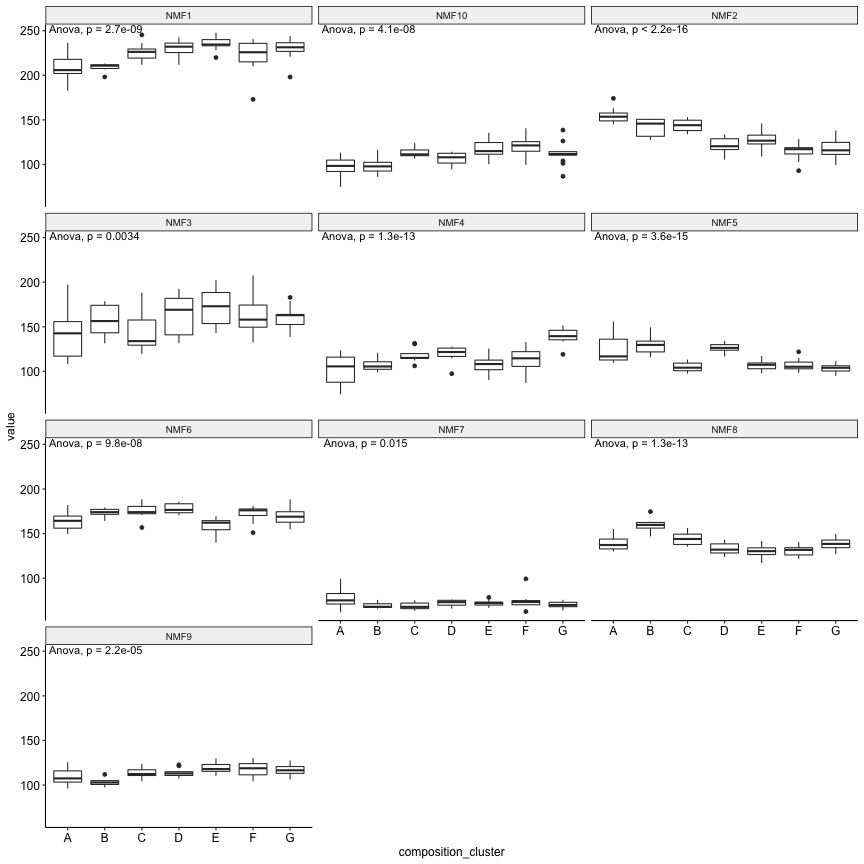

In [1108]:
%%R -i dat_NMF_obs -h 12 -w 12 --units in

dat_NMF_obs %>% 
    filter(composition_cluster %in% names(table(dat_NMF_obs$composition_cluster)[dat_NMF_obs$composition_cluster %>% table() >= 3])) %>% 
    pivot_longer(-composition_cluster) %>% 
    ggplot(aes(x = composition_cluster, y = value)) +
    facet_wrap(.~name, ncol=3) +
    geom_boxplot() + ggpubr::theme_pubr() + stat_compare_means(method = 'anova')

In [1109]:
dat_NMF_obs = dat_NMF.obs[['composition_cluster', 'subdiagnosis', 'NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10']]
dat_NMF_obs

,composition_cluster,subdiagnosis,NMF1,NMF2,NMF3,NMF4,NMF5,NMF6,NMF7,NMF8,NMF9,NMF10
SJALL030517_R1,E,ETV6-RUNX1-like,233.613074,126.963767,157.910807,102.474287,104.171061,162.459376,73.172022,126.618835,129.395025,127.639580
SJALL040053_D1,C,DUX4-R,222.275707,144.643625,119.537852,119.860423,107.728340,180.485242,72.252650,145.406825,122.077553,110.474698
SJALL040066_D1,G,TCF3-PBX1,237.467608,117.943706,160.210200,138.848581,106.887211,176.092713,67.821933,143.114528,113.464512,111.615246
SJALL040069_D1,A,Near-haploid,227.930982,145.420581,127.323062,104.629282,111.861358,156.100448,76.229701,143.869124,115.884959,110.962936
SJALL040070_D1,G,TCF3-PBX1,227.462206,106.895995,178.891330,136.026121,101.703835,167.194963,69.958330,129.557605,116.907728,114.114532
...,...,...,...,...,...,...,...,...,...,...,...,...
SJPHALL007_D,A,Ph,197.531965,174.155308,119.031000,79.162840,140.768108,154.002306,73.772236,142.659540,113.396639,98.944275
SJPHALL010_D,A,Ph,191.224759,145.231721,110.621386,87.743480,110.227809,167.552596,99.300893,140.431021,120.036017,92.160954
SJPHALL020_D,A,Ph,209.731206,157.708731,115.255110,88.688593,120.714994,169.653817,82.427072,132.407382,121.029548,104.918663
SJPHALL020_R,A,Ph,217.888707,155.339838,178.049032,95.979887,112.398346,158.194730,71.177768,132.861550,106.717341,107.204490


In [1110]:
dat_NMF_obs.to_csv('BALL_composition_lineage_NMF.csv', index_label='sample')

### Save Cluster Composition

In [1130]:
dat_bdev.obs = dat_bdev.obs.drop(columns = ['Cluster_Broad', 'Cluster_fine'])

In [1131]:
dat_bdev.write_h5ad('BALL_composition_FocusedBDev_Annotated.h5ad')

In [1144]:
sc.pp.highly_variable_genes(dat_bdev)

/Users/andyzeng/opt/anaconda3/envs/singlecell/lib/python3.7/site-packages/scanpy/preprocessing/_highly_variable_genes.py:208: RuntimeWarning: invalid value encountered in log
  dispersion = np.log(dispersion)


In [1149]:
dat_bdev.var.sort_values('dispersions', ascending=False)

,Stdev,highly_variable,means,dispersions,dispersions_norm
Small Pre-B,1.940295,False,3.867920,5.424561,0.707107
Pro-B VDJ,0.945333,False,5.839291,5.168476,1.000000
Pre-pDC,1.557827,True,1.593002,4.928110,0.707107
Large Pre-B 2,1.582349,False,3.377114,4.699705,0.707107
Pro-B Cycling 2,1.001473,False,3.992143,4.217162,-0.707107
MLP,1.381094,True,0.879413,4.147861,1.021022
EarlyProB,1.669452,True,2.032596,4.146555,0.908461
Large Pre-B 1,1.187474,False,3.544227,4.123378,0.707107
Pre-Pro-B Cycling,1.127557,True,0.027780,3.908562,0.707107
MPP-LMPP,1.153912,False,0.278570,3.604582,-0.707107


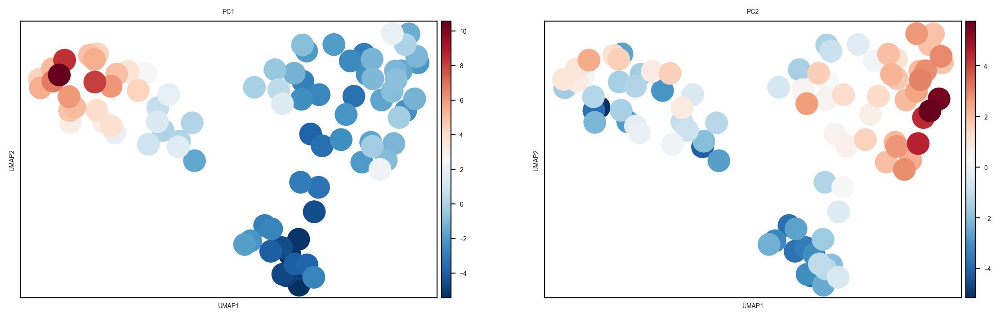

In [1174]:
## NMF: HSC/MPP -> pDC -> EarlyProB/PreProB -> 
##.     ProB -> PreB -> Mature / Small Pre B -> 
##.     Early Myeloid
sc.pl.umap(dat_bdev, color = ['PC1', 'PC2'], cmap='RdBu_r', ncols=3)

In [1186]:
focused_BDev_Lineages_subset = ['HSC/MPP', 'MPP-LMPP', 'LMPP', 'Early GMP', 'MLP', 
                                'Pre-pDC', 'pDC', 'EarlyProB', 'Pre-Pro-B', 
                                'Pro-B VDJ', 'Pro-B Cycling 1', 'Pro-B Cycling 2',
                                'Large Pre-B 1', 'Large Pre-B 2', 'Small Pre-B', 'Mature B']

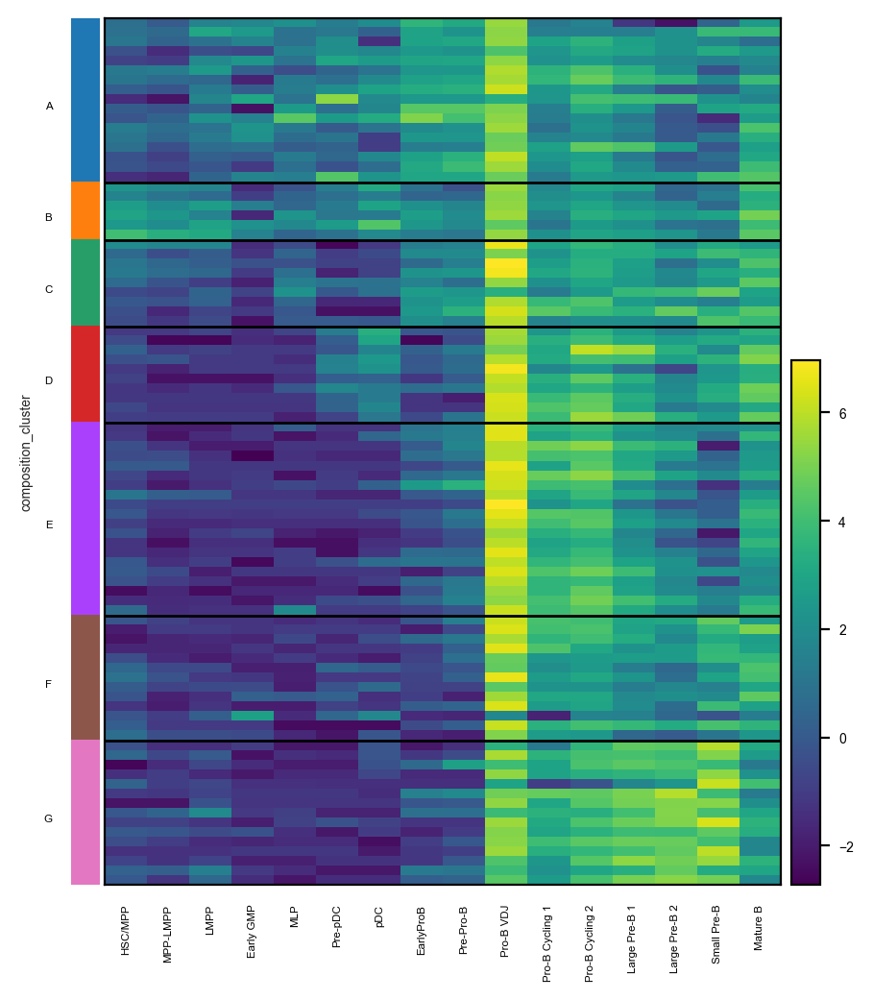

In [1190]:
sc.pl.heatmap(dat_bdev, var_names = focused_BDev_Lineages_subset, groupby='composition_cluster', cmap='viridis')

<AxesSubplot:>

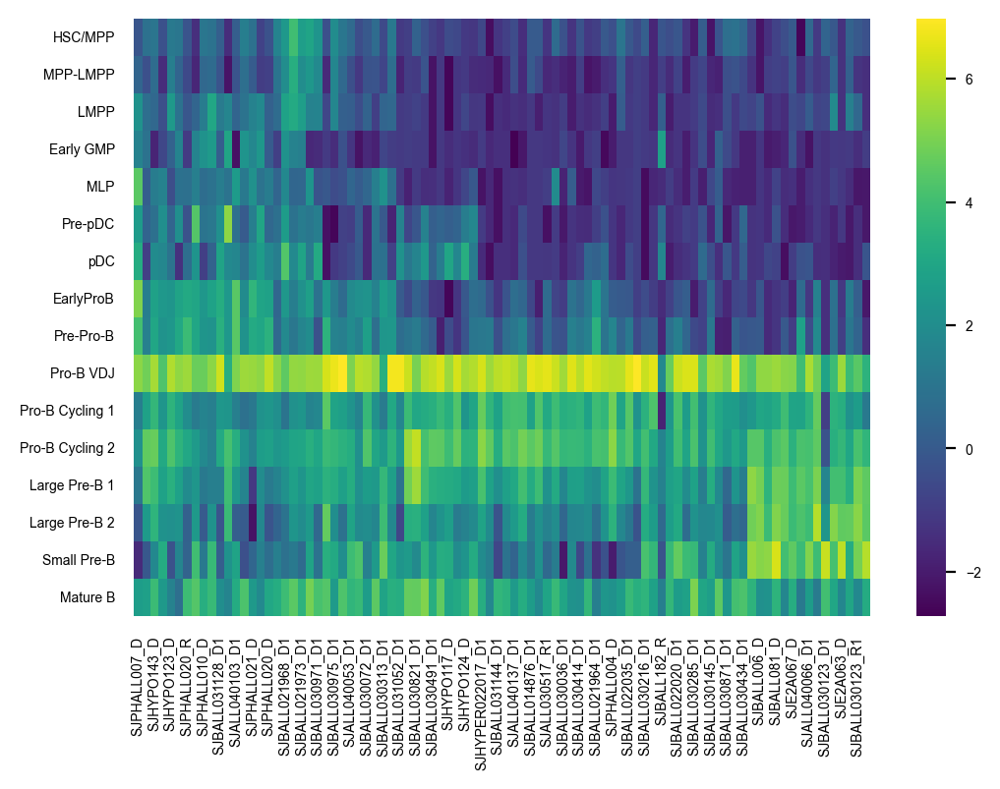

In [1189]:
sns.heatmap(dat_bdev[dat_bdev.obs.sort_values('PC1', ascending=False).sort_values('composition_cluster').index, focused_BDev_Lineages_subset].to_df().T, cmap='viridis')

In [1198]:
dat_NMF

AnnData object with n_obs × n_vars = 90 × 55
    obs: 'TB-ID', 'age', 'sex', 'diagnosis', 'subdiagnosis', 'tissue_location', 'disease_timing', 'white_blood_cell_count', 'blasts_percentage', 'risk_group', 'Karyotype', 'Fusion', 'Mutated genes', 'SV', 'Protocol', 'efstime', 'efscensor', 'ostime', 'oscensor', 'RNA-seq accession number', 'WGS', 'WGS accession number', 'WGS.1', 'RNA', 'Cluster_Broad', 'Cluster_fine', 'leiden', 'NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10', 'composition_cluster'
    var: 'NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10'
    uns: 'pca', 'dendrogram_CellType', 'neighbors', 'umap', 'leiden', 'Cluster_Broad_colors', 'Cluster_fine_colors', 'subdiagnosis_colors', 'dendrogram_Cluster_Broad', 'dendrogram_subdiagnosis'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [1214]:
dat_NMF.obs[['NMF1', 'NMF2', 'NMF3', 'NMF4', 'NMF5', 'NMF6', 'NMF7', 'NMF8', 'NMF9', 'NMF10', 'blasts_percentage']].corr()['blasts_percentage'].head(-1).sort_values()

NMF7    -0.266154
NMF2    -0.060932
NMF3    -0.060673
NMF5     0.013349
NMF9     0.090844
NMF8     0.098316
NMF10    0.128468
NMF6     0.230345
NMF4     0.323348
NMF1     0.463474
Name: blasts_percentage, dtype: float64

Blast percentage is modestly anticorrelated with NMF7 (Myeloid??, r = -0.27)

Modestly correlated with NMF1 (ProB, r = 0.46) and NMF4 (PreB, r = 0.32)

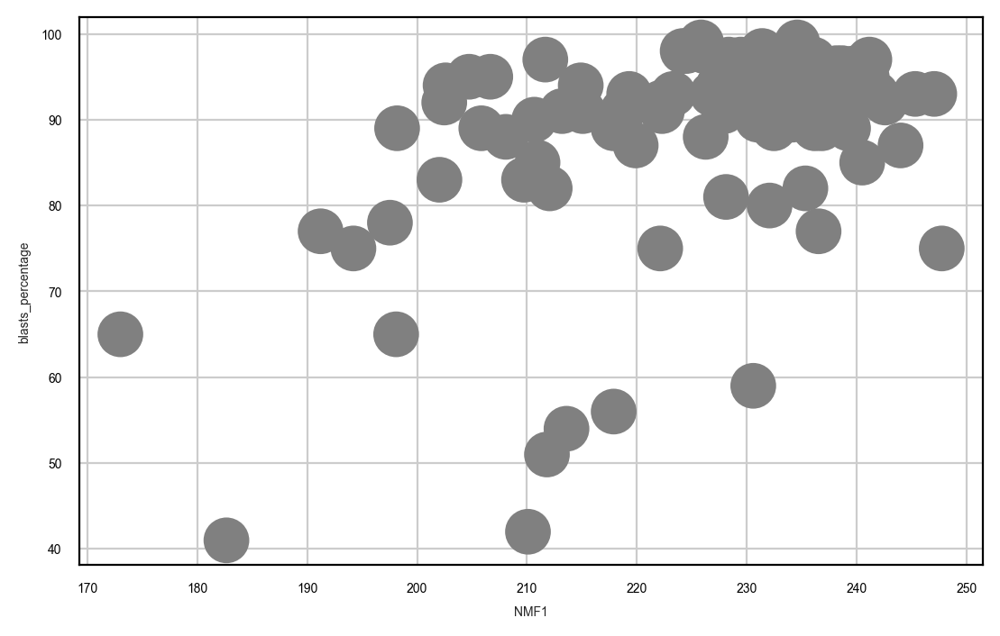

In [1206]:
sc.pl.scatter(dat_NMF, 'NMF1', 'blasts_percentage')

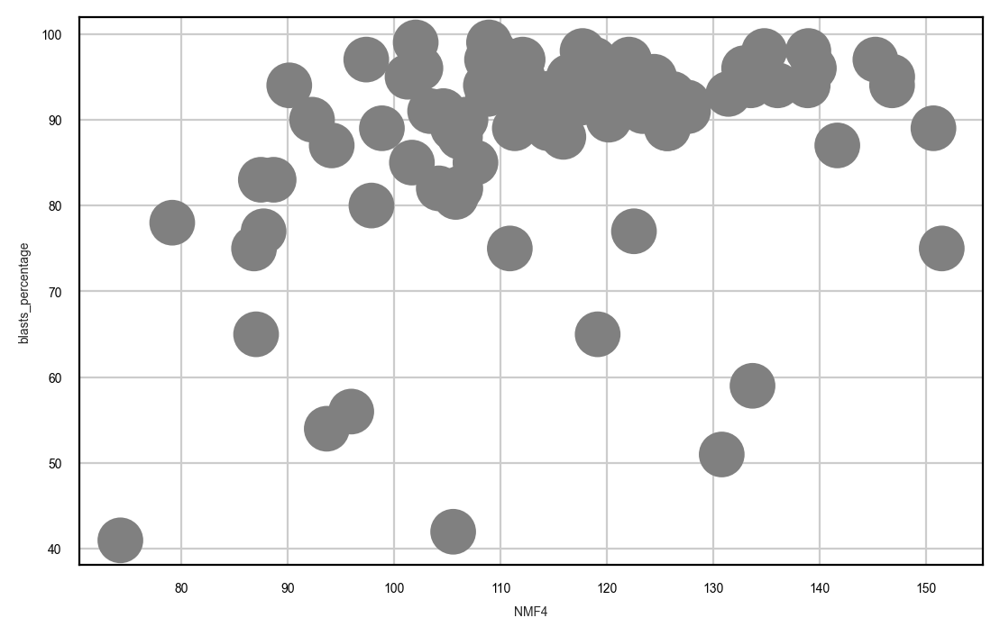

In [1215]:
sc.pl.scatter(dat_NMF, 'NMF4', 'blasts_percentage')

In [ ]:
dat_bdev.obs.to_csv('BDev_Focused_composition_metadata.csv', index_label = 'sample')
dat_bdev.to_df().to_csv('BDev_Focused_composition_abundance.csv', index_label = 'sample')

## Immune Clustering

In [15]:
datfull = sc.read_csv('../BALL_89pt_Filtered_CompositionMatrix_mapQConly.csv').T
datimmune = datfull[:,datfull.var_names.str.contains(' Mono|CD4|CD8|NK')]
datimmune.X = composition.multiplicative_replacement(datimmune.X)
datimmune.X = composition.clr(datimmune.X)
datimmune

NameError: name 'composition' is not defined

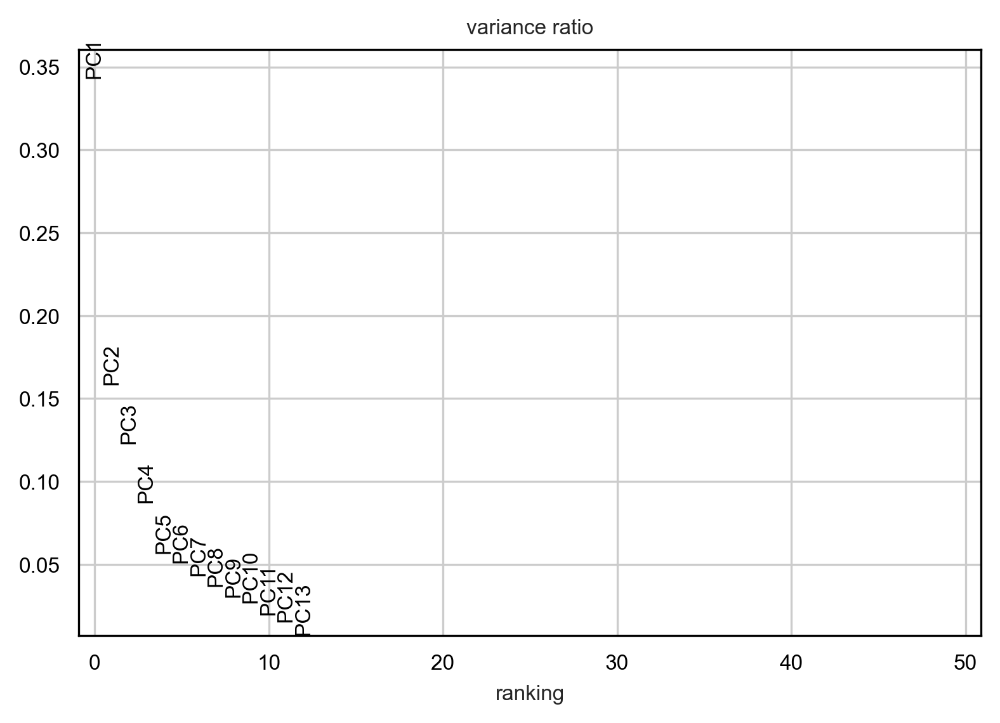

In [62]:
sc.pp.pca(datimmune)
sc.pl.pca_variance_ratio(datimmune, n_pcs=50) #n_pcs=10, 


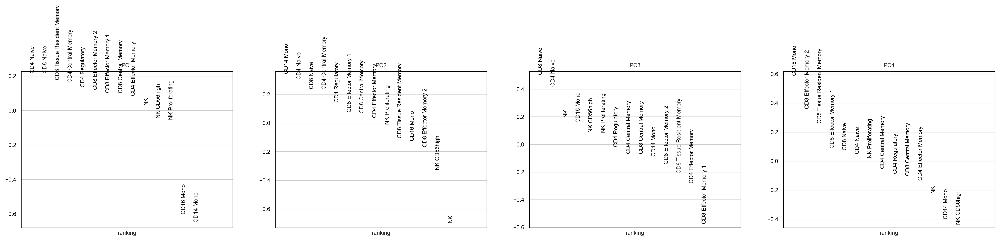

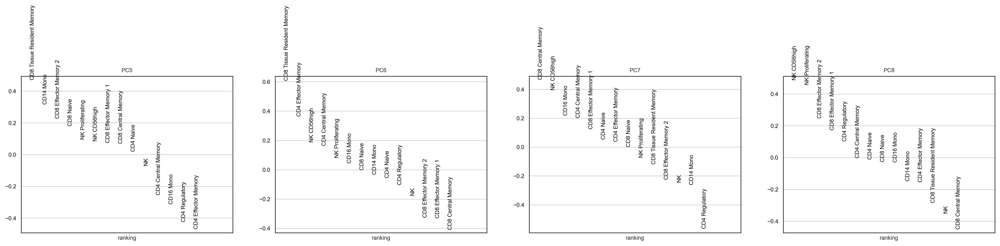

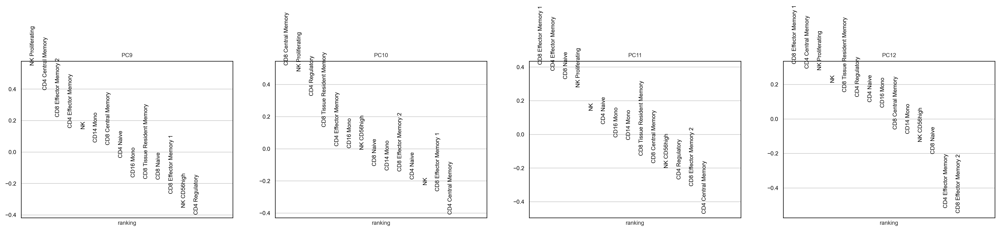

In [63]:
sc.pl.pca_loadings(datimmune, components=[1,2,3,4]) 
sc.pl.pca_loadings(datimmune, components=[5,6,7,8]) 
sc.pl.pca_loadings(datimmune, components=[9,10,11,12]) 



In [64]:
datimmune.obs = datimmune.obs.join(dat.obs)

In [67]:
sc.pp.neighbors(datimmune, n_neighbors=10, n_pcs=6, use_rep = 'X_pca', metric = 'cosine') #n_pcs=10, 
sc.tl.umap(datimmune, min_dist=0.2)
sc.tl.leiden(datimmune, resolution=0.5)

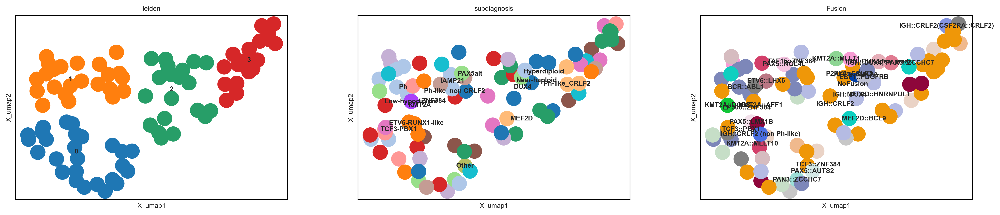

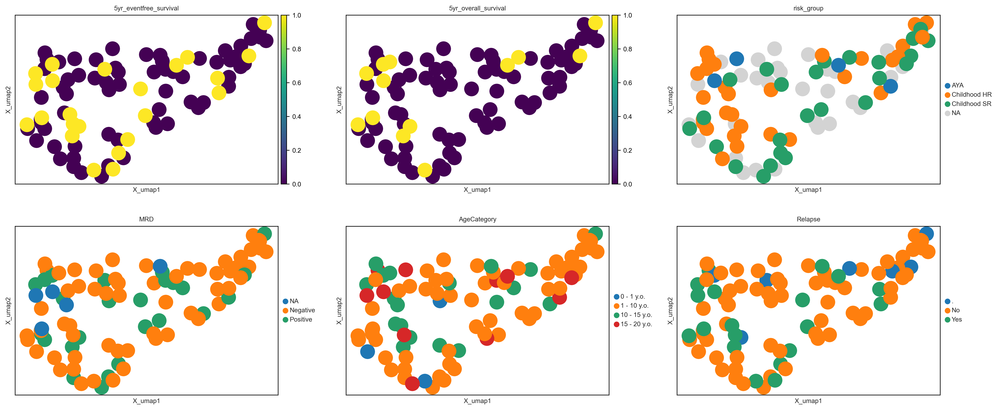

In [68]:
sc.settings.set_figure_params(dpi=150, fontsize=8, dpi_save=200, figsize=(6,4), format='png')

sc.pl.embedding(datimmune, basis = 'X_umap', color=['leiden', 'subdiagnosis', 'Fusion'], legend_loc = 'on data', legend_fontsize=8, ncols=3, cmap='viridis')
sc.pl.embedding(datimmune, basis = 'X_umap', color=['5yr_eventfree_survival', '5yr_overall_survival', 'risk_group', 
                                                         'MRD', 'AgeCategory', 'Relapse'], legend_fontsize=8, ncols=3, cmap='viridis')

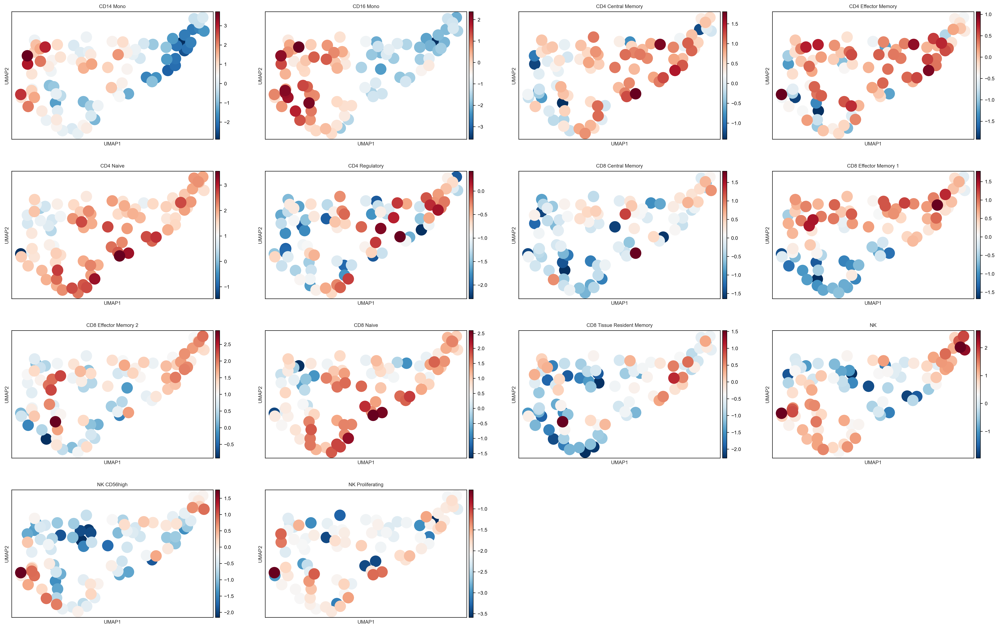

In [70]:
sc.pl.umap(datimmune, color = datimmune.var_names, cmap = 'RdBu_r')